MIT License

Copyright (c) 2024 Yash Badani

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.

**Abstract:**
Dataset contains 20,000 songs and has 15 features like duration ms, key, audio mode, acousticness, danceability, energy and so on .

duration_ms: The duration of the track in milliseconds.

Duration_ms: This feature represents the length of a song in milliseconds.

Key: This is an estimation of the track's overall key, expressed as integers in standard Pitch Class notation (e.g., 0 for C, 1 for C♯/D♭, 2 for D, etc.). A value of -1 indicates that no key was detected.

Audio_mode: This indicates the modality of a track, with major mode denoted by 1 and minor mode by 0. It reflects the type of scale the track’s melodic content is based on.

Time_signature: This refers to the estimated overall time signature of a track, providing information on the number of beats in each bar.

Acousticness: This metric, ranging from 0.0 to 1.0, gauges the likelihood of a track being acoustic, with 1.0 signifying high confidence in its acoustic nature.

Danceability: This quantifies how suitable a track is for dancing, based on aspects like tempo, rhythm stability, beat strength, etc. Scores range from 0.0 (least danceable) to 1.0 (most danceable).

Energy: Representing a track's intensity and activity level on a scale from 0.0 to 1.0, higher values indicate more energetic tracks that typically feel fast, loud, and noisy.

Instrumentalness: This measures the likelihood of a track being instrumental. Higher scores suggest a greater probability of the track lacking vocal content.

Loudness: Measured in decibels (dB), this feature reflects the average loudness of a track, a key factor in comparing the relative loudness of different songs.

Speechiness: This assesses the extent of spoken words in a track. Values near 1.0 suggest a track consists mainly of spoken words, while lower values indicate musical or non-speech elements.

Audio_valence: Ranging from 0.0 to 1.0, this measures the musical positiveness conveyed by a track, with higher values indicating more positive, cheerful sounds and lower values suggesting negative emotions.

Tempo: Expressed in beats per minute (BPM), this denotes the track's estimated overall tempo, which is a direct derivative of the average beat duration.

Song_popularity: This feature rates songs based on Spotify audience preferences.

Liveness: This indicates the presence of a live audience in the recording. Higher values suggest a higher probability that the track was performed live.

Song_genre: This feature classifies each track into a specific musical genre, reflecting its stylistic and cultural elements. It helps in understanding the song's overall style and audience appeal, ranging from broad categories like rock or jazz to niche subgenres.

These features collectively provide a multifaceted view of each song in the dataset, offering insights into their musical characteristics and audience reception.

**Abstract:**


The aim of this assignment was to use AutoML Library H2O.ai on a regression based dataset to precisely predict the popularity of songs. For this dataset popularity is the dependent variable and others are independent variables. First, major factors affecting the selling price should be selected. Then, a model for popularity prediction should be established from linear regression. That should be applied to the Spotify dataset to test the model. Through the data analysis and test it can be summarized that the linear regression model can effectively predict and analyze the popularity of song  to some extent, while the algorithm can still be improved through more advanced machine learning methods.

# **1.Data Cleaning and Feature Selection**

In [ ]:
pip install category_encoders

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 700.8 kB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pylab as plt
from matplotlib import pyplot
from sklearn.preprocessing import LabelEncoder
from category_encoders import BinaryEncoder

In [ ]:
df=pd.read_csv("https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/song_data1.csv")
df2=pd.read_csv("https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/song_info2.csv")

In [ ]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
import category_encoders as ce


# Example: df2 = pd.read_csv('your_dataset.csv')

# Label Encoding for 'song_genre'
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df2['song_genre_encoded'] = le.fit_transform(df2['song_genre'])

# Frequency Encoding for 'artist_name', 'album_name', and 'song_name'
for column in ['artist_name', 'album_name', 'song_name']:
    freq = df2[column].value_counts(normalize=True)  # Get frequency of each category
    df2[column + '_freq'] = df2[column].map(freq)

# Note: The original columns ('song_name', 'artist_name', 'album_name', 'song_genre') remain in df2 for any further use.


In [ ]:
print(df2.head())

              artist_name                                         album_name  \
0             Gen Hoshino                                             Comedy   
1            Ben Woodward                                   Ghost (Acoustic)   
2  Ingrid Michaelson;ZAYN                                     To Begin Again   
3            Kina Grannis  Crazy Rich Asians (Original Motion Picture Sou...   
4        Chord Overstreet                                            Hold On   

                    song_name song_genre  song_genre_encoded  \
0                      Comedy   acoustic                   0   
1            Ghost - Acoustic   acoustic                   0   
2              To Begin Again   acoustic                   0   
3  Can't Help Falling In Love   acoustic                   0   
4                     Hold On   acoustic                   0   

   artist_name_freq  album_name_freq  song_name_freq  
0           0.00010          0.00010         0.00010  
1           0.00005     

In [ ]:
frames=[df,df2]
spotify_dataset = pd.concat([df, df2], axis=1)

### **Question 1:- What are the data types? (Only numeric and categorical)**



These are the datatypes of the dataset

Numerical - song_popularity ,song_duration_ms ,song_danceability, ,energy ,key,loudness, mode, speechiness ,acousticness ,instrumentalness,liveness,valence, tempo, time_signature .

Categorical - song_name ,artist_name, album_name ,song_genre.

In [ ]:
df.head()

,song_name,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,Comedy,73,230666,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4
1,Ghost - Acoustic,55,149610,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4
2,To Begin Again,57,210826,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4
3,Can't Help Falling In Love,71,201933,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3
4,Hold On,82,198853,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4


In [ ]:
df2.head()

,artist_name,album_name,song_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
0,Gen Hoshino,Comedy,Comedy,acoustic,0,0.00010,0.00010,0.00010
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,acoustic,0,0.00005,0.00005,0.00005
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,acoustic,0,0.00005,0.00005,0.00005
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,acoustic,0,0.00005,0.00005,0.00020
4,Chord Overstreet,Hold On,Hold On,acoustic,0,0.00005,0.00005,0.00020


In [ ]:
spotify_dataset

,song_name,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,...,tempo,time_signature,artist_name,album_name,song_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
0,Comedy,73,230666,0.676,0.4610,1,-6.746,0,0.1430,0.03220,...,87.917,4,Gen Hoshino,Comedy,Comedy,acoustic,0,0.00010,0.00010,0.00010
1,Ghost - Acoustic,55,149610,0.420,0.1660,1,-17.235,1,0.0763,0.92400,...,77.489,4,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,acoustic,0,0.00005,0.00005,0.00005
2,To Begin Again,57,210826,0.438,0.3590,0,-9.734,1,0.0557,0.21000,...,76.332,4,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,acoustic,0,0.00005,0.00005,0.00005
3,Can't Help Falling In Love,71,201933,0.266,0.0596,0,-18.515,1,0.0363,0.90500,...,181.740,3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,acoustic,0,0.00005,0.00005,0.00020
4,Hold On,82,198853,0.618,0.4430,2,-9.681,1,0.0526,0.46900,...,119.949,4,Chord Overstreet,Hold On,Hold On,acoustic,0,0.00005,0.00005,0.00020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19994,(Now and Then There's) A Fool Such as I,52,159360,0.574,0.7140,0,-6.344,1,0.0403,0.90100,...,63.623,4,Elvis Presley,Elvis 30 #1 Hits (Expanded Edition),(Now and Then There's) A Fool Such as I,rockabilly,81,0.00835,0.00085,0.00005
19995,"Corrina, Corrina",47,162160,0.481,0.4130,9,-8.688,1,0.0326,0.79800,...,127.591,4,Ray Peterson,Missing You,"Corrina, Corrina",rockabilly,81,0.00015,0.00010,0.00005
19996,Oh! Carol,46,135773,0.584,0.7430,8,-7.039,0,0.0463,0.76600,...,132.747,4,Neil Sedaka,Collections,Oh! Carol,rockabilly,81,0.00035,0.00005,0.00015
19997,ÊôÇË®à‰ªïÊéõ„Åë„ÅÆÊó•„ÄÖ - Remastered 2022,22,227093,0.637,0.9540,9,-7.604,0,0.0448,0.34400,...,128.124,4,Eikichi Yazawa,ÊÉÖ‰∫ã (50th Anniversary Remastered),ÊôÇË®à‰ªïÊéõ„Åë„ÅÆÊó•„ÄÖ - Remastered 2022,rockabilly,81,0.00335,0.00015,0.00005


### **Question 2.Are there missing values?**

No data is missing from any of the columns, which means it is not required to impute or remove the null values from the data

In [ ]:
spotify_dataset.isnull().sum()

song_name             0
song_popularity       0
song_duration_ms      0
song_danceability     0
energy                0
key                   0
loudness              0
mode                  0
speechiness           0
acousticness          0
instrumentalness      0
liveness              0
valence               0
tempo                 0
time_signature        0
artist_name           0
album_name            0
song_name             0
song_genre            0
song_genre_encoded    0
artist_name_freq      0
album_name_freq       0
song_name_freq        0
dtype: int64

### **Question 3:- What are the likely distributions of the numeric variables?**

QQ plots are essential for evaluating the distribution of numeric variables, particularly useful for:

**Assessing Normality:** They visually compare data against a theoretical normal distribution, highlighting deviations.

**Identifying Distribution Characteristics:** Skewness and kurtosis affecting statistical tests can be observed.

**Evaluating Theoretical Distributions:** Beyond normality, QQ plots compare data with any theoretical distribution.

**Detecting Outliers:** Outliers, significant for statistical analysis, are easily identifiable.

**Guiding Data Transformations:** They help determine necessary transformations to normalize data.

In essence, QQ plots are a versatile and intuitive tool for preliminary data analysis, supporting assumptions checking, outlier detection, and preparation for further statistical testing.

<Figure size 800x500 with 0 Axes>

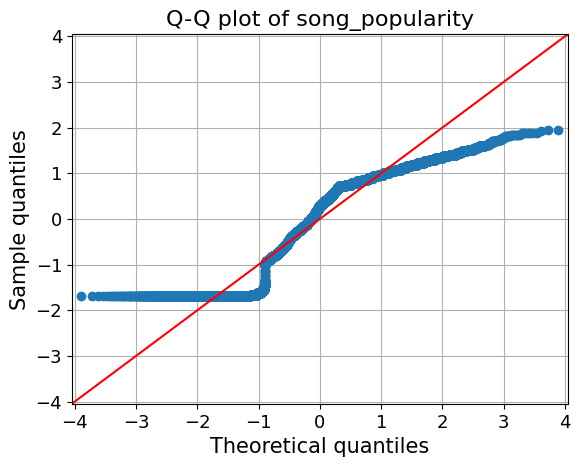

<Figure size 800x500 with 0 Axes>

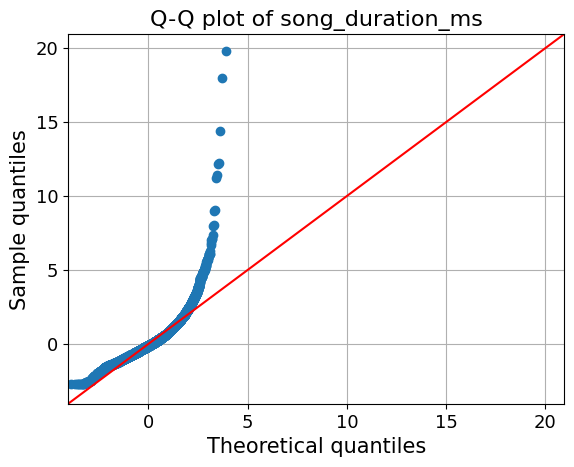

<Figure size 800x500 with 0 Axes>

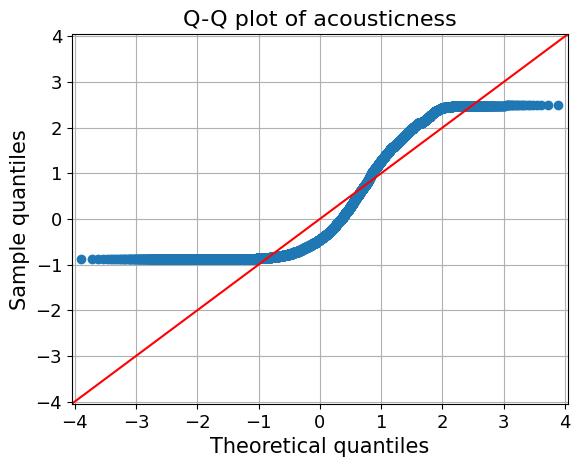

<Figure size 800x500 with 0 Axes>

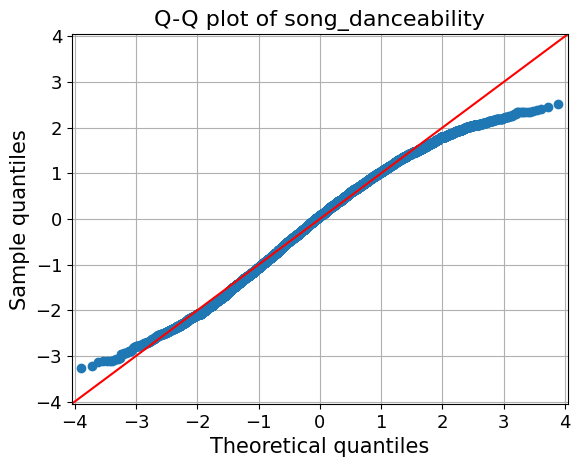

<Figure size 800x500 with 0 Axes>

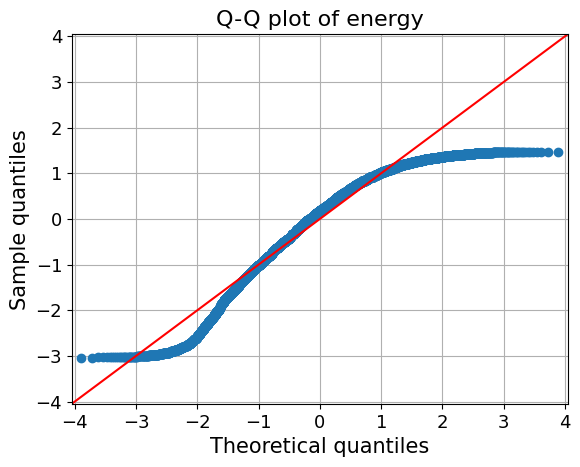

<Figure size 800x500 with 0 Axes>

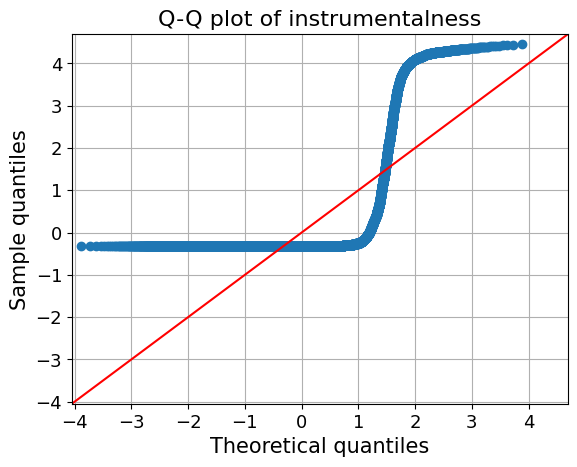

<Figure size 800x500 with 0 Axes>

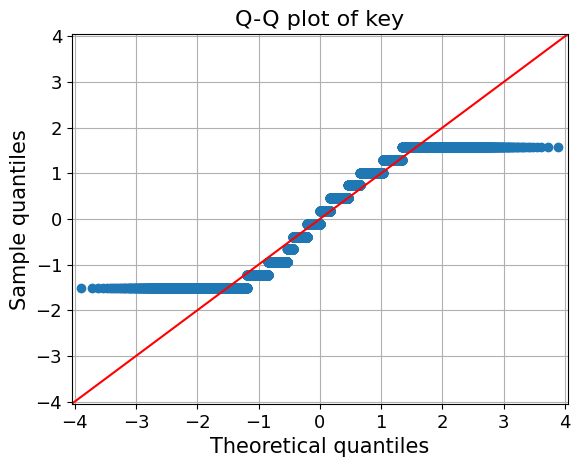

<Figure size 800x500 with 0 Axes>

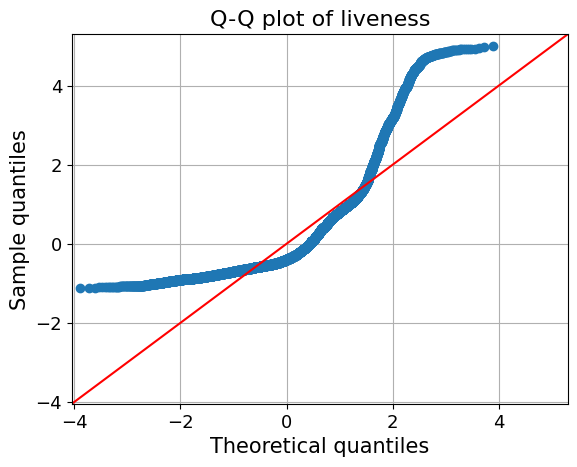

<Figure size 800x500 with 0 Axes>

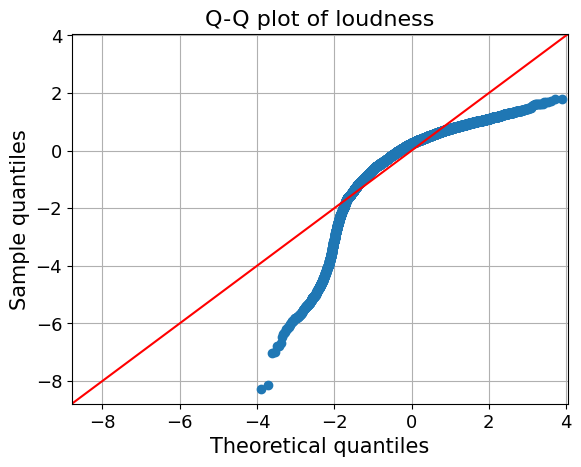

<Figure size 800x500 with 0 Axes>

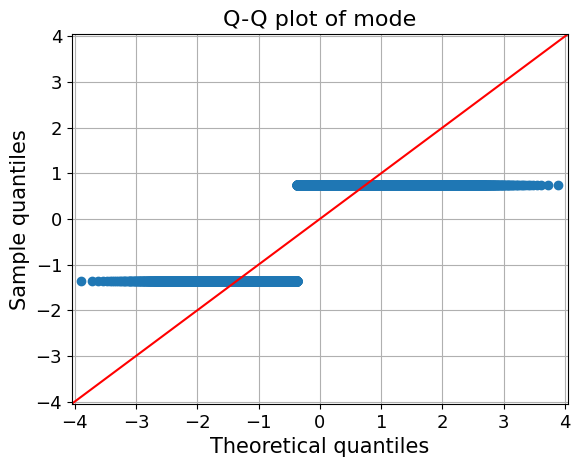

<Figure size 800x500 with 0 Axes>

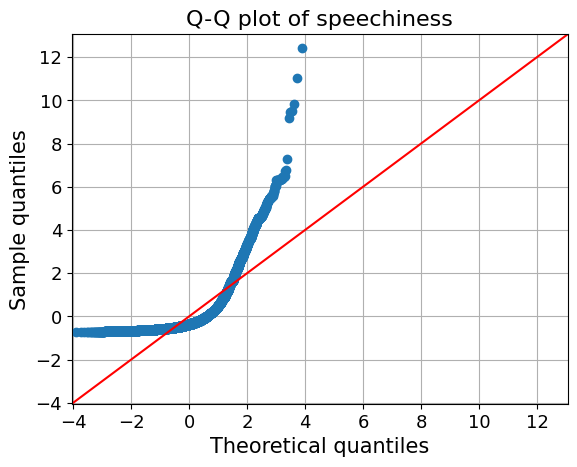

<Figure size 800x500 with 0 Axes>

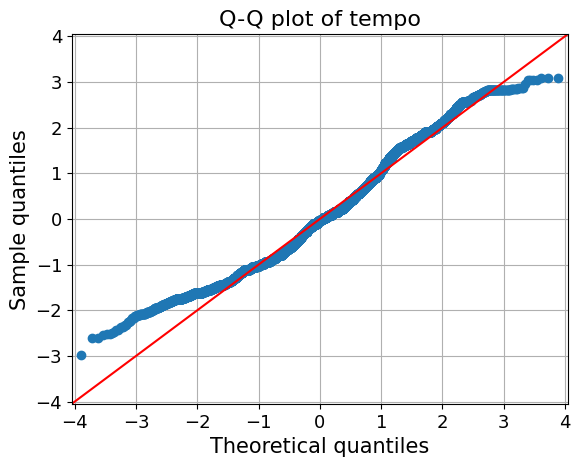

<Figure size 800x500 with 0 Axes>

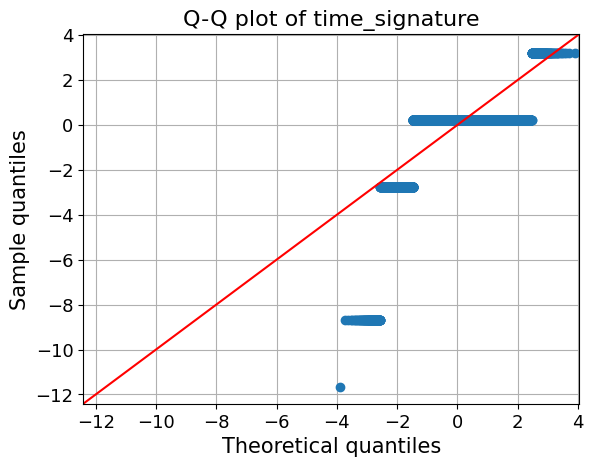

<Figure size 800x500 with 0 Axes>

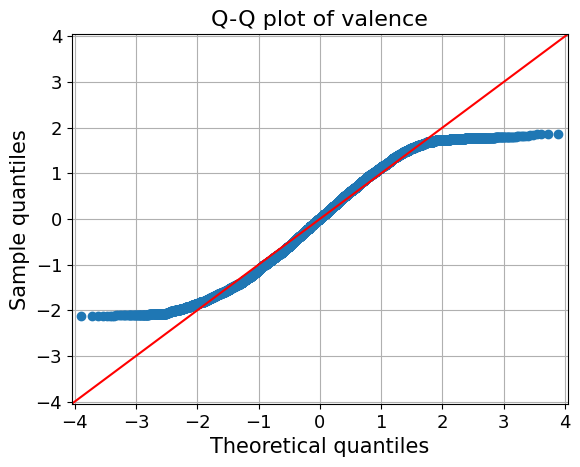

In [ ]:
from statsmodels.graphics.gofplots import qqplot
data_norm=spotify_dataset[['song_popularity', 'song_duration_ms', 'acousticness', 'song_danceability',
       'energy','instrumentalness','key','liveness','loudness','mode','speechiness','tempo','time_signature','valence']]
for c in data_norm.columns[:]:
  plt.figure(figsize=(8,5))
  fig=qqplot(data_norm[c],line='45',fit='True')
  plt.xticks(fontsize=13)
  plt.yticks(fontsize=13)
  plt.xlabel("Theoretical quantiles",fontsize=15)
  plt.ylabel("Sample quantiles",fontsize=15)
  plt.title("Q-Q plot of {}".format(c),fontsize=16)
  plt.grid(True)
  plt.show()

In each plot, the red line represents the expected quantiles if the variable followed a normal distribution.

The blue dots represent the actual quantiles from the dataset.

**Linearity:** If the points roughly form a straight line, the variable's distribution is close to normal.

**Curvature:** A systematic deviation from the straight line, such as a curve, suggests non-normality, potentially skewness or heavy tails.

**Outliers**: Points that fall far from the line are potential outliers.


**Looking at QQ plot we can say only the variable song_popularity,Danceability,energy,tempo and valence roughly follows normal distribution**

### **Question 4 : Which independent variables are useful to predict a target (dependent variable)?**

1.Correlation Analysis

<ipython-input-13-b2f5640b47e8>:5: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


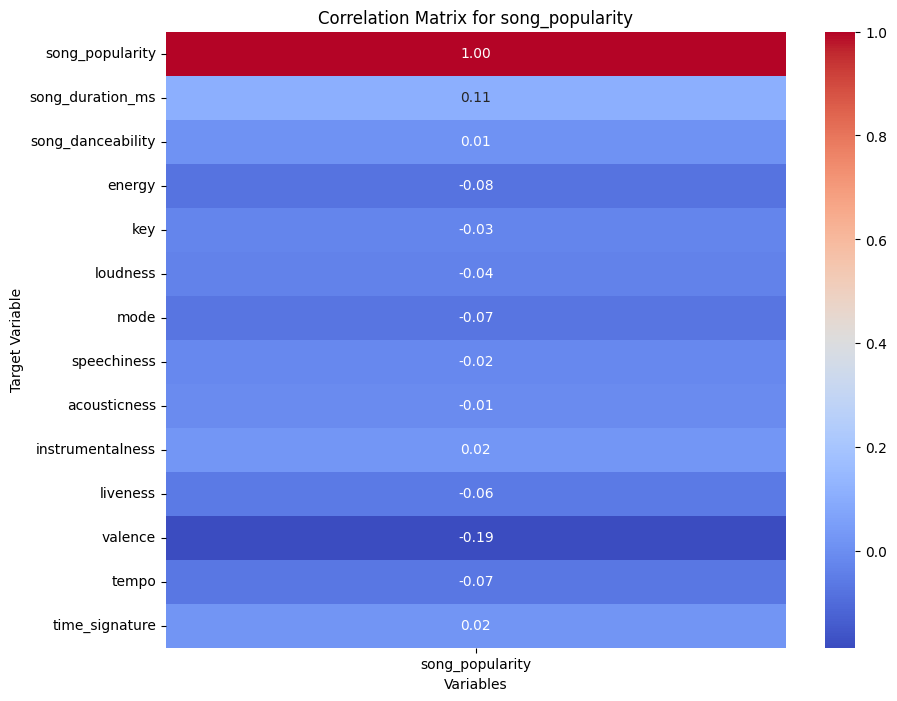

In [ ]:
# Method 1: Correlation Analysis
target_variable = "song_popularity"

# Calculate correlation matrix
correlation_matrix = df.corr()

# Filter correlation matrix for the target variable
target_correlation = correlation_matrix[target_variable]

# Plot correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(target_correlation.to_frame(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f"Correlation Matrix for {target_variable}")
plt.xlabel("Variables")
plt.ylabel("Target Variable")
plt.show()


Based on the correlation matrix, here are some key inferences:

**Song Popularity** is the target variable with a self-correlation of 1, which is always the case.

**Song Duration (ms)** has a low positive correlation (0.11) with song popularity, indicating a slight relationship where longer songs might be slightly more popular.

**Valence** has the most substantial negative correlation (-0.19) with song popularity among the listed variables, suggesting that less happy or less positively valenced songs have a tendency to be more popular, though the correlation is still relatively weak.

**Energy** has a small negative correlation (-0.08), implying that songs with lower energy may be slightly more popular, but again, this is not a strong relationship.

All other variables show very weak correlations with song popularity, close to zero, suggesting little to no linear relationship with song popularity based on the data provided.

<ipython-input-14-b380ef952974>:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(), annot=True, cmap="RdYlGn", fmt=".1f")


<Axes: >

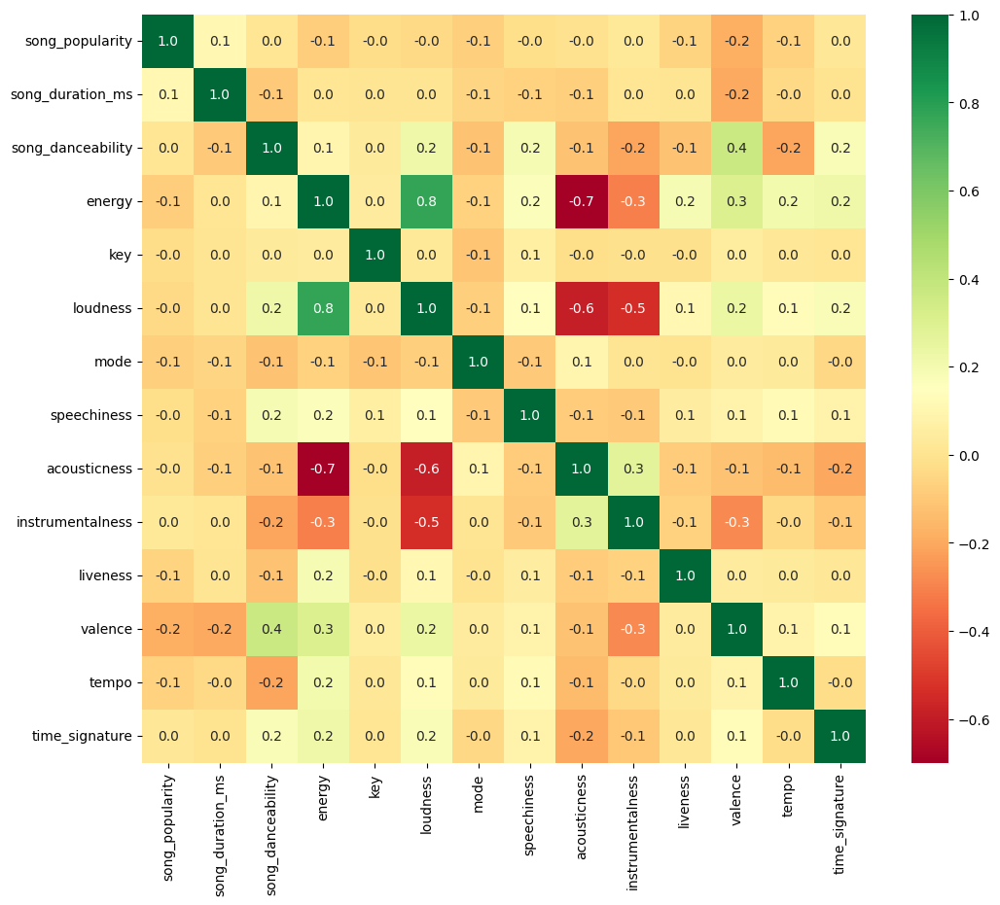

In [ ]:
# heatmap of the same correlation matrix.
plt.figure(figsize=(12,10))
sns.heatmap(df.corr(), annot=True, cmap="RdYlGn", fmt=".1f")

**There's a strong positive correlation between energy and loudness (0.8), suggesting that songs with higher energy tend to be louder.**

Random Forest Classifier Feature Importance

Text(0.5, 0, 'Feature Importance')

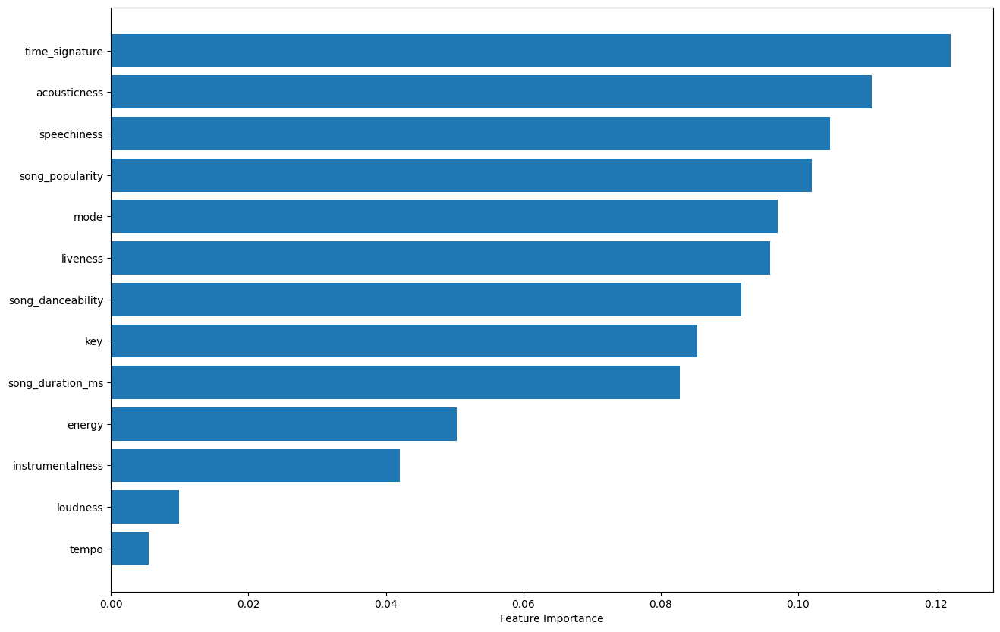

In [ ]:
# Method 2: Feature Importance from Random Forest
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

# Separate independent variables and target variable
X = data_norm.drop(columns = ['song_popularity'])
y = data_norm['song_popularity']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2, random_state=42)

feature_names = [f"feature {i}" for i in range(X.shape[1])]
forest = RandomForestRegressor(random_state=0)
forest.fit(X_train, y_train)

plt.figure(figsize=(15,10))
sort = forest.feature_importances_.argsort()
plt.barh(data_norm.columns[sort], forest.feature_importances_[sort])
plt.xlabel("Feature Importance")

**Tempo seems to be the most important feature in predicting song popularity according to the model used, as it has the longest bar whereas Acousticness and Time Signature have the least importance among the features listed.**

3.Recursive Feature Elimination

In [ ]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression

# Initialize a linear regression model
lr_model = LinearRegression()

# Initialize RFE
rfe = RFE(lr_model, n_features_to_select=1)

# Fit RFE
rfe.fit(X, y)

# Get ranking of features
feature_ranking = pd.Series(rfe.ranking_, index=X.columns).sort_values(ascending=True)
print(feature_ranking)

valence               1
song_danceability     2
energy                3
acousticness          4
liveness              5
speechiness           6
instrumentalness      7
mode                  8
time_signature        9
key                  10
tempo                11
loudness             12
song_duration_ms     13
dtype: int64


**Valence** has been ranked as the most important feature, indicating that it has the strongest relationship with the target variable in the linear regression model context.

**Song Danceability and Energy** follow as the second and third most important features, respectively, suggesting that they also have a significant relationship with the target variable.

**Acousticness and Liveness** are in the middle of the pack in terms of importance.

**Mode, Time Signature, Key, Tempo, and Loudness** are ranked lower, suggesting that they have less influence on the target variable in this model.

**Song Duration (ms)** is ranked the least important by this process, indicating it has the weakest relationship with the target variable among the features considered.



### **Question 5:- Which independent variables have missing data? How much?**

In [ ]:
spotify_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19999 entries, 0 to 19998
Data columns (total 23 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   song_name           19999 non-null  object 
 1   song_popularity     19999 non-null  int64  
 2   song_duration_ms    19999 non-null  int64  
 3   song_danceability   19999 non-null  float64
 4   energy              19999 non-null  float64
 5   key                 19999 non-null  int64  
 6   loudness            19999 non-null  float64
 7   mode                19999 non-null  int64  
 8   speechiness         19999 non-null  float64
 9   acousticness        19999 non-null  float64
 10  instrumentalness    19999 non-null  float64
 11  liveness            19999 non-null  float64
 12  valence             19999 non-null  float64
 13  tempo               19999 non-null  float64
 14  time_signature      19999 non-null  int64  
 15  artist_name         19999 non-null  object 
 16  albu

**NO independent variables are missing**

In [ ]:
spotify_dataset.describe()

,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
count,19999.000000,1.999900e+04,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000
mean,46.480774,2.135679e+05,0.586194,0.673012,5.383969,-7.310172,0.645382,0.072309,0.261883,0.064770,0.195967,0.544104,123.392182,3.926146,63.116456,0.001078,0.000387,0.000216
std,27.375455,6.663083e+04,0.155109,0.221290,3.570028,4.422245,0.478409,0.068625,0.295294,0.205968,0.161012,0.241924,29.805735,0.336463,20.469460,0.001891,0.000617,0.000537
min,0.000000,3.062200e+04,0.078300,0.000071,0.000000,-43.957000,0.000000,0.023100,0.000001,0.000000,0.015000,0.027300,34.821000,0.000000,0.000000,0.000050,0.000050,0.000050
25%,26.000000,1.720820e+05,0.479000,0.539000,2.000000,-8.775000,0.000000,0.034600,0.019500,0.000000,0.095800,0.356000,99.854500,4.000000,56.000000,0.000100,0.000050,0.000050
50%,54.000000,2.058800e+05,0.597000,0.712000,5.000000,-6.201000,1.000000,0.047100,0.128000,0.000007,0.131000,0.547000,122.091000,4.000000,71.000000,0.000350,0.000150,0.000100
75%,69.000000,2.426005e+05,0.701000,0.852000,9.000000,-4.593500,1.000000,0.077150,0.447000,0.001080,0.260000,0.737000,141.278000,4.000000,76.000000,0.001100,0.000400,0.000150
max,100.000000,1.534315e+06,0.976000,0.999000,11.000000,0.681000,1.000000,0.924000,0.996000,0.982000,1.000000,0.994000,215.513000,5.000000,81.000000,0.009200,0.004250,0.005600


### **Question 6: Do the training and test sets have the same data?**

In [ ]:
same_X_data = X_train.equals(X_test)
same_y_data = y_train.equals(y_test)


if same_X_data or same_y_data:
    print("Training and test sets have the same data")
else:
    print("Training and test sets have different data")

Training and test sets have different data


### **Question 9:- Do the ranges of the predictor variables make sense?**

In [ ]:
df.describe()

,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
count,19999.000000,1.999900e+04,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000,19999.000000
mean,46.480774,2.135679e+05,0.586194,0.673012,5.383969,-7.310172,0.645382,0.072309,0.261883,0.064770,0.195967,0.544104,123.392182,3.926146
std,27.375455,6.663083e+04,0.155109,0.221290,3.570028,4.422245,0.478409,0.068625,0.295294,0.205968,0.161012,0.241924,29.805735,0.336463
min,0.000000,3.062200e+04,0.078300,0.000071,0.000000,-43.957000,0.000000,0.023100,0.000001,0.000000,0.015000,0.027300,34.821000,0.000000
25%,26.000000,1.720820e+05,0.479000,0.539000,2.000000,-8.775000,0.000000,0.034600,0.019500,0.000000,0.095800,0.356000,99.854500,4.000000
50%,54.000000,2.058800e+05,0.597000,0.712000,5.000000,-6.201000,1.000000,0.047100,0.128000,0.000007,0.131000,0.547000,122.091000,4.000000
75%,69.000000,2.426005e+05,0.701000,0.852000,9.000000,-4.593500,1.000000,0.077150,0.447000,0.001080,0.260000,0.737000,141.278000,4.000000
max,100.000000,1.534315e+06,0.976000,0.999000,11.000000,0.681000,1.000000,0.924000,0.996000,0.982000,1.000000,0.994000,215.513000,5.000000


As we can see the ranges differ with each other so the range of these variable does make sense

In [ ]:
df["popularity"]= [ 1 if i>=66.5 else 0 for i in df.song_popularity ]
df["popularity"].value_counts()

0    13226
1     6773
Name: popularity, dtype: int64

Checked popularity rating of songs that have been popular in the last 10 years in Spotify and took the mean value of them (66.5) . According to this value, the songs has above this rating could remain on the top lists for a long time. If song_popularity is higher than 66.5 (this is about 33% percent of data) we labeled it "1" and if is not we labeled it "0". So we have "1" for the popular songs and "0" for the unpopular ones.

In [ ]:
ps=df[df["popularity"]==1]
ps.describe()

,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,popularity
count,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.000000,6773.0
mean,73.782666,218912.436586,0.610474,0.679330,5.393622,-6.583623,0.598996,0.077024,0.217558,0.039127,0.175097,0.504592,121.154384,3.947291,1.0
std,5.727805,58574.058496,0.152706,0.191947,3.574963,3.224317,0.490138,0.073915,0.256378,0.147952,0.133231,0.226411,28.214740,0.279276,0.0
min,67.000000,45055.000000,0.078300,0.005270,0.000000,-37.264000,0.000000,0.023200,0.000005,0.000000,0.020200,0.030100,48.718000,1.000000,1.0
25%,69.000000,181466.000000,0.510000,0.553000,2.000000,-7.989000,0.000000,0.035100,0.018000,0.000000,0.092600,0.331000,99.729000,4.000000,1.0
50%,73.000000,210989.000000,0.620000,0.708000,5.000000,-5.881000,1.000000,0.048800,0.103000,0.000006,0.124000,0.497000,120.012000,4.000000,1.0
75%,77.000000,244800.000000,0.726000,0.832000,9.000000,-4.483000,1.000000,0.082600,0.343000,0.000827,0.218000,0.675000,138.018000,4.000000,1.0
max,100.000000,811077.000000,0.966000,0.997000,11.000000,0.175000,1.000000,0.724000,0.996000,0.982000,0.951000,0.980000,208.951000,5.000000,1.0


**The insights from correlation matrix can be used to understand the relationships between variables, to inform feature selection for predictive modeling, and to identify potential multicollinearity issues.**

In [ ]:
df.corr()

<ipython-input-23-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,popularity
song_popularity,1.000000,0.106292,0.012935,-0.077832,-0.027664,-0.037079,-0.071214,-0.018801,-0.008640,0.024974,-0.058685,-0.186199,-0.066636,0.020126,0.713705
song_duration_ms,0.106292,1.000000,-0.094408,0.012277,0.008364,0.004949,-0.051507,-0.067199,-0.072981,0.014968,0.007363,-0.195283,-0.040739,0.003465,0.057401
song_danceability,0.012935,-0.094408,1.000000,0.090328,0.034328,0.223446,-0.115754,0.196275,-0.116716,-0.212857,-0.118046,0.366812,-0.213499,0.179473,0.112023
energy,-0.077832,0.012277,0.090328,1.000000,0.039818,0.769737,-0.065814,0.168293,-0.699917,-0.313591,0.190067,0.309147,0.203228,0.227040,0.020433
key,-0.027664,0.008364,0.034328,0.039818,1.000000,0.029763,-0.115177,0.063600,-0.017382,-0.010621,-0.011934,0.046701,0.021396,0.012286,0.001935
loudness,-0.037079,0.004949,0.223446,0.769737,0.029763,1.000000,-0.072163,0.145850,-0.591565,-0.539830,0.108350,0.238149,0.127422,0.183048,0.117573
mode,-0.071214,-0.051507,-0.115754,-0.065814,-0.115177,-0.072163,1.000000,-0.094520,0.096617,0.005553,-0.001689,0.038204,0.036594,-0.044663,-0.069387
speechiness,-0.018801,-0.067199,0.196275,0.168293,0.063600,0.145850,-0.094520,1.000000,-0.085333,-0.090611,0.055363,0.082836,0.120251,0.081551,0.049170
acousticness,-0.008640,-0.072981,-0.116716,-0.699917,-0.017382,-0.591565,0.096617,-0.085333,1.000000,0.271099,-0.082929,-0.116492,-0.147127,-0.207620,-0.107419
instrumentalness,0.024974,0.014968,-0.212857,-0.313591,-0.010621,-0.539830,0.005553,-0.090611,0.271099,1.000000,-0.062642,-0.283852,-0.040766,-0.098276,-0.089093


<ipython-input-24-e7b17f722efd>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  mask = np.zeros_like(df.corr())
<ipython-input-24-e7b17f722efd>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(), annot=True,linewidths=0.4,linecolor="white",fmt= '.1f',ax=ax,cmap="Greens",mask=mask)


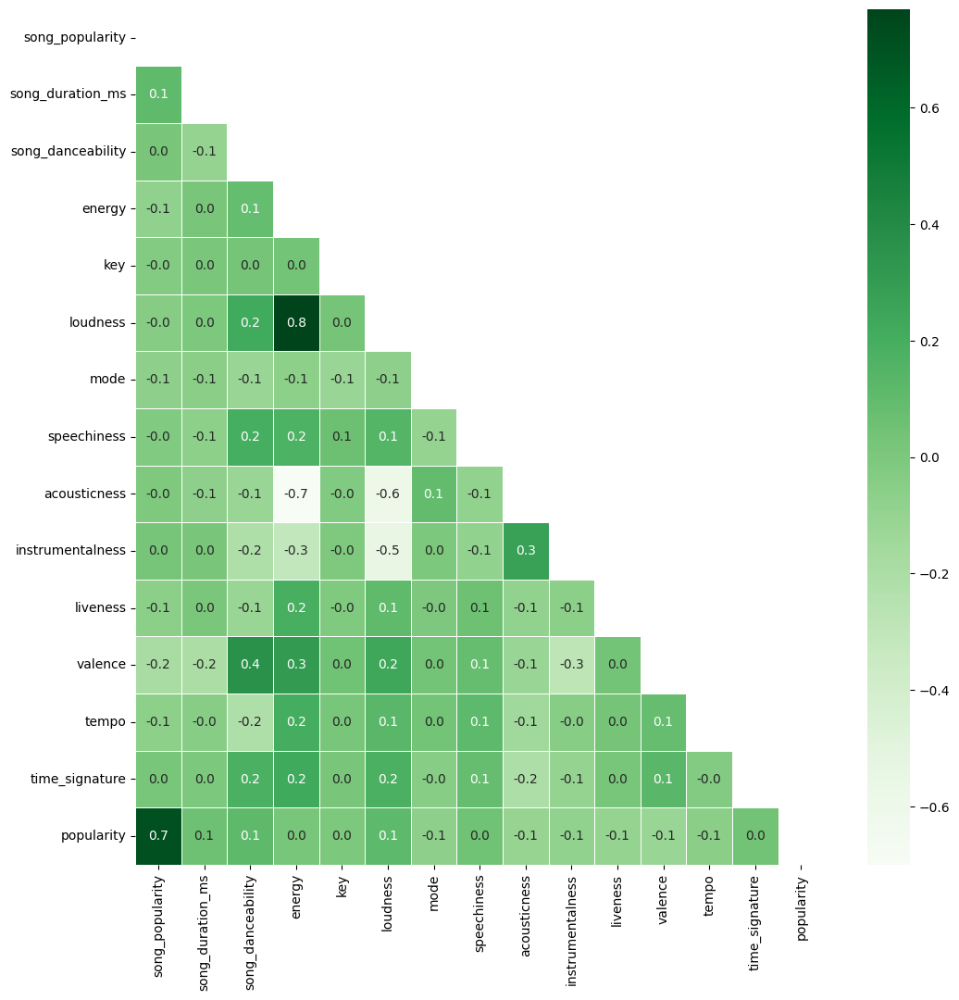

In [ ]:
f,ax = plt.subplots(figsize=(12, 12))
mask = np.zeros_like(df.corr())
mask[np.triu_indices_from(mask)] = True
sns.heatmap(df.corr(), annot=True,linewidths=0.4,linecolor="white",fmt= '.1f',ax=ax,cmap="Greens",mask=mask)
plt.show()

Correlation between loudness and energy is 0.8 which is strong and correlation between accousticness and energy is 0.7 which is moderate. Correlation between loudness and accusticness is 0.6 which is moderate. Except the above mentioned correlations all the correlations are quite low. When we compare the correlation between song_popularity and all other features, we don't see a strong correlation (a linear relationship) that gives us a clear information about popularity. Accusticness,danceability,instrumentalness,liveness,valence,tempo,mode and loudness seems to have correlation with popularity feature(0.10).

Correlation analysis between  song_popularity and other features in the dataset

In [ ]:
def bar_plot(variable):

    var=df[variable]
    var_value= var.value_counts()

    plt.figure(figsize=(9,3))
    plt.bar(var_value.index,var_value,color="orange")
    plt.xticks(var_value.index,var_value.index.values)
    plt.ylabel("Frequency")
    plt.title(variable)
    plt.show()
    print("{}:\n{}".format(variable,var_value))

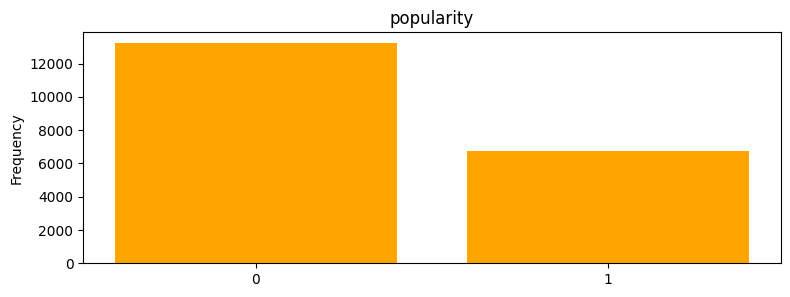

popularity:
0    13226
1     6773
Name: popularity, dtype: int64


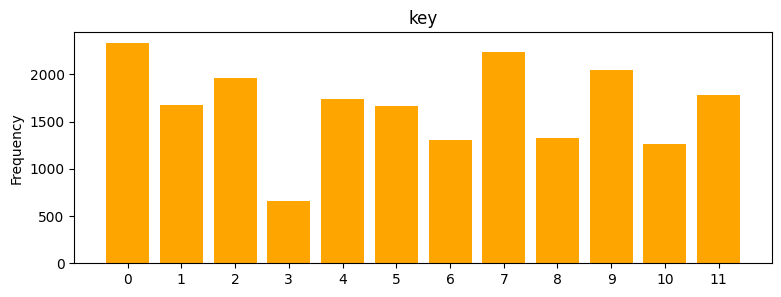

key:
0     2330
7     2241
9     2046
2     1961
11    1786
4     1742
1     1676
5     1664
8     1329
6     1308
10    1259
3      657
Name: key, dtype: int64


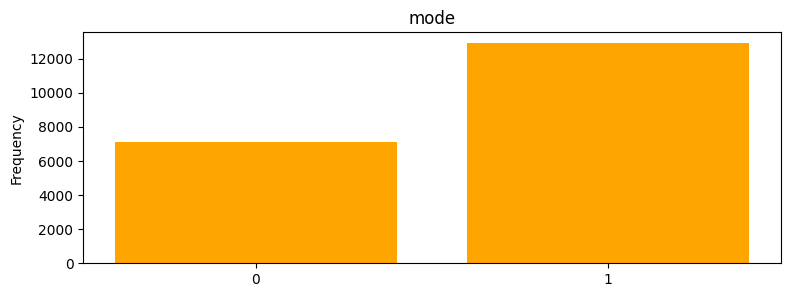

mode:
1    12907
0     7092
Name: mode, dtype: int64


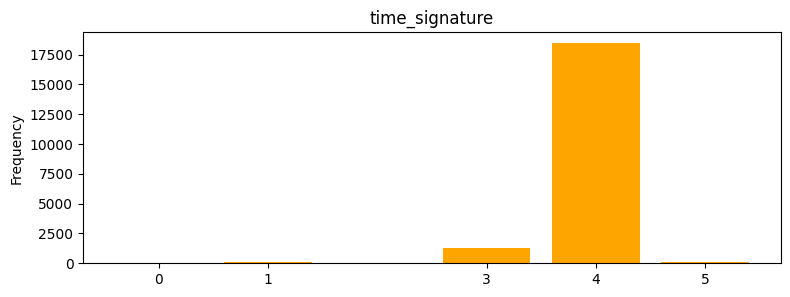

time_signature:
4    18457
3     1303
5      136
1      102
0        1
Name: time_signature, dtype: int64


In [ ]:
category1 = ["popularity","key","mode","time_signature"]
for c in category1:
    bar_plot(c)

average 'popularity' for each unique 'key', sorted from the most popular to the least popular.

In [ ]:
df[["key","popularity"]].groupby(["key"], as_index = False).mean().sort_values(by="popularity",ascending = False)

,key,popularity
1,1,0.417661
8,8,0.404816
6,6,0.382263
11,11,0.354423
10,10,0.351072
3,3,0.348554
5,5,0.334135
2,2,0.332993
4,4,0.327784
9,9,0.307918


In [ ]:
df[["mode","popularity"]].groupby(["mode"], as_index = False).mean().sort_values(by="popularity",ascending = False)

,mode,popularity
0,0,0.382967
1,1,0.314326


<ipython-input-29-73c413f137e6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(), annot=True, cmap='RdYlGn')


<Axes: >

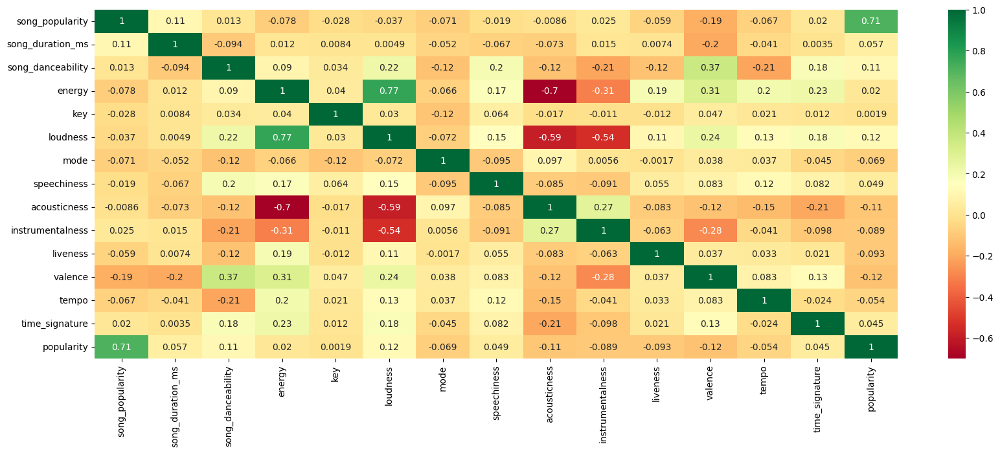

In [ ]:
plt.figure(figsize=(20,7))
sns.heatmap(df.corr(), annot=True, cmap='RdYlGn')

Correlation between loudness and energy is 0.77 which is strong and correlation between accousticness and energy is 0.7 which is moderate. Correlation between loudness and accusticness is 0.6 which is moderate. Except the above mentioned correlations all the correlations are quite low. When we compare the correlation between song_popularity and all other features, we don't see a strong correlation (a linear relationship) that gives us a clear information about popularity. Accusticness,danceability,instrumentalness,liveness,valence,tempo,mode and loudness seems to have correlation with popularity feature(0.10) .

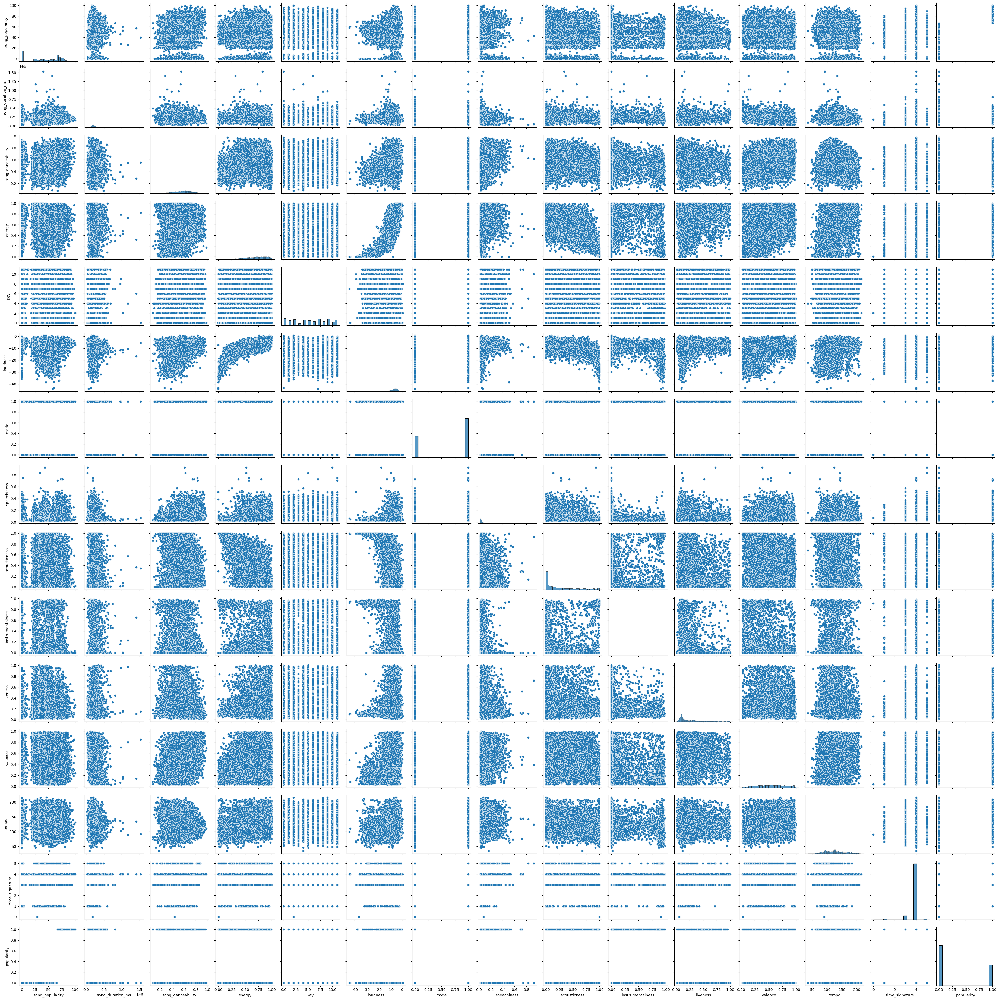

In [ ]:
sns.pairplot(df)

Paiplot pairs up each variable in the dataset with every other variable, showing their scatter plots off-diagonal and their distributions on the diagonal.

This visualization is useful for spotting correlations, trends, and outliers in data.

### **Question 7:- Are the predictor variables independent of all the other predictor variables?**

Correlation between loudness and energy is 0.8 which is strong and correlation between accousticness and energy is 0.7 which is moderate. Correlation between loudness and accusticness is 0.6 which is moderate. Except the above mentioned correlations all the correlations are quite low. When we compare the correlation between song_popularity and all other features, we don't see a strong correlation (a linear relationship) that gives us a clear information about popularity. Accusticness,danceability,instrumentalness,liveness,valence,tempo,mode and loudness seems to have correlation with popularity feature(0.10) .

In [ ]:
print('artist_name' in spotify_dataset.columns)

True


<ipython-input-32-2d44520b2db5>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=lead_artists.values, y=lead_artists.index, palette="Greens", orient="h", edgecolor='black', ax=ax)


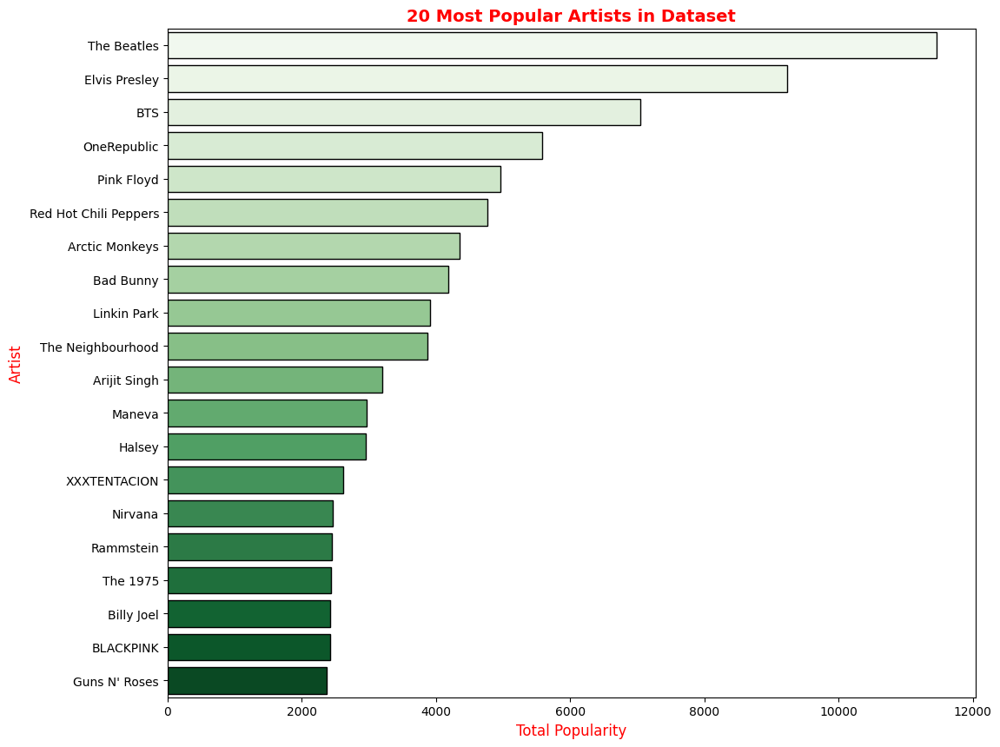

In [ ]:
fig, ax = plt.subplots(figsize = (12, 10))
lead_artists =spotify_dataset.groupby('artist_name')['song_popularity'].sum().sort_values(ascending=False).head(20)
ax = sns.barplot(x=lead_artists.values, y=lead_artists.index, palette="Greens", orient="h", edgecolor='black', ax=ax)
ax.set_xlabel('Total Popularity', c='r', fontsize=12)
ax.set_ylabel('Artist', c='r', fontsize=12)
ax.set_title('20 Most Popular Artists in Dataset', c='r', fontsize=14, weight = 'bold')
plt.show()

<ipython-input-33-4c3b0afdb9fd>:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=lead_artists.values, y=lead_artists.index, palette="Greens", orient="h", edgecolor='black', ax=ax)


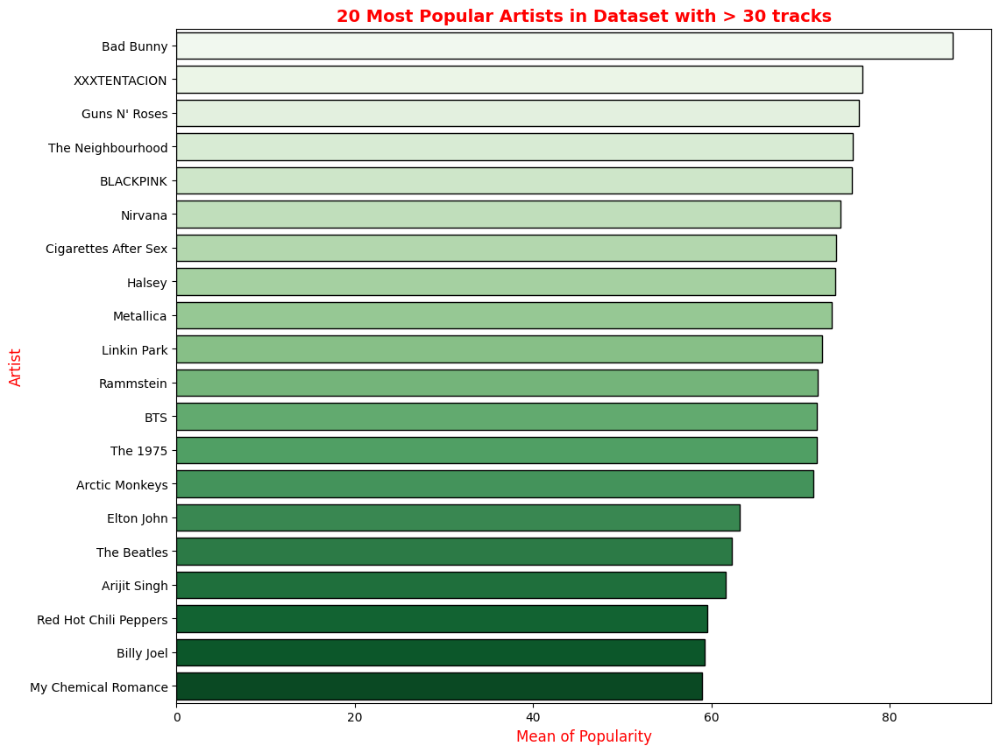

In [ ]:
spotify_dataset['popular_artist'] = spotify_dataset['artist_name'].map(spotify_dataset['artist_name'].value_counts()>30)
pop_arts  = spotify_dataset.groupby(['artist_name', 'popular_artist'])['song_popularity'].mean().sort_values(ascending=False).reset_index(1)
df_pop_arts = pop_arts.loc[pop_arts['popular_artist'] == True,['song_popularity']]

# # Plotting
fig, ax = plt.subplots(figsize = (12, 10))
lead_artists = df_pop_arts.groupby('artist_name')['song_popularity'].mean().sort_values(ascending=False).head(20)
ax = sns.barplot(x=lead_artists.values, y=lead_artists.index, palette="Greens", orient="h", edgecolor='black', ax=ax)
ax.set_xlabel('Mean of Popularity', c='r', fontsize=12)
ax.set_ylabel('Artist', c='r', fontsize=12)
ax.set_title('20 Most Popular Artists in Dataset with > 30 tracks', c='r', fontsize=14, weight = 'bold')
plt.show()


Since we believe there should be a correlation between the artist and the popularity of the track, we would like to use the Target Encoding approach, and replace the artist with some derivative of its popularity.

First, we check distribution of number of times artists appear in the data.

It is clear that most artists appear less than 20 times

<ipython-input-34-414ebdbedfb0>:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(spotify_dataset['count'], bins = 600)


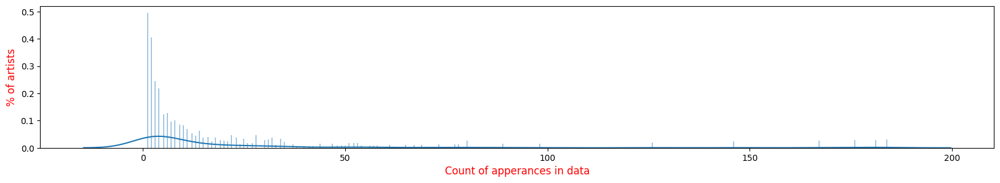

In [ ]:
# Adding Mean & Count values to each artist
spotify_dataset['mean'] = spotify_dataset.groupby('artist_name')['song_popularity'].transform('mean')
spotify_dataset['count'] = spotify_dataset.groupby('artist_name')['song_popularity'].transform('count')

fig, ax = plt.subplots(figsize = (20, 3))
ax = sns.distplot(spotify_dataset['count'], bins = 600)
ax.set_xlabel('Count of apperances in data', fontsize=12, c='r')
ax.set_ylabel('% of artists', fontsize=12, c='r')
plt.show()

<ipython-input-35-ac29340e6374>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(spotify_dataset['count'], bins=600, kde=False)


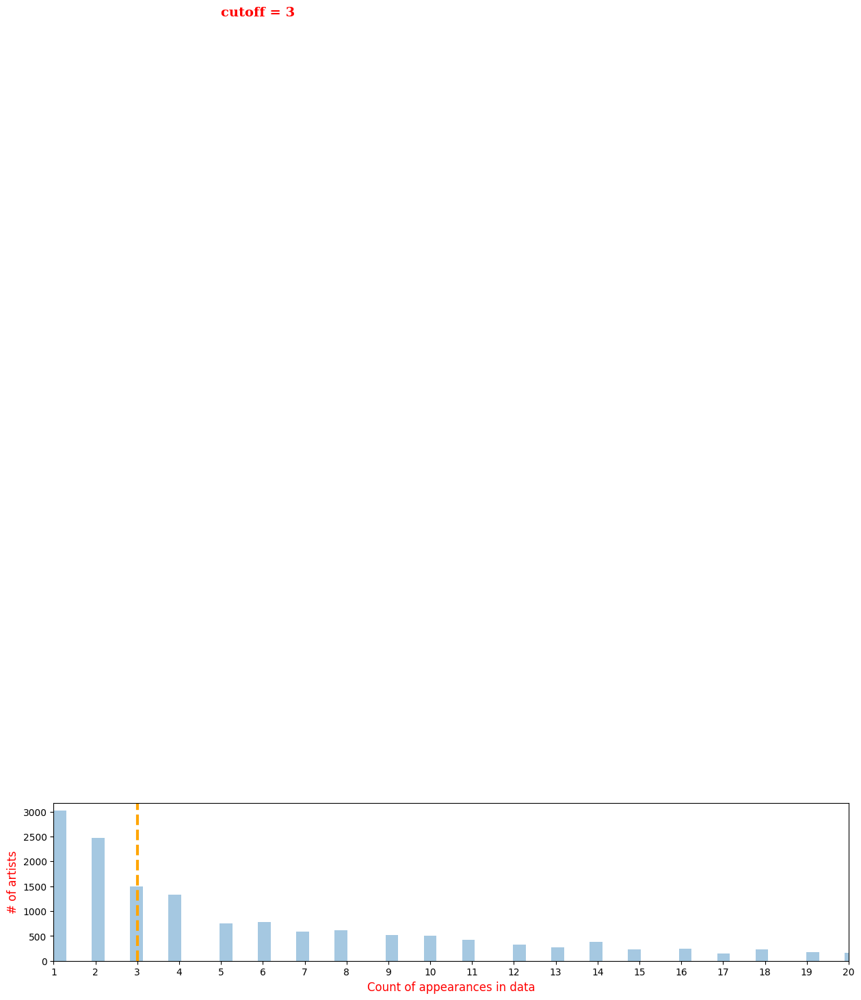

In [ ]:
fig, ax = plt.subplots(figsize = (15, 3))
ax = sns.distplot(spotify_dataset['count'], bins=600, kde=False)
ax.set_xlabel('Count of appearances in data', fontsize=12, c='r')
ax.set_ylabel('# of artists', fontsize=12, c='r')
ax.set_xlim(1,20)
ax.set_xticks(range(1,21,1))
ax.axvline(x=3, ymin=0, ymax=1, color='orange', linestyle='dashed', linewidth=3)
font = {'family': 'serif',
        'color':  'red',
        'weight': 'bold',
        'size': 14,
        }
ax.annotate("", xy=(3, 19000), xytext=(4.8, 19000), arrowprops=dict(arrowstyle="->", color='r', linestyle='dashed', linewidth=3))
ax.text(x = 5, y = 19000, s='cutoff = 3', fontdict=font)

plt.show()

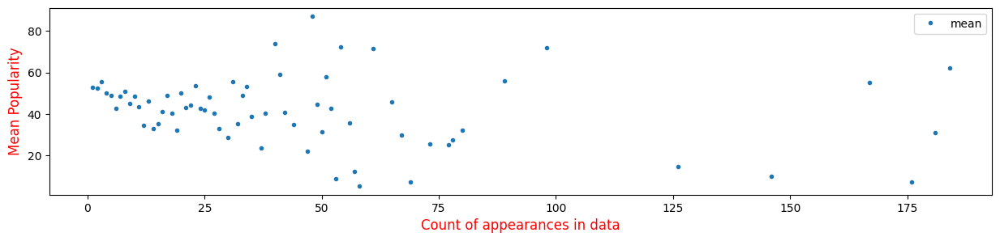

In [ ]:
fig, ax = plt.subplots(figsize = (15, 3))
stat = spotify_dataset.groupby('count')['mean'].mean().to_frame().reset_index()
ax = stat.plot(x='count', y='mean', marker='.', linestyle = '', ax=ax)
ax.set_xlabel('Count of appearances in data', fontsize=12, c='r')
ax.set_ylabel('Mean Popularity', fontsize=12, c='r')
plt.show()

In [ ]:
frequent_flyer = spotify_dataset[['artist_name','mean']].loc[spotify_dataset['count']>60].value_counts(ascending=False).reset_index()
frequent_flyer.columns=['Artist','Mean Popularity', '# of Tracks']
frequent_flyer

,Artist,Mean Popularity,# of Tracks
0,The Beatles,62.309783,184
1,OneRepublic,30.861878,181
2,The Beach Boys,7.329545,176
3,Elvis Presley,55.269461,167
4,Chuck Berry,9.815068,146
5,Feid,14.468254,126
6,BTS,71.857143,98
7,Pink Floyd,55.775281,89
8,Brenda Lee,4.725000,80
9,Red Hot Chili Peppers,59.600000,80


In [ ]:
# key vs popularity
df[["key","popularity"]].groupby(["key"], as_index = False).mean().sort_values(by="popularity",ascending = False)

,key,popularity
1,1,0.417661
8,8,0.404816
6,6,0.382263
11,11,0.354423
10,10,0.351072
3,3,0.348554
5,5,0.334135
2,2,0.332993
4,4,0.327784
9,9,0.307918


In [ ]:
# mode vs popularity
df[["mode","popularity"]].groupby(["mode"], as_index = False).mean().sort_values(by="popularity",ascending = False)

,mode,popularity
0,0,0.382967
1,1,0.314326


In [ ]:
df[["time_signature","popularity"]].groupby(["time_signature"], as_index = False).mean().sort_values(by="popularity",ascending = False)

,time_signature,popularity
3,4,0.344693
4,5,0.323529
2,3,0.268611
1,1,0.166667
0,0,0.000000


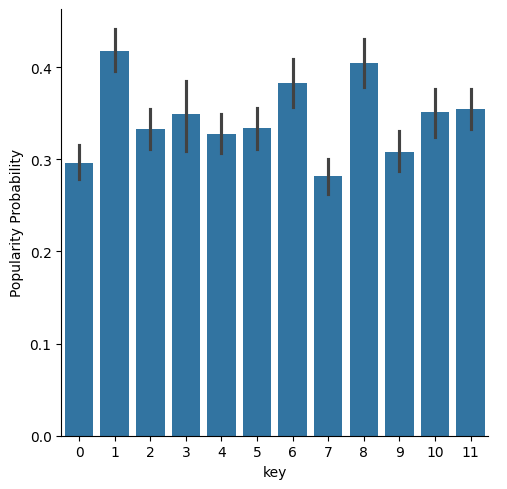

In [ ]:
g = sns.catplot(x = "key", y = "popularity", data = df, kind = "bar", height = 5)
g.set_ylabels("Popularity Probability")
plt.show()

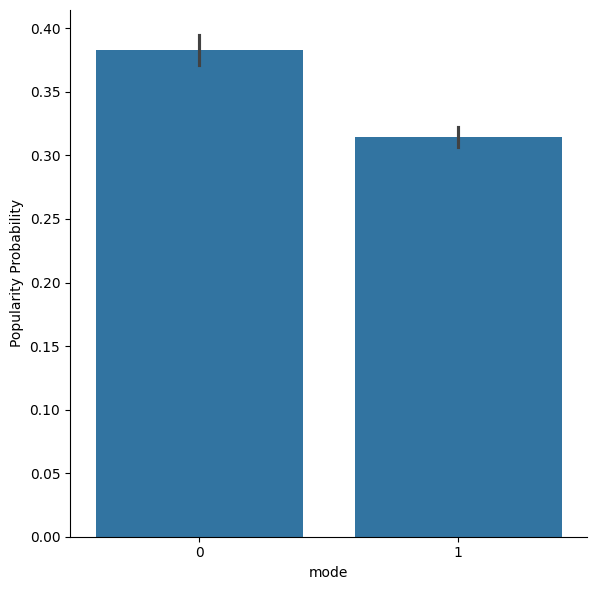

In [ ]:
g = sns.catplot(x = "mode", y = "popularity", data = df, kind = "bar", height = 6)
g.set_ylabels("Popularity Probability")
plt.show()

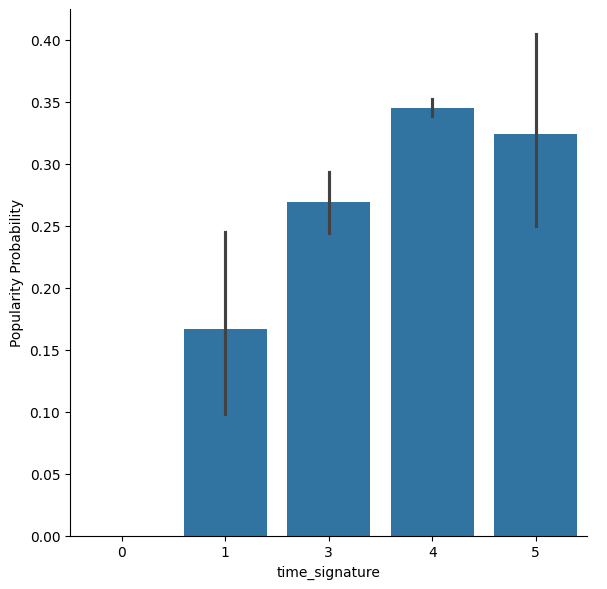

In [ ]:
g = sns.catplot(x = "time_signature", y = "popularity", data = df, kind = "bar", height = 6)
g.set_ylabels("Popularity Probability")
plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


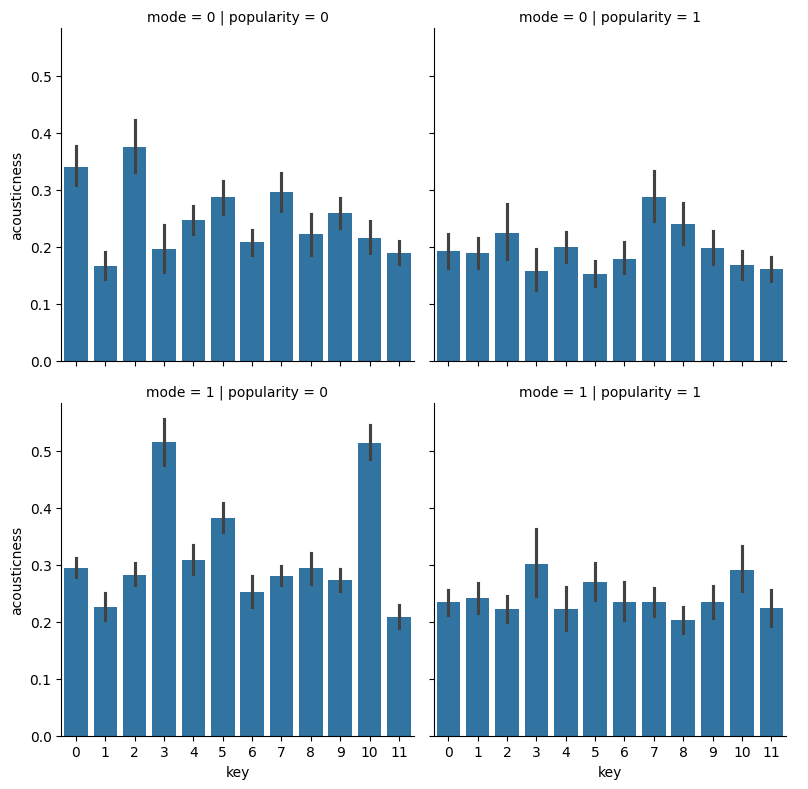

In [ ]:
g = sns.FacetGrid(df, row = "mode", col = "popularity", height = 4)
g.map(sns.barplot, "key", "acousticness")
g.add_legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


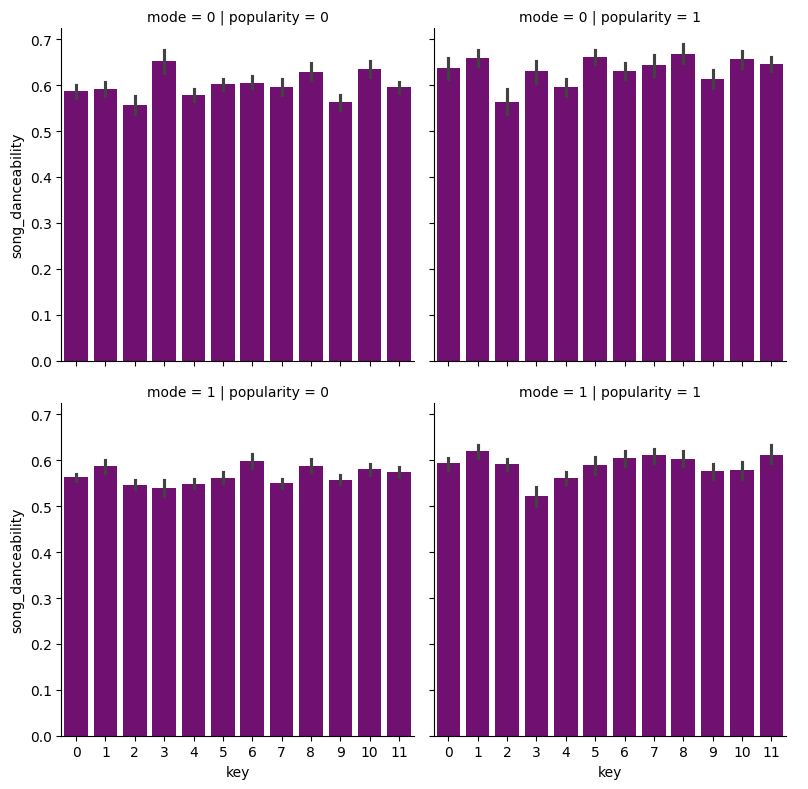

In [ ]:
g = sns.FacetGrid(df, row = "mode", col = "popularity", height = 4)
g.map(sns.barplot, "key", "song_danceability",color="purple")
g.add_legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


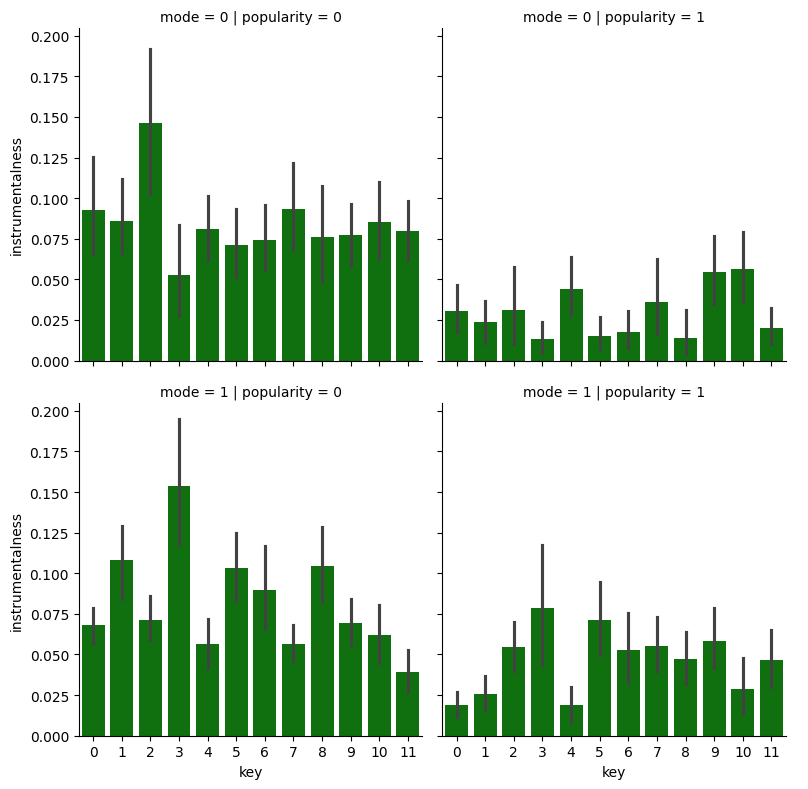

In [ ]:
g = sns.FacetGrid(df, row = "mode", col = "popularity", height = 4)
g.map(sns.barplot, "key", "instrumentalness",color="green")
g.add_legend()
plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:718: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


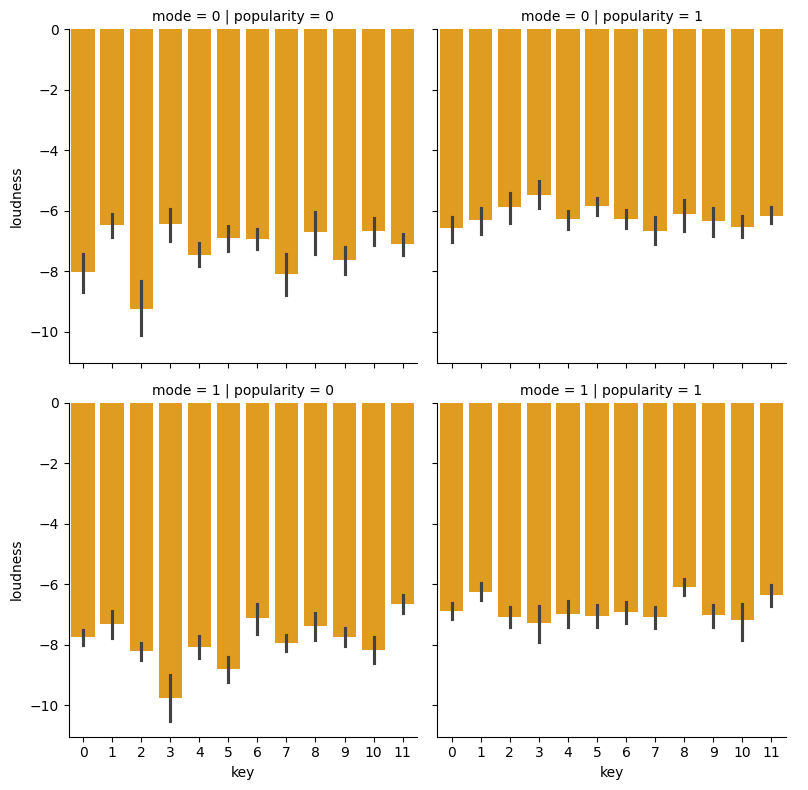

In [ ]:
g = sns.FacetGrid(df, row = "mode", col = "popularity", height = 4)
g.map(sns.barplot, "key", "loudness",color="orange")
g.add_legend()
plt.show()

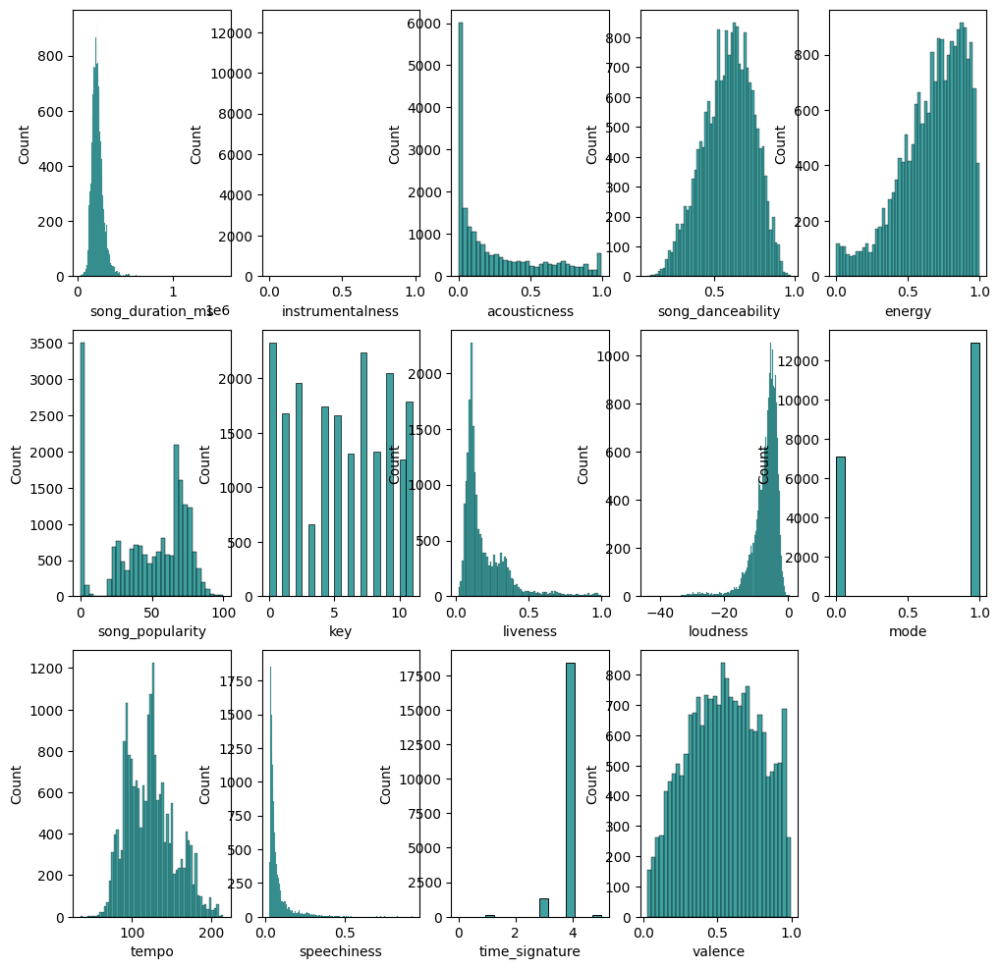

In [ ]:
f, axes = plt.subplots(3, 5, figsize=(12, 12))
sns.histplot( df["song_duration_ms"] , color="teal", ax=axes[0, 0])
sns.histplot( df["instrumentalness"] , color="teal", ax=axes[0, 1])
sns.histplot( df["acousticness"] , color="teal", ax=axes[0, 2])
sns.histplot( df["song_danceability"] , color="teal", ax=axes[0, 3])
sns.histplot( df["energy"] , color="teal", ax=axes[0, 4])
sns.histplot( df["song_popularity"] , color="teal", ax=axes[1, 0])
sns.histplot( df["key"] , color="teal", ax=axes[1, 1])
sns.histplot( df["liveness"] , color="teal", ax=axes[1, 2])
sns.histplot( df["loudness"] , color="teal", ax=axes[1, 3])
sns.histplot( df["mode"] , color="teal", ax=axes[1, 4])
sns.histplot( df["tempo"] , color="teal", ax=axes[2, 0])
sns.histplot( df["speechiness"] , color="teal", ax=axes[2, 1])
sns.histplot( df["time_signature"] , color="teal", ax=axes[2, 2])
sns.histplot( df["valence"] , color="teal", ax=axes[2, 3])
f.delaxes(axes[2][4])
plt.show()

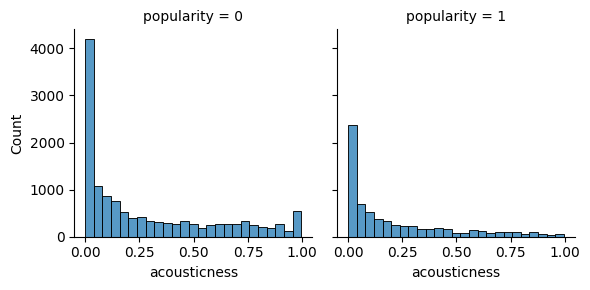

In [ ]:
g = sns.FacetGrid(df, col = "popularity")
g.map(sns.histplot, "acousticness", bins = 25)
plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:854: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:854: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)


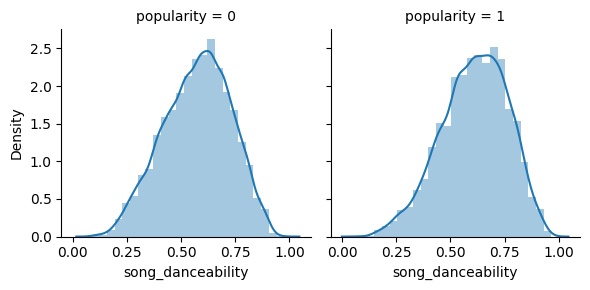

In [ ]:
g = sns.FacetGrid(df, col = "popularity")
g.map(sns.distplot, "song_danceability", bins = 25)
plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:854: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:854: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)


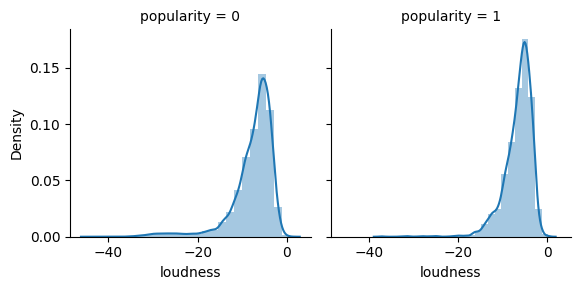

In [ ]:
g = sns.FacetGrid(df, col = "popularity")
g.map(sns.distplot, "loudness", bins = 25)
plt.show()

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:854: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:854: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  func(*plot_args, **plot_kwargs)


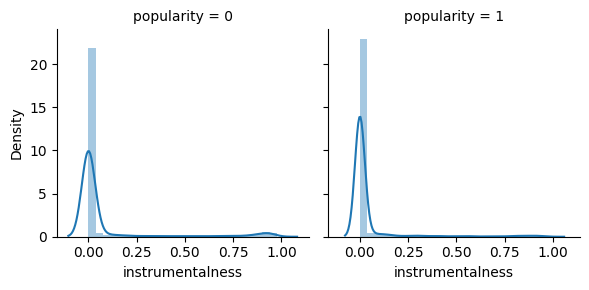

In [ ]:
g = sns.FacetGrid(df, col = "popularity")
g.map(sns.distplot, "instrumentalness", bins = 25)
plt.show()


Data distribution of songs display today's songs features like dancebility, energy, loudness and tempo are quite high. People like fast and loud music.
According to instrumentalness, liveness and speechness, most of the songs are not live performances and they have lyrics.
Keys like 0,1,5,6 and 11 seems more effective in songs. And if key== 0 or 1 or 6 song has more chance to be populer.
Time_signature is mostly 4 and 5 in both populer and general data.
If song_danceability>0.6 song has more chance to be popular.
If loudness > -10 song has more chance to be popular

In [ ]:
song_data=df.copy()
song_data["song_audio_valence"]= [ "Happy" if i>=0.5 else "Sad" for i in song_data.valence ]
song_data["song_audio_valence"].value_counts()

Happy    11325
Sad       8674
Name: song_audio_valence, dtype: int64

In [ ]:
song_data1=song_data[song_data["song_popularity"]>66.5]
song_data1["song_audio_valence"]= [ "Happy" if i>=0.5 else "Sad" for i in song_data1.valence ]
song_data1["song_audio_valence"].value_counts()

<ipython-input-54-f2aae61f5d11>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  song_data1["song_audio_valence"]= [ "Happy" if i>=0.5 else "Sad" for i in song_data1.valence ]


Sad      3404
Happy    3369
Name: song_audio_valence, dtype: int64

In [ ]:
song_data2_new=song_data1[song_data1["song_popularity"]>90]
song_data2_new["song_audio_valence"]= [ "Happy" if i>=0.5 else "Sad" for i in song_data2_new.valence ]
song_data2_new["song_audio_valence"].value_counts()

<ipython-input-55-723c91b4a372>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  song_data2_new["song_audio_valence"]= [ "Happy" if i>=0.5 else "Sad" for i in song_data2_new.valence ]


Sad      48
Happy    20
Name: song_audio_valence, dtype: int64

<ipython-input-56-df2f3156f8da>:7: MatplotlibDeprecationWarning: The 'use_line_collection' parameter of stem() was deprecated in Matplotlib 3.6 and will be removed two minor releases later. If any parameter follows 'use_line_collection', they should be passed as keyword, not positionally.
  markerline, stemlines, baseline = plt.stem(


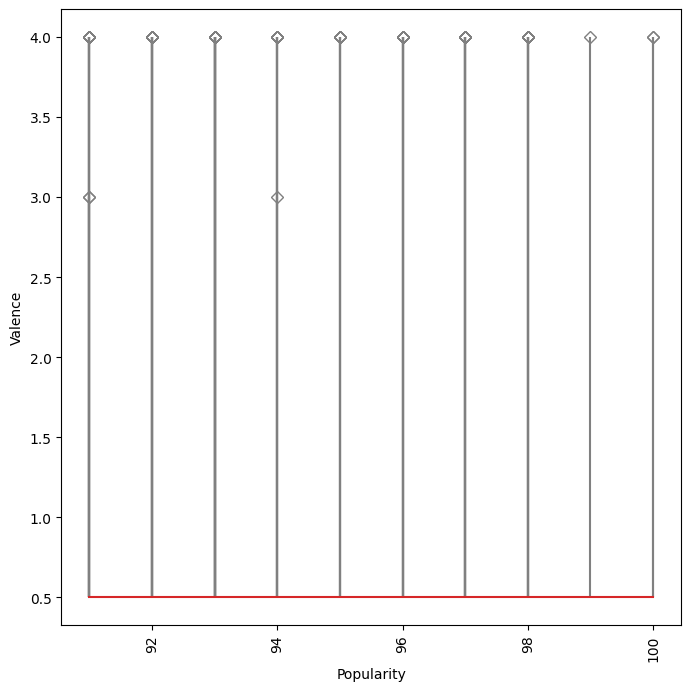

In [ ]:
song_data2= song_data2_new[song_data2_new.popularity==1]
a=song_data2.iloc[:,1]
a.to_numpy()
b=song_data2.iloc[:,14]
b.to_numpy()
plt.figure(figsize=[8,8])
markerline, stemlines, baseline = plt.stem(
    a, b, linefmt='grey', markerfmt='D', bottom=0.5,use_line_collection= True)
markerline.set_markerfacecolor('none')
plt.xlabel("Popularity")
plt.ylabel("Valence")
plt.xticks(rotation='vertical')
plt.show()

### **Question 8: Which predictor variables are the most important?**

Random Forest Model

In [ ]:
# Initialize Random Forest model
rf_model = RandomForestRegressor()

# Fit the model to the data
rf_model.fit(X, y)

# Get feature importances
feature_importances = pd.Series(rf_model.feature_importances_, index=X.columns).sort_values(ascending=False)

# Print the most important predictor variables
print("Most important predictor variables:")
print(feature_importances.head())

Most important predictor variables:
valence              0.118337
song_danceability    0.109966
tempo                0.106395
song_duration_ms     0.100391
loudness             0.099458
dtype: float64


OLS Regression

In [ ]:
import statsmodels.api as sm

model = sm.OLS(df['popularity'], df[['song_duration_ms', 'acousticness', 'song_danceability', 'energy', 'instrumentalness',
       'key', 'liveness','loudness', 'mode', 'speechiness',"tempo","time_signature","valence"]]).fit()

# Print out the statistics
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:             popularity   R-squared (uncentered):                   0.385
Model:                            OLS   Adj. R-squared (uncentered):              0.385
Method:                 Least Squares   F-statistic:                              963.2
Date:                Wed, 03 Apr 2024   Prob (F-statistic):                        0.00
Time:                        01:58:15   Log-Likelihood:                         -12686.
No. Observations:               19999   AIC:                                  2.540e+04
Df Residuals:                   19986   BIC:                                  2.550e+04
Df Model:                          13                                                  
Covariance Type:            nonrobust                                                  
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
song_duration_ms   3.437e-07   4.84e-08      7.098      0.000    2.49e-07    4.39e-07
acousticness         -0.1069      0.015     -7.094      0.000      -0.136      -0.077
song_danceability     0.4214      0.024     17.701      0.000       0.375       0.468
energy               -0.1385      0.027     -5.221      0.000      -0.190      -0.087
instrumentalness     -0.1375      0.019     -7.054      0.000      -0.176      -0.099
key                   0.0006      0.001      0.691      0.490      -0.001       0.002
liveness             -0.2164      0.021    -10.451      0.000      -0.257      -0.176
loudness              0.0093      0.001      7.476      0.000       0.007       0.012
mode                 -0.0219      0.007     -3.184      0.001      -0.035      -0.008
speechiness           0.1888      0.049      3.821      0.000       0.092       0.286
tempo              7.888e-05      0.000      0.722      0.470      -0.000       0.000
time_signature        0.1114      0.007     15.139      0.000       0.097       0.126
valence              -0.3558      0.016    -22.112      0.000      -0.387      -0.324
==============================================================================
Omnibus:                   277744.551   Durbin-Watson:                   0.631
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2643.283
Skew:                           0.572   Prob(JB):                         0.00
Kurtosis:                       1.635   Cond. No.                     3.46e+06
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 3.46e+06. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

**R-squared (uncentered):** This value is 0.385, indicating that approximately 38.5% of the variance in the popularity can be explained by the independent variables in the model. It's labeled uncentered because the model does not include a constant term.

**Adjusted R-squared (uncentered):** Similar to R-squared, adjusted to the number of predictors in the model, and is also 0.385, indicating a good fit for the model with the number of predictors included.

**F-statistic:** The F-statistic is 963.2, and the associated p-value is very small (essentially zero), which suggests the model as a whole is statistically significant.

**Coefficients:** The coefficients tell you the amount of change you can expect in the dependent variable for a one-unit change in the predictor variable, holding all other predictors constant. For example, for every one unit increase in song_danceability, popularity increases by an average of 0.4214 units.

**P>|t|:** This column shows the p-value for each coefficient. A low p-value (typically ≤ 0.05) indicates that you can reject the null hypothesis that the coefficient is zero (i.e., the variable has no effect). Variables song_duration_ms, acousticness, song_danceability, energy, instrumentalness, liveness, loudness, mode, speechiness, time_signature, and valence are significant predictors of popularity because their p-values are less than 0.05.

**Confidence Interval:** This provides a range that is likely to contain the true coefficient for the population from which your sample is drawn. For example, the 95% confidence interval for the coefficient of valence is between -0.387 and -0.324.

**Durbin-Watson:** The Durbin-Watson statistic is 0.631, which is close to 0 indicating a positive autocorrelation. Generally, a value between 1 and 2 suggests that there is no autocorrelation in the residuals.

**Condition Number:** The condition number is 3.46e+06, which is quite high, indicating potential multicollinearity or other numerical problems.

**Omnibus/Prob(Omnibus):** The Omnibus test has a very low p-value, suggesting the residuals are not normally distributed.

**Jarque-Bera (JB)/Prob(JB):** Similar to Omnibus, the Jarque-Bera test also indicates that the residuals are not normally distributed.

**Skew:** The value of Skew is 0.572, indicating a moderate right skew in the residual distribution.

**Kurtosis:** The value for Kurtosis is 1.635, which indicates that the tails are lighter than the normal distribution (leptokurtic).

Feature Importance

Text(0.5, 0, 'Feature Importance')

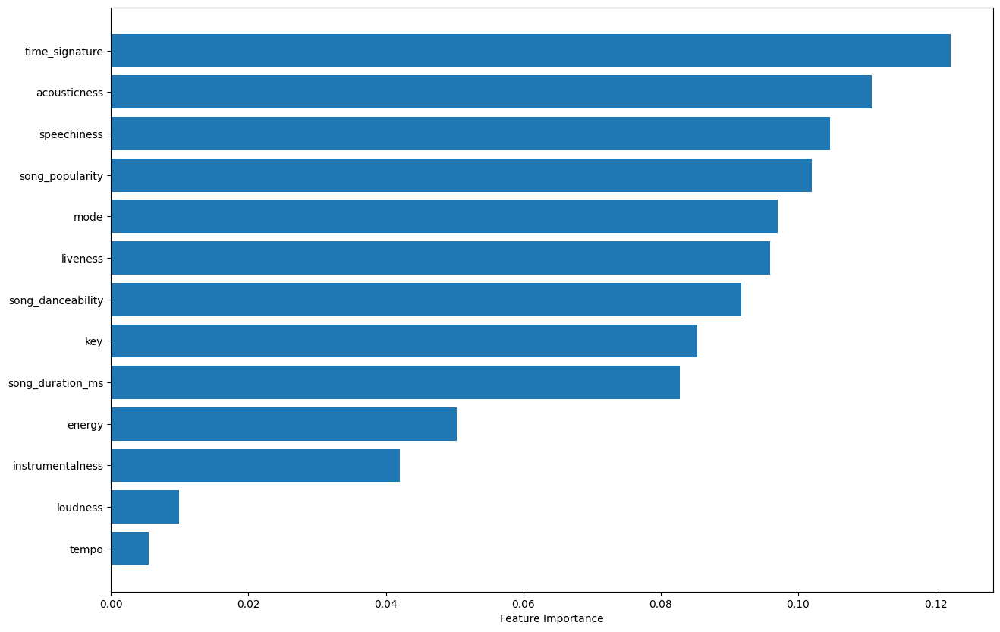

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor

# Separate independent variables and target variable
X = data_norm.drop(columns = ['song_popularity'])
y = data_norm['song_popularity']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2, random_state=42)

feature_names = [f"feature {i}" for i in range(X.shape[1])]
forest = RandomForestRegressor(random_state=0)
forest.fit(X_train, y_train)

plt.figure(figsize=(15,10))
sort = forest.feature_importances_.argsort()
plt.barh(data_norm.columns[sort], forest.feature_importances_[sort])
plt.xlabel("Feature Importance")

From the above methods we can infer that

song_danceability

valence

acousticness

song_duration_ms

loudness

tempo

instrumentalness

Are the most significant features to predict the target variable.

### **Question 10 : What are the distributions of the predictor variables?**

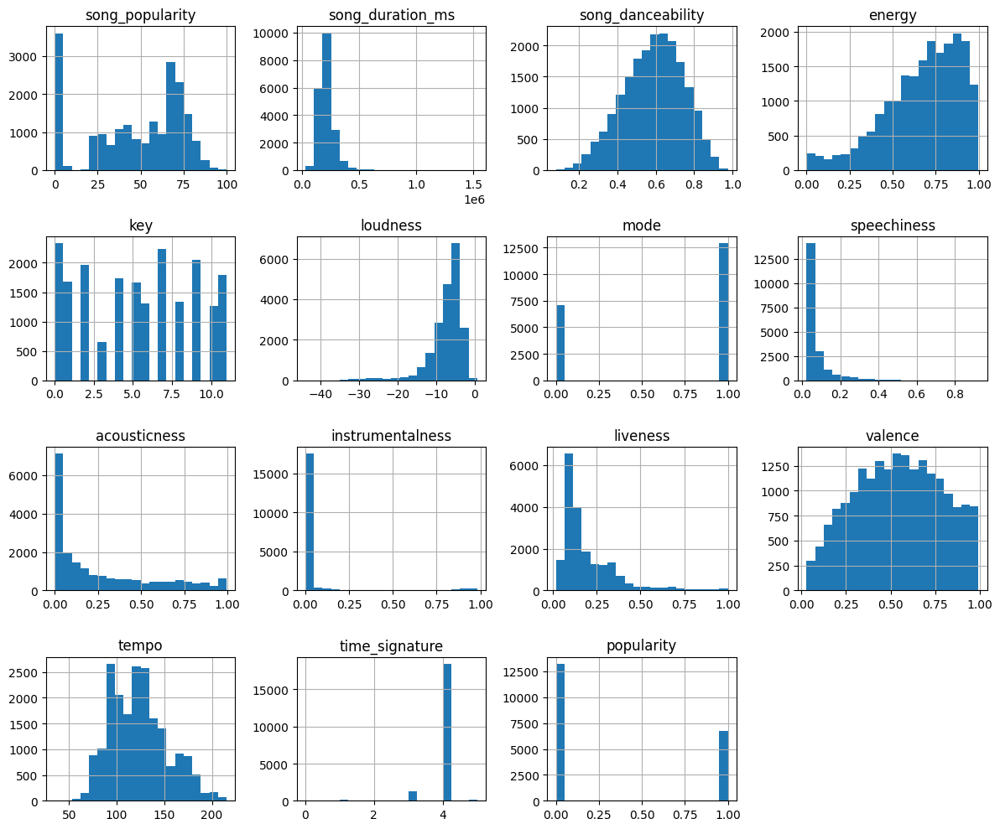

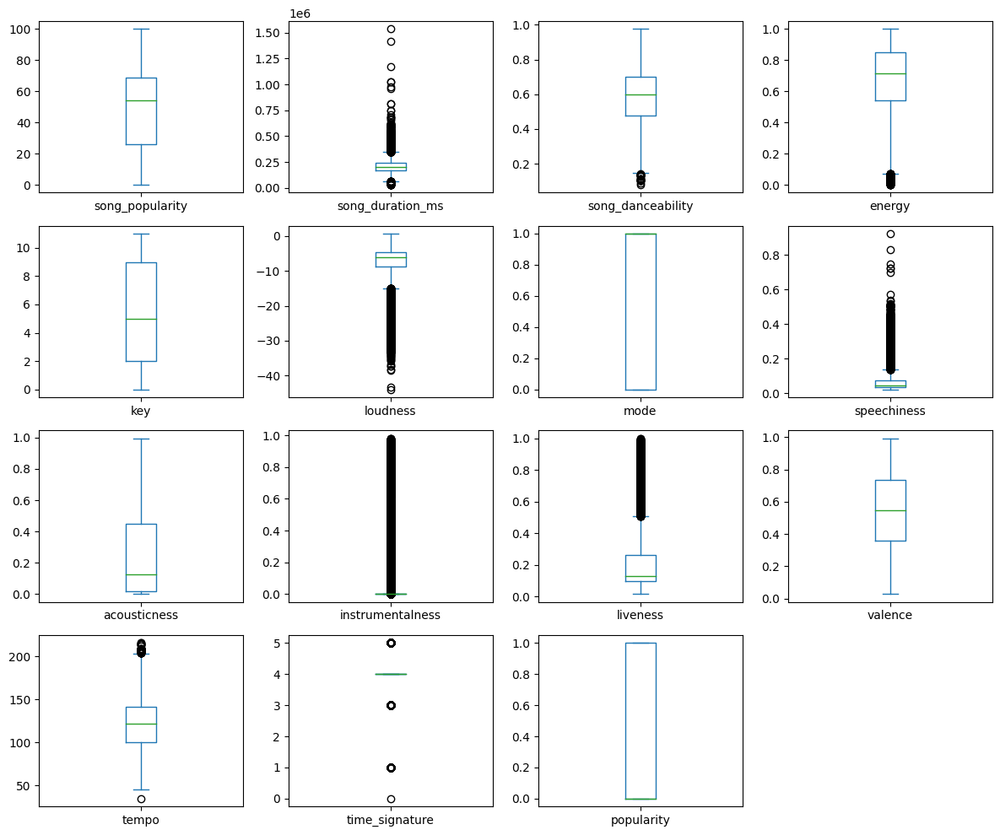

In [ ]:
#histogram for all numericalfeatures
df.hist(figsize=(12, 10), bins=20)
plt.tight_layout()
plt.show()

# box plots for all numerical features
df.plot(kind='box', subplots=True, layout=(4,4), figsize=(12, 10))
plt.tight_layout()
plt.show()


**Histograms:**

Histograms provide insight into the distribution of the data.

The histograms for song_popularity and energy suggest a skewed distribution, while song_danceability appears more normally distributed.

Several histograms exhibit long tails, indicating skewness. For example, song_duration_ms has a long right tail suggesting positive skewness.

**Boxplots:**

Boxplots give a visual summary of the central tendency, dispersion, and skewness of the data. Outliers can be identified through points that lie outside the whiskers.

For variables like song_popularity, loudness, and valence, the boxplot shows a wide range indicating variability in the data.

Variables like key and time_signature display a smaller interquartile range, suggesting less variability.
Outliers are present in many variables, as shown by the points beyond the whiskers.

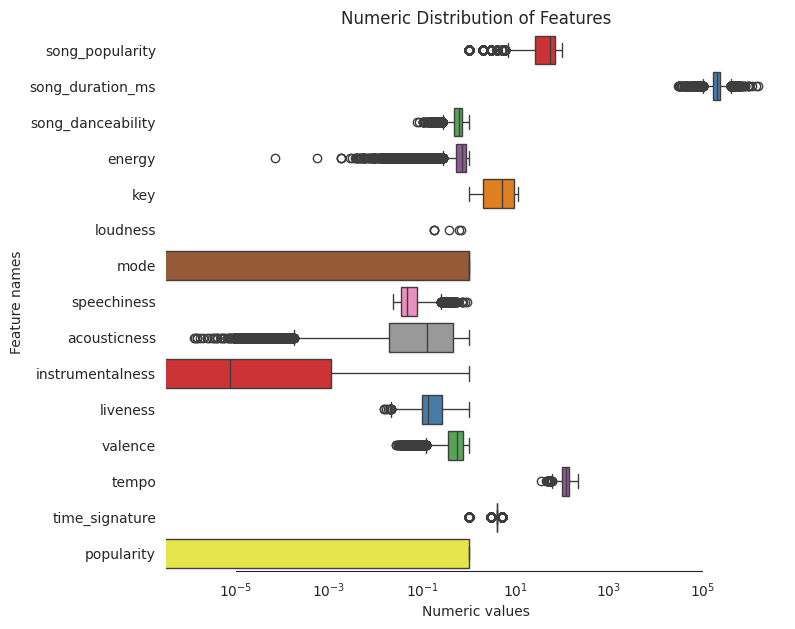

In [ ]:
#Horizontal box plot
sns.set_style("white")
f, ax = plt.subplots(figsize=(8, 7))
ax.set_xscale("log")
ax = sns.boxplot(data=df, orient="h", palette="Set1")
ax.xaxis.grid(False)
ax.set(ylabel="Feature names")
ax.set(xlabel="Numeric values")
ax.set(title="Numeric Distribution of Features")
sns.despine(trim=True, left=True)

The log scale helps to visually compress the range of values so that we can see the distribution of all features, despite their different scales, on one plot. This type of plot is particularly helpful for identifying which features have the most variance and may influence the results of any predictive models. The presence of outliers could also indicate special cases or errors in the data that may need to be addressed.

**Song_duration_ms** have a wide distribution, indicating significant variance in song lengths, with some outliers indicating very long songs.

**Loudness and tempo** also show wide distributions with outliers on both ends, suggesting that there are songs with very high and very low values for these features.

The features **key, mode, and time_signature** are likely categorical or have limited numerical range, as indicated by the less spread and fewer outliers.

**Song_popularity** seems to have a compact interquartile range but with many outliers, which could suggest a few songs have extremely high popularity compared to most.

**Acousticness and instrumentalness** appear to have many data points clustered close to lower values, suggesting that many songs have low acoustic and instrumental components.

**Energy, speechiness, liveness, and valence** display medium variance with some outliers.

### **Question 11:Remove outliers and keep outliers (does if have an effect of the final predictive model)?**

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Load and prepare your dataset


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Identify and remove outliers from X_train
# Simple IQR based outlier removal
Q1 = X_train.quantile(0.25)
Q3 = X_train.quantile(0.75)
IQR = Q3 - Q1
X_train_no_outliers = X_train[~((X_train < (Q1 - 1.5 * IQR)) | (X_train > (Q3 + 1.5 * IQR))).any(axis=1)]

# Ensure the indices of y_train match those of X_train_no_outliers
y_train_no_outliers = y_train[X_train_no_outliers.index]

# Train model on data with outliers
model_with_outliers = RandomForestClassifier(random_state=42)
model_with_outliers.fit(X_train, y_train)
predictions = model_with_outliers.predict(X_test)
score_with_outliers = accuracy_score(y_test, predictions)

# Train model on data without outliers
model_no_outliers = RandomForestClassifier(random_state=42)
model_no_outliers.fit(X_train_no_outliers, y_train_no_outliers)
predictions = model_no_outliers.predict(X_test)
score_no_outliers = accuracy_score(y_test, predictions)

# Compare the performance
print("Accuracy with outliers:", score_with_outliers)
print("Accuracy without outliers:", score_no_outliers)


Accuracy with outliers: 0.3865
Accuracy without outliers: 0.27


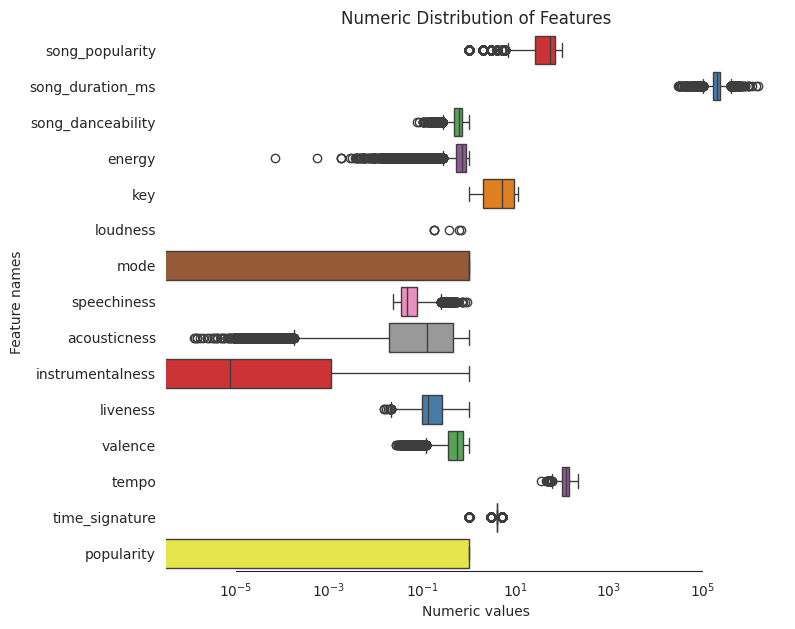

In [ ]:
#Horizontal box plot
sns.set_style("white")
f, ax = plt.subplots(figsize=(8, 7))
ax.set_xscale("log")
ax = sns.boxplot(data=df, orient="h", palette="Set1")
ax.xaxis.grid(False)
ax.set(ylabel="Feature names")
ax.set(xlabel="Numeric values")
ax.set(title="Numeric Distribution of Features")
sns.despine(trim=True, left=True)

- Song_duration_ms, instrumentalness, liveness,  speechiness,tempo has outliers meaning that most of the songs contain instrumental music and are more focused towards lyrics and are of longer duration
Few values in independent variables are very large and not close to zero which makes sense  

- Since there are so much outliers we might  have to remove a big chunk of data which may result into loss of data and we may end up with poor evaluation metrics

### **Question 12: Remove 1%, 5%, and 10% of your data randomly and impute the values back using at least 3 imputation methods. How well did the methods recover the missing values?  That is remove some data, check the % error on residuals for numeric data and check for bias and variance of the error.**

In [ ]:
import numpy as np
import pandas as pd
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.metrics import mean_squared_error



# Function to remove a random percentage of data
def remove_random_data(df, percentage):
    mask = np.random.rand(*df.shape) < percentage
    df_removed = df.copy()
    df_removed[mask] = np.nan
    return df_removed

# Imputation methods
def impute_data(df, strategy):
    # Separate numeric and non-numeric columns
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    non_numeric_cols = df.select_dtypes(exclude=[np.number]).columns

    # Apply imputation only to numeric columns
    if strategy == 'knn':
        imputer = KNNImputer(n_neighbors=5)
    else:
        imputer = SimpleImputer(strategy=strategy)

    # Impute numeric data
    numeric_data_imputed = pd.DataFrame(imputer.fit_transform(df[numeric_cols]), columns=numeric_cols)

    # Combine imputed numeric data with non-numeric data
    imputed_df = pd.concat([numeric_data_imputed, df[non_numeric_cols]], axis=1)
    return imputed_df

# Function to evaluate imputation
def evaluate_imputation(original_df, imputed_df):
    # Select only numeric columns for evaluation
    numeric_cols = original_df.select_dtypes(include=[np.number]).columns

    # Calculate residuals only for numeric data
    original_numeric = original_df[numeric_cols]
    imputed_numeric = imputed_df[numeric_cols]

    residuals = original_numeric - imputed_numeric
    mse = np.nanmean(residuals ** 2)
    bias = np.nanmean(residuals)
    variance = np.nanvar(residuals)
    return mse, bias, variance


# Main analysis
percentages = [0.01, 0.05, 0.1]
strategies = ['mean', 'median', 'knn']

for percentage in percentages:
    removed_df = remove_random_data(df, percentage)
    print(f"--- {percentage * 100}% Data Removal ---")
    for strategy in strategies:
        imputed_df = impute_data(removed_df, strategy)
        mse, bias, variance = evaluate_imputation(df, imputed_df)
        print(f"Strategy: {strategy}, MSE: {mse}, Bias: {bias}, Variance: {variance}")


--- 1.0% Data Removal ---
Strategy: mean, MSE: 2101756.6834331495, Bias: -2.4708884431534277, Variance: 2101750.5781434504
Strategy: median, MSE: 2101521.8006606093, Bias: 2.4326288941303065, Variance: 2101515.882977271
Strategy: knn, MSE: 2180505.8164192913, Bias: -0.935868393020211, Variance: 2180504.9405696425
--- 5.0% Data Removal ---
Strategy: mean, MSE: 14532933.36391968, Bias: -0.9766850156019733, Variance: 14532932.41000606
Strategy: median, MSE: 14712810.801723322, Bias: 24.385730586572077, Variance: 14712216.137867073
Strategy: knn, MSE: 12568191.298033077, Bias: -19.597789324883202, Variance: 12567807.224686647
--- 10.0% Data Removal ---
Strategy: mean, MSE: 29260505.6947845, Bias: 28.514897275089055, Variance: 29259692.595417876
Strategy: median, MSE: 30083196.15096169, Bias: 78.73800139903692, Variance: 30076996.478097383
Strategy: knn, MSE: 25914620.176902834, Bias: 18.31536707875857, Variance: 25914284.724231623


Mean Squared Error (MSE):

MSE measures the average squared difference between the original and imputed values. A lower MSE indicates better imputation performance. Across all data removal percentages (1%, 5%, 10%), the knn method consistently shows the lowest MSE, suggesting it performed the best in terms of accuracy. The mean and median methods have higher MSEs, especially as the percentage of data removal increases, indicating less accuracy. Bias:

Bias measures the average difference between the original and imputed values. A lower absolute value of bias indicates that the imputation method is not systematically overestimating or underestimating the missing values. The knn method shows relatively low bias across all scenarios. The mean method shows minimal bias, but this can be misleading as it tends to average out the errors. The median method exhibits higher bias, particularly with more data removal. Variance:

Variance measures the spread of the residuals. A lower variance indicates that the imputation method is consistently close to the original values across different instances. The knn method again shows relatively low variance, indicating consistent performance. The mean and median methods show higher variance, especially as more data is removed. Overall Assessment: The k-Nearest Neighbors (kNN) imputation method appears to be the most effective among the three, providing the lowest MSE, relatively low bias, and consistent performance (low variance) across different levels of data removal. The mean and median methods are less effective, particularly as the percentage of data removal increases, reflected in their higher MSE and variance. It's important to note that imputation performance can vary based on the nature of the data and the patterns of missingness. In some cases, advanced imputation methods or tailored approaches might be required for optimal results.

### **Question 13.For categorical data, calculate the accuracy and a confusion matrix.**

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix

# Load the dataset

data = spotify_dataset

# Define the target variable and independent variables
target_variable = 'song_popularity'
independent_variables = ['song_duration_ms','song_danceability','energy' ,'key','loudness', 'mode', 'speechiness' ,'acousticness' ,'instrumentalness','liveness','valence', 'tempo', 'time_signature']

# Discretize the target variable into categories
data['song_popularity_Category'] = pd.cut(data[target_variable], bins=3, labels=['Low', 'Medium', 'High'])

# Split the data into train and test sets
X = data[independent_variables]
y = data['song_popularity_Category']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Random Forest Classifier
classifier = RandomForestClassifier(random_state=42)
classifier.fit(X_train, y_train)

# Predict the target variable on the test set
y_pred = classifier.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Create a confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix)


Accuracy: 0.73325
Confusion Matrix:
[[1040   67  199]
 [ 115  825  283]
 [ 267  136 1068]]


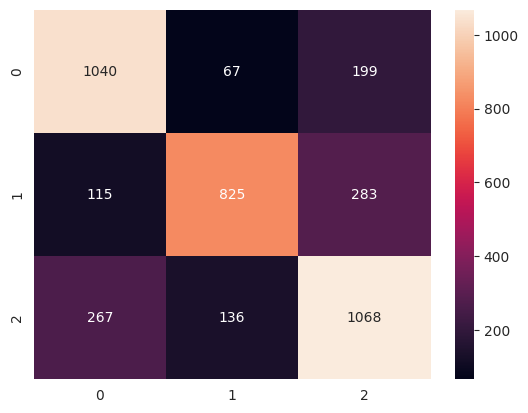

In [ ]:
sns.heatmap(conf_matrix,annot=True,fmt="d")
plt.show()

# **2. AUTO ML**

In [ ]:
!pip3 install h2o

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.6/265.6 MB 5.4 MB/s eta 0:00:00


In [ ]:

!pip install requests
!pip install tabulate
!pip install "colorama>=0.3.8"
!pip install future

In [ ]:
import h2o
from h2o.automl import H2OAutoML
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import warnings
import seaborn as sns
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split

In [ ]:
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmplba4tl2h
  JVM stdout: /tmp/tmplba4tl2h/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmplba4tl2h/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,10 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,19 days
H2O_cluster_name:,H2O_from_python_unknownUser_6uz73e
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [ ]:
df=pd.read_csv("https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/song_data1.csv")
df2=pd.read_csv("https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/song_info2.csv")

In [ ]:
# Label Encoding for 'song_genre'
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df2['song_genre_encoded'] = le.fit_transform(df2['song_genre'])

In [ ]:
# Frequency Encoding for 'artist_name', 'album_name', and 'song_name'
for column in ['artist_name', 'album_name', 'song_name']:
    freq = df2[column].value_counts(normalize=True)  # Get frequency of each category
    df2[column + '_freq'] = df2[column].map(freq)

In [ ]:
df2.head()

,artist_name,album_name,song_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
0,Gen Hoshino,Comedy,Comedy,acoustic,0,0.00010,0.00010,0.00010
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,acoustic,0,0.00005,0.00005,0.00005
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,acoustic,0,0.00005,0.00005,0.00005
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,acoustic,0,0.00005,0.00005,0.00020
4,Chord Overstreet,Hold On,Hold On,acoustic,0,0.00005,0.00005,0.00020


In [ ]:
df2.drop(columns=["song_name"],axis=1,inplace=True)

In [ ]:
df2

,artist_name,album_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
0,Gen Hoshino,Comedy,acoustic,0,0.00010,0.00010,0.00010
1,Ben Woodward,Ghost (Acoustic),acoustic,0,0.00005,0.00005,0.00005
2,Ingrid Michaelson;ZAYN,To Begin Again,acoustic,0,0.00005,0.00005,0.00005
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,acoustic,0,0.00005,0.00005,0.00020
4,Chord Overstreet,Hold On,acoustic,0,0.00005,0.00005,0.00020
...,...,...,...,...,...,...,...
19994,Elvis Presley,Elvis 30 #1 Hits (Expanded Edition),rockabilly,81,0.00835,0.00085,0.00005
19995,Ray Peterson,Missing You,rockabilly,81,0.00015,0.00010,0.00005
19996,Neil Sedaka,Collections,rockabilly,81,0.00035,0.00005,0.00015
19997,Eikichi Yazawa,ÊÉÖ‰∫ã (50th Anniversary Remastered),rockabilly,81,0.00335,0.00015,0.00005


In [ ]:
frames=[df,df2]
spotify= pd.concat([df,df2], axis=1)
spotify

,song_name,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,...,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
0,Comedy,73,230666,0.676,0.4610,1,-6.746,0,0.1430,0.03220,...,0.715,87.917,4,Gen Hoshino,Comedy,acoustic,0,0.00010,0.00010,0.00010
1,Ghost - Acoustic,55,149610,0.420,0.1660,1,-17.235,1,0.0763,0.92400,...,0.267,77.489,4,Ben Woodward,Ghost (Acoustic),acoustic,0,0.00005,0.00005,0.00005
2,To Begin Again,57,210826,0.438,0.3590,0,-9.734,1,0.0557,0.21000,...,0.120,76.332,4,Ingrid Michaelson;ZAYN,To Begin Again,acoustic,0,0.00005,0.00005,0.00005
3,Can't Help Falling In Love,71,201933,0.266,0.0596,0,-18.515,1,0.0363,0.90500,...,0.143,181.740,3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,acoustic,0,0.00005,0.00005,0.00020
4,Hold On,82,198853,0.618,0.4430,2,-9.681,1,0.0526,0.46900,...,0.167,119.949,4,Chord Overstreet,Hold On,acoustic,0,0.00005,0.00005,0.00020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19994,(Now and Then There's) A Fool Such as I,52,159360,0.574,0.7140,0,-6.344,1,0.0403,0.90100,...,0.722,63.623,4,Elvis Presley,Elvis 30 #1 Hits (Expanded Edition),rockabilly,81,0.00835,0.00085,0.00005
19995,"Corrina, Corrina",47,162160,0.481,0.4130,9,-8.688,1,0.0326,0.79800,...,0.681,127.591,4,Ray Peterson,Missing You,rockabilly,81,0.00015,0.00010,0.00005
19996,Oh! Carol,46,135773,0.584,0.7430,8,-7.039,0,0.0463,0.76600,...,0.815,132.747,4,Neil Sedaka,Collections,rockabilly,81,0.00035,0.00005,0.00015
19997,ÊôÇË®à‰ªïÊéõ„Åë„ÅÆÊó•„ÄÖ - Remastered 2022,22,227093,0.637,0.9540,9,-7.604,0,0.0448,0.34400,...,0.883,128.124,4,Eikichi Yazawa,ÊÉÖ‰∫ã (50th Anniversary Remastered),rockabilly,81,0.00335,0.00015,0.00005


In [ ]:
spotify["popularity"]= [ 1 if i>=66.5 else 0 for i in spotify.song_popularity ]
spotify["popularity"].value_counts()

0    13226
1     6773
Name: popularity, dtype: int64

In [ ]:
spotify = spotify.drop("song_popularity",axis=1)

In [ ]:
spotify_train, spotify_test = train_test_split(spotify, test_size=0.2, random_state=25)

In [ ]:
spotify_test

,song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,...,tempo,time_signature,artist_name,album_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq,popularity
577,Cigarette Daydreams,208760,0.636,0.676,2,-3.442,1,0.0263,0.080700,0.000000,...,113.980,4,Cage The Elephant,Melophobia,blues,7,0.00125,0.00050,0.00020,1
16745,Criminal,232549,0.814,0.813,2,-3.023,0,0.0561,0.030000,0.000093,...,79.997,4,Natti Natasha;Ozuna,Criminal,reggaeton,78,0.00015,0.00015,0.00025,1
9446,Things,165720,0.416,0.606,6,-8.296,0,0.0286,0.066700,0.003570,...,147.178,4,The Lemonheads,Varshons 2,power-pop,71,0.00175,0.00015,0.00005,0
16322,Easy,239373,0.853,0.777,1,-4.025,0,0.0689,0.097200,0.000501,...,94.023,4,Jhayco,Perreo Tenebroso Vol. 3,reggaeton,78,0.00150,0.00180,0.00035,0
8047,MIDDLE OF THE NIGHT,184447,0.410,0.611,4,-8.271,0,0.0467,0.022800,0.000000,...,185.727,3,Elley Duh√©,MIDDLE OF THE NIGHT,pop,69,0.00005,0.00010,0.00015,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19692,Bachelor Boy,122200,0.413,0.499,2,-10.709,1,0.0332,0.639000,0.000000,...,200.541,3,Cliff Richard & The Shadows,40 Golden Greats,rockabilly,81,0.00040,0.00025,0.00010,0
4924,Churchill Downs (feat. Drake),309327,0.710,0.522,11,-9.102,1,0.3600,0.615000,0.000000,...,96.448,4,Jack Harlow;Drake,Come Home The Kids Miss You,k-pop,55,0.00005,0.00010,0.00005,1
14343,Rei Sem Nome (Meruem),384347,0.532,0.639,1,-8.823,0,0.0418,0.151000,0.000000,...,137.971,4,Enygma Rapper,Rei Sem Nome (Meruem),r-n-b,76,0.00040,0.00005,0.00005,0
5566,Ausl√§nder,231603,0.681,0.912,0,-4.159,1,0.0912,0.000757,0.001360,...,125.031,4,Rammstein,Rammstein,metal,60,0.00170,0.00045,0.00010,1


In [ ]:
X_train = spotify_train.drop("popularity",axis=1)
X_train

,song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,...,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
13043,The Foundations of Decay,360760,0.363,0.670,1,-6.652,0,0.0552,0.000582,0.548000,...,0.1980,150.150,4,My Chemical Romance,Rock - Best of 2022,punk,74,0.00175,0.00050,0.00030
2957,Shine,306040,0.543,0.423,6,-8.797,1,0.0282,0.295000,0.086200,...,0.3550,150.132,4,Collective Soul,"Hints, Allegations & Things Left Unsaid",grunge,39,0.00005,0.00005,0.00005
18828,Transito Lento,194080,0.704,0.533,9,-6.940,0,0.0315,0.587000,0.000016,...,0.6950,94.056,4,Andr√©s Calamaro,M√∫sica para casa,rock,79,0.00025,0.00025,0.00005
12230,Percayalah - Bonus Track,208823,0.449,0.785,2,-5.664,1,0.0391,0.099300,0.000000,...,0.4170,169.940,4,Last Child,Our Biggest Thing Ever,punk-rock,75,0.00110,0.00080,0.00010
7278,"Ratchasa Maamaney (From ""Ponniyin Selvan Part-1"")",289942,0.546,0.786,4,-9.486,1,0.2120,0.349000,0.000001,...,0.4340,99.798,3,A.R. Rahman;Shreya Ghoshal;Palakad Sreeram;Mah...,"Ratchasa Maamaney (From ""Ponniyin Selvan Part-...",pop-film,70,0.00005,0.00005,0.00005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7324,Likhe Jo Khat Tujhe,132571,0.773,0.624,2,-7.615,0,0.0520,0.010600,0.000004,...,0.4310,105.044,4,Raj Barman,Likhe Jo Khat Tujhe - Raj Barman,pop-film,70,0.00015,0.00005,0.00010
1160,Se√±orita,190799,0.759,0.548,9,-6.049,0,0.0290,0.039200,0.000000,...,0.7490,116.967,4,Shawn Mendes;Camila Cabello,Shawn Mendes (Deluxe),dance,19,0.00020,0.00010,0.00020
1175,Light Switch,187703,0.690,0.626,6,-5.693,1,0.3060,0.105000,0.000335,...,0.9120,184.009,4,Charlie Puth,Light Switch (Instrumental),dance,19,0.00100,0.00005,0.00015
2934,Someday,207466,0.455,0.858,11,-5.659,0,0.0391,0.000616,0.000247,...,0.5970,163.118,4,Nickelback,The Long Road,grunge,39,0.00135,0.00010,0.00030


In [ ]:
x=list(X_train.columns)
x

['song_name',
 'song_duration_ms',
 'song_danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'artist_name',
 'album_name',
 'song_genre',
 'song_genre_encoded',
 'artist_name_freq',
 'album_name_freq',
 'song_name_freq']

In [ ]:
X_test = spotify_test.drop("popularity",axis=1)
X_test

,song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,...,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
577,Cigarette Daydreams,208760,0.636,0.676,2,-3.442,1,0.0263,0.080700,0.000000,...,0.2730,113.980,4,Cage The Elephant,Melophobia,blues,7,0.00125,0.00050,0.00020
16745,Criminal,232549,0.814,0.813,2,-3.023,0,0.0561,0.030000,0.000093,...,0.8390,79.997,4,Natti Natasha;Ozuna,Criminal,reggaeton,78,0.00015,0.00015,0.00025
9446,Things,165720,0.416,0.606,6,-8.296,0,0.0286,0.066700,0.003570,...,0.5830,147.178,4,The Lemonheads,Varshons 2,power-pop,71,0.00175,0.00015,0.00005
16322,Easy,239373,0.853,0.777,1,-4.025,0,0.0689,0.097200,0.000501,...,0.5550,94.023,4,Jhayco,Perreo Tenebroso Vol. 3,reggaeton,78,0.00150,0.00180,0.00035
8047,MIDDLE OF THE NIGHT,184447,0.410,0.611,4,-8.271,0,0.0467,0.022800,0.000000,...,0.0899,185.727,3,Elley Duh√©,MIDDLE OF THE NIGHT,pop,69,0.00005,0.00010,0.00015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19692,Bachelor Boy,122200,0.413,0.499,2,-10.709,1,0.0332,0.639000,0.000000,...,0.8520,200.541,3,Cliff Richard & The Shadows,40 Golden Greats,rockabilly,81,0.00040,0.00025,0.00010
4924,Churchill Downs (feat. Drake),309327,0.710,0.522,11,-9.102,1,0.3600,0.615000,0.000000,...,0.3700,96.448,4,Jack Harlow;Drake,Come Home The Kids Miss You,k-pop,55,0.00005,0.00010,0.00005
14343,Rei Sem Nome (Meruem),384347,0.532,0.639,1,-8.823,0,0.0418,0.151000,0.000000,...,0.3570,137.971,4,Enygma Rapper,Rei Sem Nome (Meruem),r-n-b,76,0.00040,0.00005,0.00005
5566,Ausl√§nder,231603,0.681,0.912,0,-4.159,1,0.0912,0.000757,0.001360,...,0.4790,125.031,4,Rammstein,Rammstein,metal,60,0.00170,0.00045,0.00010


In [ ]:
spotify_train

,song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,...,tempo,time_signature,artist_name,album_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq,popularity
13043,The Foundations of Decay,360760,0.363,0.670,1,-6.652,0,0.0552,0.000582,0.548000,...,150.150,4,My Chemical Romance,Rock - Best of 2022,punk,74,0.00175,0.00050,0.00030,0
2957,Shine,306040,0.543,0.423,6,-8.797,1,0.0282,0.295000,0.086200,...,150.132,4,Collective Soul,"Hints, Allegations & Things Left Unsaid",grunge,39,0.00005,0.00005,0.00005,1
18828,Transito Lento,194080,0.704,0.533,9,-6.940,0,0.0315,0.587000,0.000016,...,94.056,4,Andr√©s Calamaro,M√∫sica para casa,rock,79,0.00025,0.00025,0.00005,0
12230,Percayalah - Bonus Track,208823,0.449,0.785,2,-5.664,1,0.0391,0.099300,0.000000,...,169.940,4,Last Child,Our Biggest Thing Ever,punk-rock,75,0.00110,0.00080,0.00010,0
7278,"Ratchasa Maamaney (From ""Ponniyin Selvan Part-1"")",289942,0.546,0.786,4,-9.486,1,0.2120,0.349000,0.000001,...,99.798,3,A.R. Rahman;Shreya Ghoshal;Palakad Sreeram;Mah...,"Ratchasa Maamaney (From ""Ponniyin Selvan Part-...",pop-film,70,0.00005,0.00005,0.00005,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7324,Likhe Jo Khat Tujhe,132571,0.773,0.624,2,-7.615,0,0.0520,0.010600,0.000004,...,105.044,4,Raj Barman,Likhe Jo Khat Tujhe - Raj Barman,pop-film,70,0.00015,0.00005,0.00010,0
1160,Se√±orita,190799,0.759,0.548,9,-6.049,0,0.0290,0.039200,0.000000,...,116.967,4,Shawn Mendes;Camila Cabello,Shawn Mendes (Deluxe),dance,19,0.00020,0.00010,0.00020,1
1175,Light Switch,187703,0.690,0.626,6,-5.693,1,0.3060,0.105000,0.000335,...,184.009,4,Charlie Puth,Light Switch (Instrumental),dance,19,0.00100,0.00005,0.00015,1
2934,Someday,207466,0.455,0.858,11,-5.659,0,0.0391,0.000616,0.000247,...,163.118,4,Nickelback,The Long Road,grunge,39,0.00135,0.00010,0.00030,1


In [ ]:
spotify_train.to_csv('spotify_train.csv', index=False)
spotify_test.to_csv('spotify_test.csv', index=False)


In [ ]:
from google.colab import files

files.download('spotify_train.csv')
files.download('spotify_test.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
spotify_train = h2o.import_file('https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/spotify_train.csv')
spotify_test = h2o.import_file('https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/spotify_test.csv')

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
spotify_test

song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_label,song_name_freq,popularity
Cigarette Daydreams,208760,0.636,0.676,2,-3.442,1,0.0263,0.0807,0,0.0831,0.273,113.98,4,60.7222,53.6398,blues,7,0.00020001,1
Criminal,232549,0.814,0.813,2,-3.023,0,0.0561,0.03,9.33e-05,0.255,0.839,79.997,4,50.886,50.886,reggaeton,78,0.000250013,1
Things,165720,0.416,0.606,6,-8.296,0,0.0286,0.0667,0.00357,0.12,0.583,147.178,4,28.9186,42.6479,power-pop,71,5.00025e-05,0
Easy,239373,0.853,0.777,1,-4.025,0,0.0689,0.0972,0.000501,0.332,0.555,94.023,4,12.8661,7.80792,reggaeton,78,0.000350018,0
MIDDLE OF THE NIGHT,184447,0.41,0.611,4,-8.271,0,0.0467,0.0228,0,0.116,0.0899,185.727,3,52.143,51.3064,pop,69,0.000150008,1
Christian Dior,147133,0.835,0.718,7,-5.62,0,0.0694,0.226,1.99e-06,0.108,0.427,92.028,4,12.8661,9.95456,reggaeton,78,0.000500025,0
Ladioo - Arena-Hitmix,236026,0.499,0.989,11,-2.363,1,0.093,0.138,4.5e-06,0.433,0.196,137.008,4,41.4217,43.3628,party,67,0.000100005,0
Fried Chicken And Gasoline,257306,0.593,0.917,11,-5.529,0,0.0275,0.0293,0.606,0.265,0.939,135.275,4,42.3634,43.4337,psych-rock,73,0.000100005,0
Kiya Kiya,302210,0.703,0.867,11,-6.721,1,0.0334,0.0944,2.55e-06,0.0675,0.904,120.013,4,48.6301,48.6301,pop-film,70,5.00025e-05,0
Pantysito,240413,0.83,0.739,7,-5.395,0,0.0627,0.136,2.11e-06,0.162,0.631,97.993,4,25.3227,2.86307,reggaeton,78,0.00110006,0


In [ ]:
X_train = spotify_train.drop("popularity",axis=1)
X_train

song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_label,song_name_freq
The Foundations of Decay,360760,0.363,0.67,1,-6.652,0,0.0552,0.000582,0.548,0.317,0.198,150.15,4,56.6928,35.0021,punk,74,0.000300015
Shine,306040,0.543,0.423,6,-8.797,1,0.0282,0.295,0.0862,0.152,0.355,150.132,4,49.5408,49.5408,grunge,39,5.00025e-05
Transito Lento,194080,0.704,0.533,9,-6.94,0,0.0315,0.587,1.64e-05,0.254,0.695,94.056,4,38.0015,38.0015,rock,79,5.00025e-05
Percayalah - Bonus Track,208823,0.449,0.785,2,-5.664,1,0.0391,0.0993,0,0.238,0.417,169.94,4,46.2414,46.3129,punk-rock,75,0.000100005
"Ratchasa Maamaney (From ""Ponniyin Selvan Part-1"")",289942,0.546,0.786,4,-9.486,1,0.212,0.349,1.35e-06,0.109,0.434,99.798,3,48.7602,48.7602,pop-film,70,5.00025e-05
Hey Mor,196600,0.901,0.589,1,-6.713,0,0.289,0.00302,0.000237,0.0992,0.399,98.002,4,52.3202,50.5263,latin,56,0.000300015
Dancing In The Dark,244680,0.629,0.486,8,-8.198,1,0.0305,0.497,0,0.117,0.382,122.011,4,32.1997,35.8374,rock,79,5.00025e-05
Hey Jude - Remastered 2009,431333,0.402,0.552,10,-10.158,1,0.0258,0.028,1.36e-05,0.0929,0.668,145.164,4,62.3098,49.6337,psych-rock,73,5.00025e-05
Remember (feat. Stevie Appleton),199967,0.655,0.89,5,-6.434,0,0.0611,0.101,0.0149,0.488,0.328,127.979,4,49.3914,49.3914,groove,38,0.000100005
Euphor,243466,0.296,0.284,10,-14.01,0,0.033,0.968,0.189,0.0961,0.0917,114.786,4,50.3699,50.3699,folk,32,0.000100005


In [ ]:
X=X_train.col_names
X

['song_name',
 'song_duration_ms',
 'song_danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'artist_name',
 'album_name',
 'song_genre',
 'song_genre_label',
 'song_name_freq']

In [ ]:
x=list(X_train.columns)
x

['song_name',
 'song_duration_ms',
 'song_danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'artist_name',
 'album_name',
 'song_genre',
 'song_genre_label',
 'song_name_freq']

In [ ]:
X_test = spotify_test.drop("popularity",axis=1)
X_test

song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_label,song_name_freq
Cigarette Daydreams,208760,0.636,0.676,2,-3.442,1,0.0263,0.0807,0,0.0831,0.273,113.98,4,60.7222,53.6398,blues,7,0.00020001
Criminal,232549,0.814,0.813,2,-3.023,0,0.0561,0.03,9.33e-05,0.255,0.839,79.997,4,50.886,50.886,reggaeton,78,0.000250013
Things,165720,0.416,0.606,6,-8.296,0,0.0286,0.0667,0.00357,0.12,0.583,147.178,4,28.9186,42.6479,power-pop,71,5.00025e-05
Easy,239373,0.853,0.777,1,-4.025,0,0.0689,0.0972,0.000501,0.332,0.555,94.023,4,12.8661,7.80792,reggaeton,78,0.000350018
MIDDLE OF THE NIGHT,184447,0.41,0.611,4,-8.271,0,0.0467,0.0228,0,0.116,0.0899,185.727,3,52.143,51.3064,pop,69,0.000150008
Christian Dior,147133,0.835,0.718,7,-5.62,0,0.0694,0.226,1.99e-06,0.108,0.427,92.028,4,12.8661,9.95456,reggaeton,78,0.000500025
Ladioo - Arena-Hitmix,236026,0.499,0.989,11,-2.363,1,0.093,0.138,4.5e-06,0.433,0.196,137.008,4,41.4217,43.3628,party,67,0.000100005
Fried Chicken And Gasoline,257306,0.593,0.917,11,-5.529,0,0.0275,0.0293,0.606,0.265,0.939,135.275,4,42.3634,43.4337,psych-rock,73,0.000100005
Kiya Kiya,302210,0.703,0.867,11,-6.721,1,0.0334,0.0944,2.55e-06,0.0675,0.904,120.013,4,48.6301,48.6301,pop-film,70,5.00025e-05
Pantysito,240413,0.83,0.739,7,-5.395,0,0.0627,0.136,2.11e-06,0.162,0.631,97.993,4,25.3227,2.86307,reggaeton,78,0.00110006


In [ ]:
y='popularity'

AutoML, or Automated Machine Learning, is a process of automating the process of machine learning, including the selection of the best algorithms, hyperparameters, and feature engineering. AutoML systems aim to simplify the process of creating and deploying machine learning models by automating much of the process.

AutoML systems use a combination of optimization algorithms, statistical methods, and machine learning techniques to automatically search for the best model, tuning the model's parameters and selecting the best features to use. This can save data scientists and machine learning engineers a lot of time and effort, and it can also make machine learning more accessible to people with less experience in the field.

AutoML can be used in a wide variety of applications, including natural language processing, image recognition, and predictive analytics. Many companies are now offering AutoML platforms, and these platforms can be used by data scientists, developers, and other professionals to build machine learning models quickly and easily.

H2O.ai is a popular open-source platform for building machine learning models, and it includes an AutoML feature that can automate much of the machine learning process. H2O's AutoML automates the process of building a large number of models with different algorithms and hyperparameters, and it selects the best model based on the specified evaluation metric.

H2O's AutoML supports a wide variety of machine learning algorithms, including linear and logistic regression, gradient boosting machines, deep learning, and others. It also supports data preprocessing steps like feature engineering, missing value imputation, and outlier detection.

To use H2O's AutoML, a user only needs to specify the target variable, the training dataset, and the evaluation metric. H2O will then train a variety of models and return the best-performing model. H2O also provides tools for model interpretation and explainability, which can help data scientists and business analysts understand how the model is making predictions.

H2O's AutoML can be used for a variety of applications, including fraud detection, predictive maintenance, and customer churn analysis. It can also be used in industries like finance, healthcare, and marketing, where predictive analytics are increasingly important.

**max_models=15:** This parameter tells H2OAutoML to train a maximum of 15 different models. The AutoML process will stop after the fifteenth model has been trained.

**seed=10:** This sets the random seed for reproducibility. Using a seed ensures that the model training process is deterministic, meaning you'll get the same results each time you run the code with the same dataset and parameters.

**verbosity="debug":** This sets the verbosity level of the training process. A value of "debug" will output more detailed progress and diagnostic messages that can help in understanding the internal process or for debugging.

**nfolds=0:** This specifies the number of folds for cross-validation. Setting it to 0 means that cross-validation is not used. Instead, the validation set will be used for model evaluation. If nfolds is set to a number greater than 1, H2OAutoML will use that number of folds for cross-validation to evaluate model performance.

In [ ]:
aml = H2OAutoML(max_models=15,seed=10,verbosity="debug",nfolds=0)
aml.train(x=x, y=y, training_frame=spotify_train)

AutoML progress: |
22:54:34.700: Project: AutoML_1_20240401_225434
22:54:34.701: Cross-validation disabled by user: no fold column nor nfolds > 1.
22:54:34.702: Setting stopping tolerance adaptively based on the training frame: 0.007906682547518067
22:54:34.702: Build control seed: 10
22:54:34.721: Since cross-validation is disabled, and validation frame(s) were not provided, automatically split the training data into training, validation frame(s) in the ratio 90/10/0.
22:54:35.201: training frame: Frame key: AutoML_1_20240401_225434_training_spotify_train.hex    cols: 20    rows: 14429  chunks: 8    size: 2557486  checksum: 7894776584054173376
22:54:35.213: validation frame: Frame key: AutoML_1_20240401_225434_validation_spotify_train.hex    cols: 20    rows: 1567  chunks: 8    size: 1267134  checksum: -2998590867568669120
22:54:35.213: leaderboard frame: Frame key: AutoML_1_20240401_225434_validation_spotify_train.hex    cols: 20    rows: 1567  chunks: 8    size: 1267134  checksum: -

Model Details
=============
H2OXGBoostEstimator : XGBoost
Model Key: XGBoost_grid_1_AutoML_1_20240401_225434_model_2


Model Summary: 
    number_of_trees
--  -----------------
    55

ModelMetricsRegression: xgboost
** Reported on train data. **

MSE: 0.0015491797640006673
RMSE: 0.03935962098395597
MAE: 0.017453573347871565
RMSLE: 0.029727774023264243
Mean Residual Deviance: 0.0015491797640006673

ModelMetricsRegression: xgboost
** Reported on validation data. **

MSE: 0.017445866654545995
RMSE: 0.13208280226640406
MAE: 0.05122529885609483
RMSLE: 0.09166014837715457
Mean Residual Deviance: 0.017445866654545995

Scoring History: 
    timestamp            duration    number_of_trees    training_rmse    training_mae    training_deviance    validation_rmse    validation_mae    validation_deviance
--  -------------------  ----------  -----------------  ---------------  --------------  -------------------  -----------------  ----------------  ---------------------
    2024-04-01 22:59:29  24.958 sec  0                  0.5              0.5             0.25                 0.5                0.5               0.25
    2024-04-01 22:59:32  28.463 sec  5                  0.145649         0.116348        0.0212136            0.173106           0.127646          0.0299657
    2024-04-01 22:59:35  30.964 sec  10                 0.0950465        0.0425294       0.00903384           0.142701           0.0603134         0.0203636
    2024-04-01 22:59:37  32.695 sec  15                 0.0811185        0.0302812       0.00658021           0.138841           0.0516414         0.0192769
    2024-04-01 22:59:38  34.253 sec  20                 0.0700736        0.0270248       0.0049103            0.135498           0.0509203         0.0183596
    2024-04-01 22:59:39  34.621 sec  25                 0.0653234        0.0259588       0.00426715           0.134096           0.0508752         0.0179817
    2024-04-01 22:59:39  35.491 sec  30                 0.0595061        0.0244731       0.00354098           0.13284            0.0511634         0.0176465
    2024-04-01 22:59:40  35.940 sec  35                 0.0540831        0.0226961       0.00292498           0.132025           0.051236          0.0174307
    2024-04-01 22:59:40  36.353 sec  40                 0.0491101        0.0210001       0.0024118            0.131886           0.0513617         0.017394
    2024-04-01 22:59:41  36.757 sec  45                 0.046003         0.01989         0.00211627           0.131739           0.0515216         0.0173552
    2024-04-01 22:59:41  37.182 sec  50                 0.0422782        0.0185424       0.00178744           0.131954           0.051363          0.0174118
    2024-04-01 22:59:42  37.605 sec  55                 0.0393596        0.0174536       0.00154918           0.132083           0.0512253         0.0174459

Variable Importances: 
variable                                          relative_importance     scaled_importance       percentage
------------------------------------------------  ----------------------  ----------------------  ----------------------
album_name                                        4986.50146484375        1.0                     0.79465293070229
artist_name                                       318.2562561035156       0.06382355612393027     0.05071757592172329
song_name_freq                                    161.01174926757812      0.032289522103373804    0.02565896337042237
song_genre_label                                  160.22982788085938      0.032132714491417504    0.025534355742024867
song_genre.psych-rock                             100.04450988769531      0.020063066378910643    0.015943174496875927
speechiness                                       59.51993179321289       0.011936210630407972    0.009485144758933525
song_genre.pop-film                               52.40283966064453       0.010508938988607427    0.008350959165868452
liveness                                          50.01471328735351

Here is the breakdown of the parameters:

x=x: This parameter specifies the predictor variables (features) in the dataset. In this context, x should be a list of column names in spotify_train that are used as input features for the model.

y=y: This parameter indicates the name of the target variable (response) in the dataset that you're trying to predict. The y should be the column name in spotify_train that you're modeling.

training_frame=spotify_train: This parameter is the H2O Frame (similar to a pandas DataFrame, but for the H2O environment) that contains the training data.

In summary, this line will tell the H2O AutoML instance aml to train models using the columns listed in x as features to predict the target y, using the data provided in training_frame. The AutoML process will automatically select the best algorithms and hyperparameters to fit models to the data, trying to optimize the prediction for the target variable.



In [ ]:
ranking = aml.leaderboard
print(ranking)

model_id                                             rmse        mse        mae      rmsle    mean_residual_deviance
XGBoost_grid_1_AutoML_1_20240401_225434_model_2  0.132083  0.0174459  0.0512253  0.0916601                 0.0174459
XGBoost_grid_1_AutoML_1_20240401_225434_model_1  0.134068  0.0179741  0.0602421  0.0935666                 0.0179741
XGBoost_2_AutoML_1_20240401_225434               0.135632  0.0183959  0.0555854  0.0936683                 0.0183959
XGBoost_1_AutoML_1_20240401_225434               0.137115  0.0188005  0.0603573  0.0941439                 0.0188005
XGBoost_3_AutoML_1_20240401_225434               0.137481  0.0189012  0.0520636  0.0986154                 0.0189012
GBM_5_AutoML_1_20240401_225434                   0.141261  0.0199545  0.0524823  0.0995972                 0.0199545
GBM_3_AutoML_1_20240401_225434                   0.141472  0.0200143  0.053611   0.0992056                 0.0200143
GBM_2_AutoML_1_20240401_225434                   0.14153   0.020

In [ ]:
predictions1 = aml.leader.predict(X_test)


xgboost prediction progress: |███████████████████████████████████████████████████| (done) 100%


In [ ]:
best_model = aml.get_best_model()
print(best_model)

Model Details
H2OXGBoostEstimator : XGBoost
Model Key: XGBoost_grid_1_AutoML_1_20240401_225434_model_2


Model Summary: 
    number_of_trees
--  -----------------
    55

ModelMetricsRegression: xgboost
** Reported on train data. **

MSE: 0.0015491797640006673
RMSE: 0.03935962098395597
MAE: 0.017453573347871565
RMSLE: 0.029727774023264243
Mean Residual Deviance: 0.0015491797640006673

ModelMetricsRegression: xgboost
** Reported on validation data. **

MSE: 0.017445866654545995
RMSE: 0.13208280226640406
MAE: 0.05122529885609483
RMSLE: 0.09166014837715457
Mean Residual Deviance: 0.017445866654545995

Scoring History: 
    timestamp            duration    number_of_trees    training_rmse    training_mae    training_deviance    validation_rmse    validation_mae    validation_deviance
--  -------------------  ----------  -----------------  ---------------  --------------  -------------------  -----------------  ----------------  ---------------------
    2024-04-01 22:59:29  24.958 sec  0  

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
XGBoost_grid_1_AutoML_1_20240401_225434_model_2,0.136871,0.0187337,0.0521449,0.095623,0.0187337,12945,0.012197,XGBoost
XGBoost_1_AutoML_1_20240401_225434,0.137974,0.0190369,0.0593637,0.0961461,0.0190369,68983,0.023903,XGBoost
XGBoost_grid_1_AutoML_1_20240401_225434_model_1,0.144152,0.0207799,0.06187,0.099761,0.0207799,24853,0.0179,XGBoost
XGBoost_2_AutoML_1_20240401_225434,0.146213,0.0213782,0.0576141,0.101071,0.0213782,6272,0.010944,XGBoost
GBM_5_AutoML_1_20240401_225434,0.148018,0.0219092,0.0522095,0.104075,0.0219092,5252,0.047269,GBM
GBM_4_AutoML_1_20240401_225434,0.148867,0.0221613,0.0528965,0.104176,0.0221613,4464,0.10919,GBM
GBM_3_AutoML_1_20240401_225434,0.150298,0.0225894,0.0534538,0.105166,0.0225894,3563,0.045407,GBM
GBM_2_AutoML_1_20240401_225434,0.15182,0.0230492,0.0531469,0.10623,0.0230492,2881,0.096641,GBM
XGBoost_3_AutoML_1_20240401_225434,0.152326,0.0232032,0.0534804,0.107583,0.0232032,22865,0.007727,XGBoost
DRF_1_AutoML_1_20240401_225434,0.159041,0.0252941,0.0596362,0.111835,0.0252941,7140,0.035541,DRF


# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

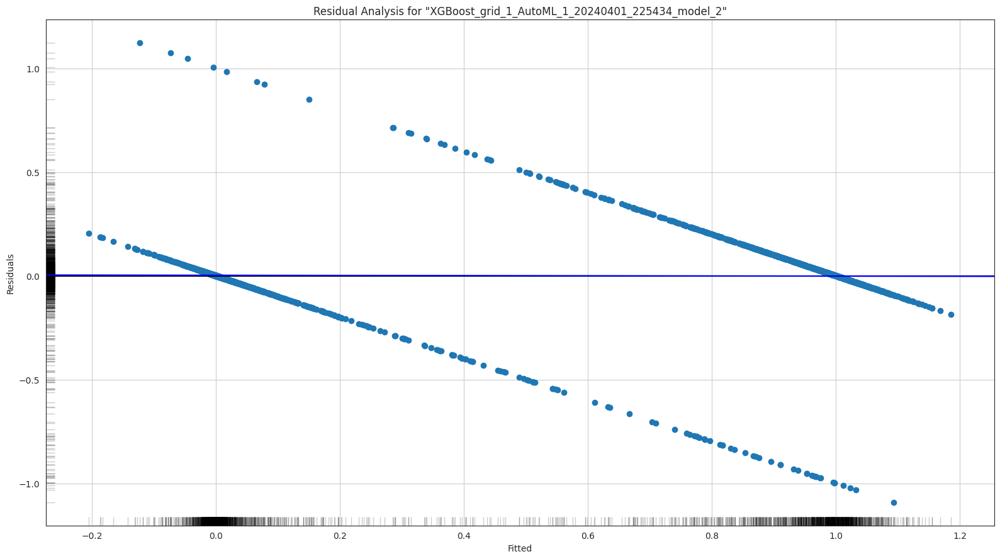

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

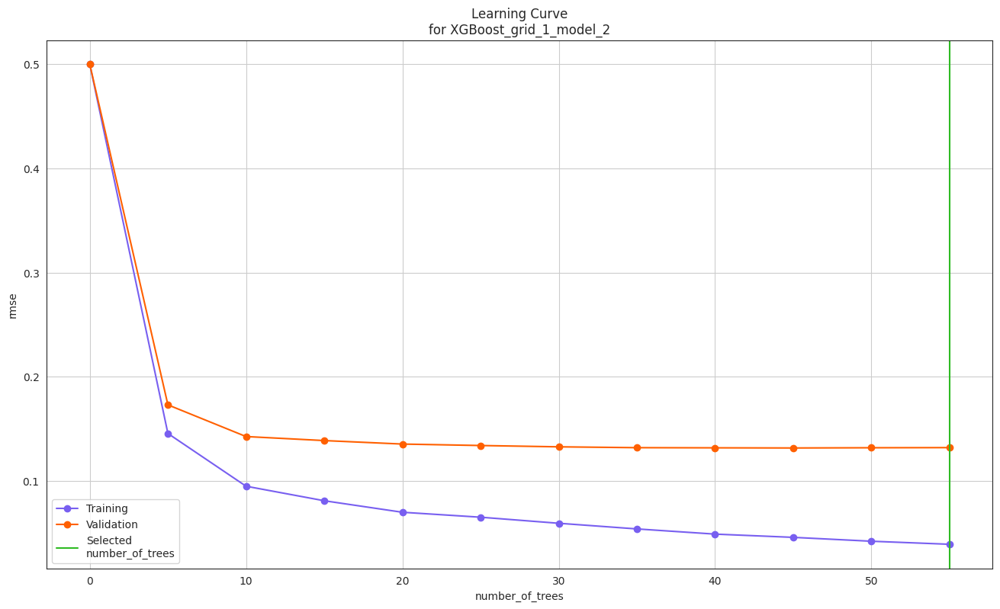

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

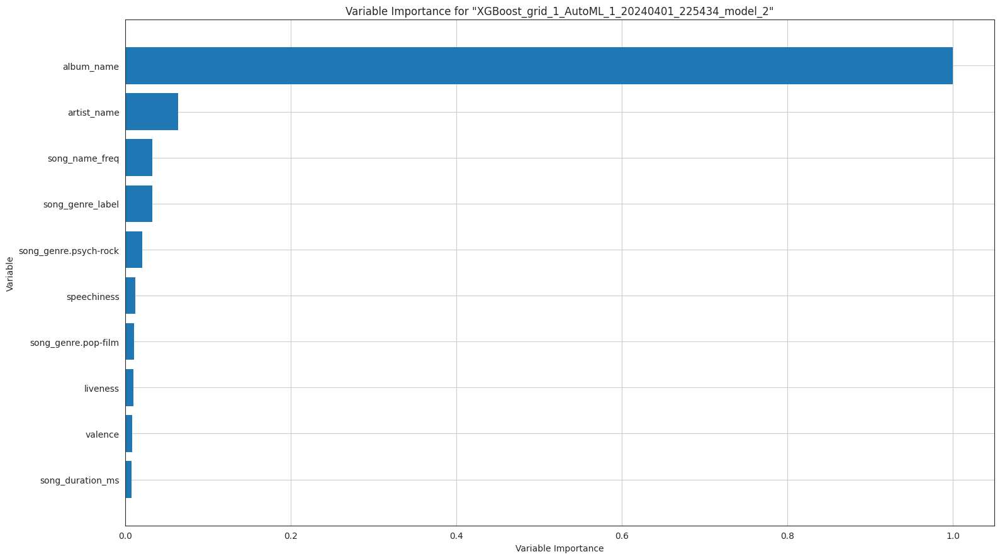

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

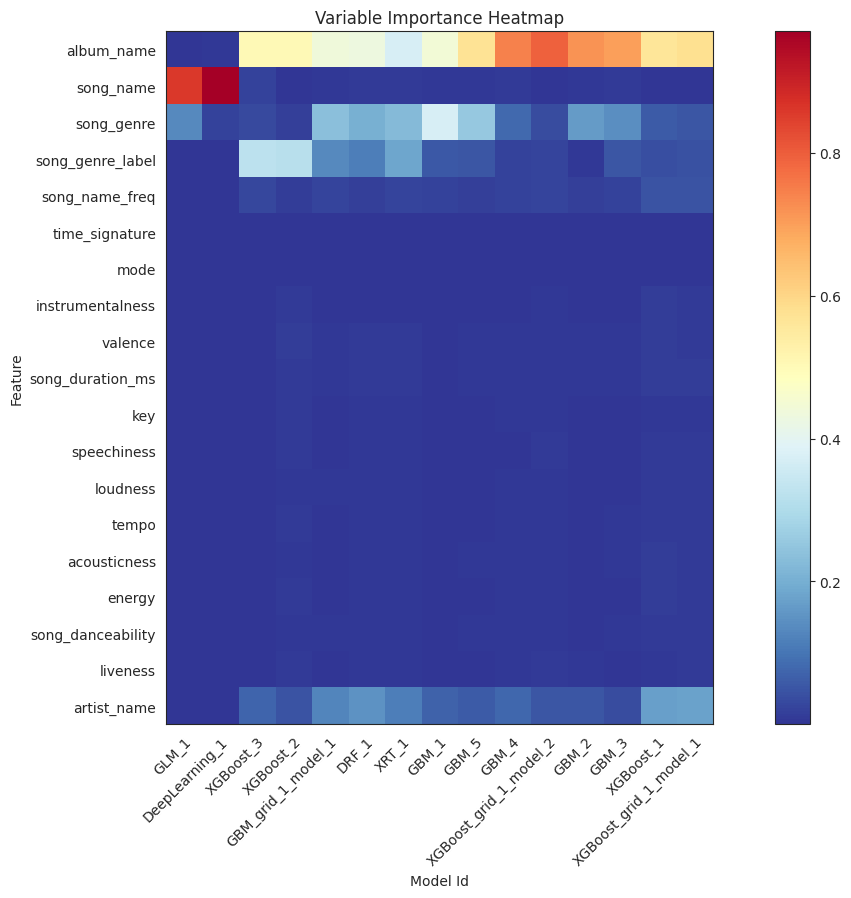

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

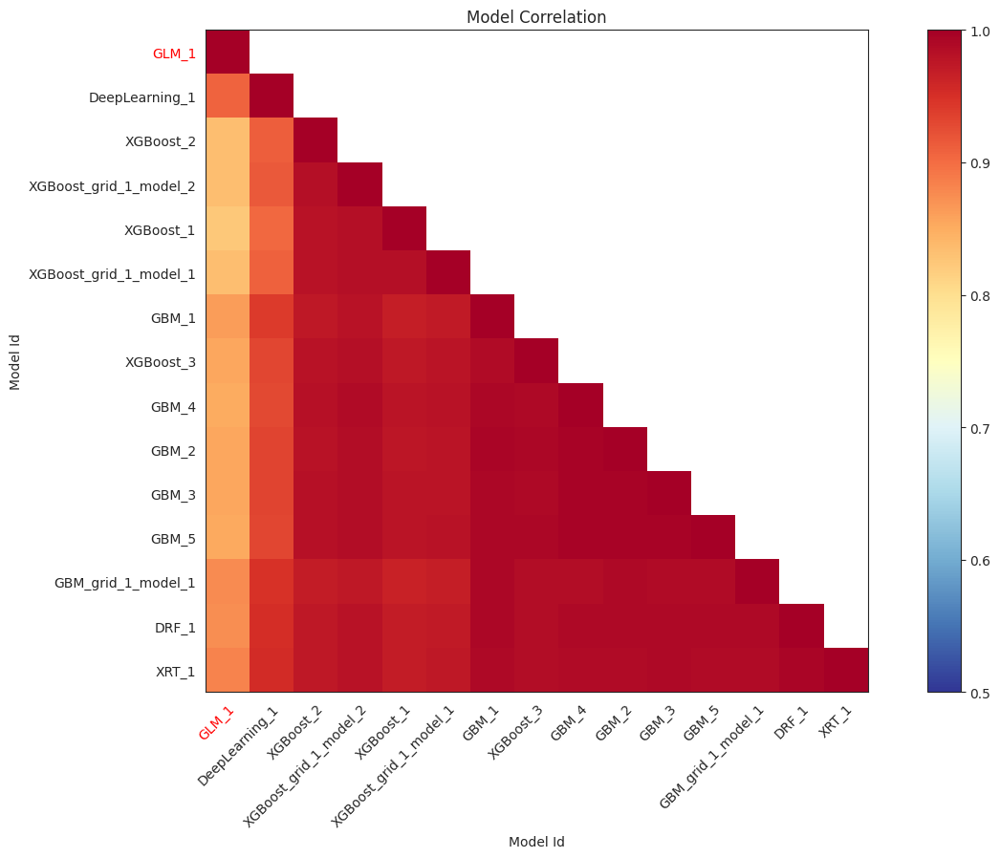

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

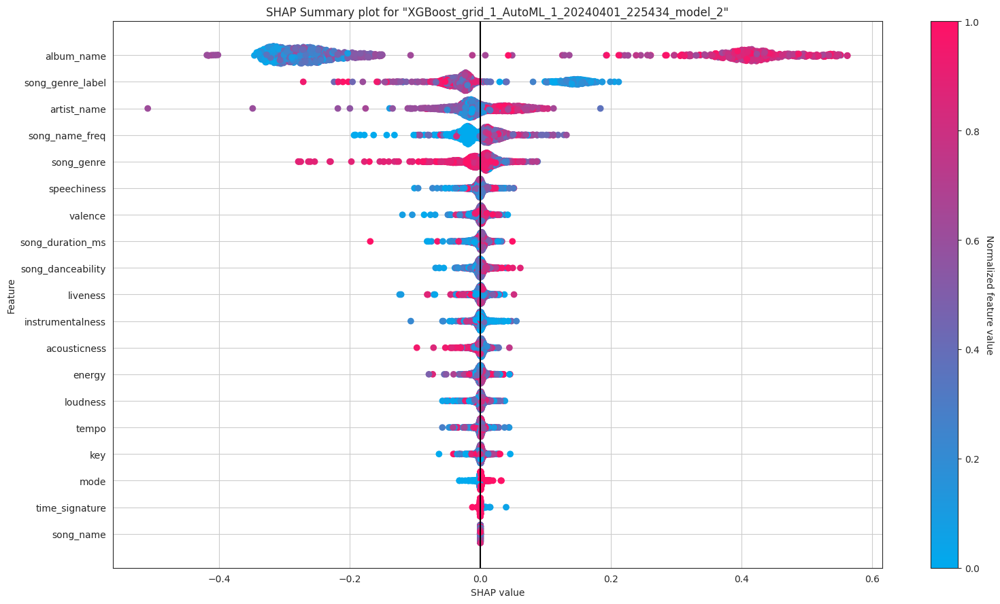

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

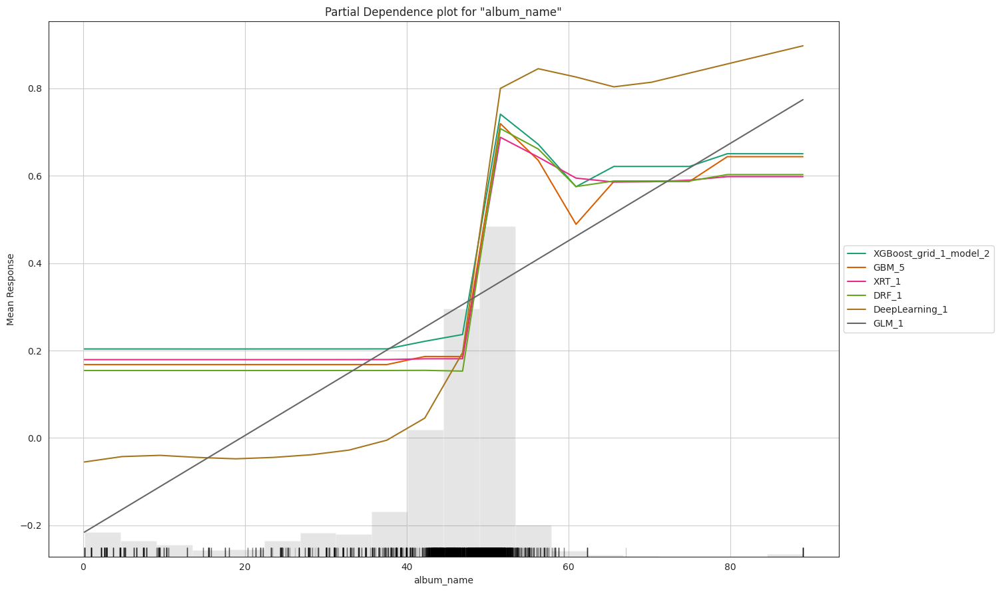

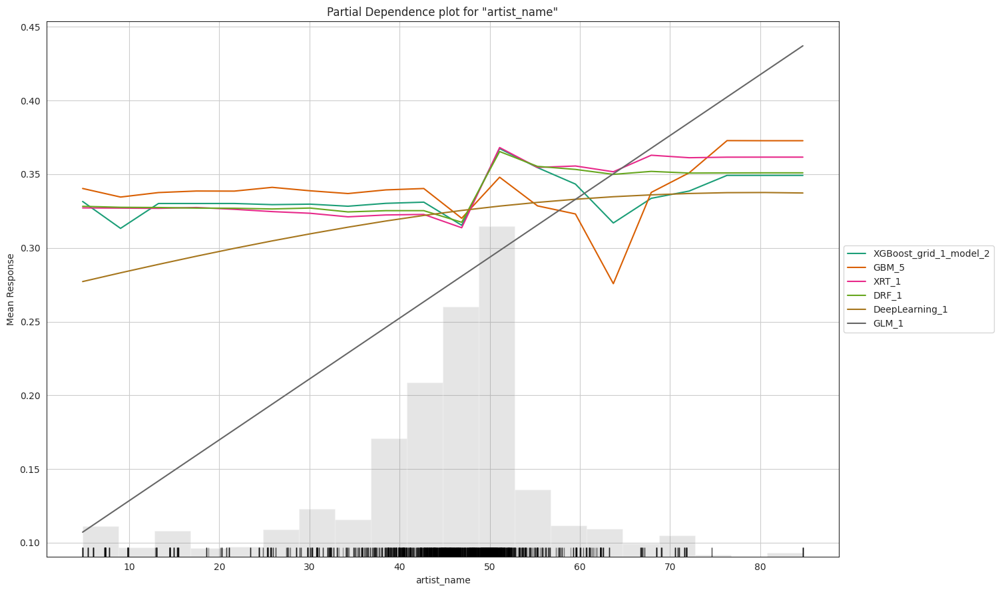

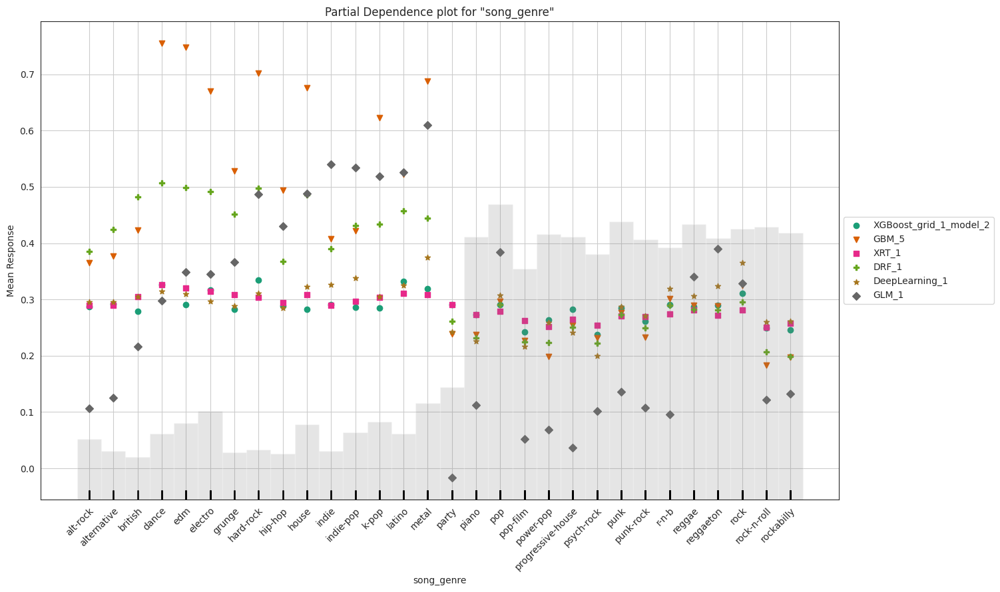

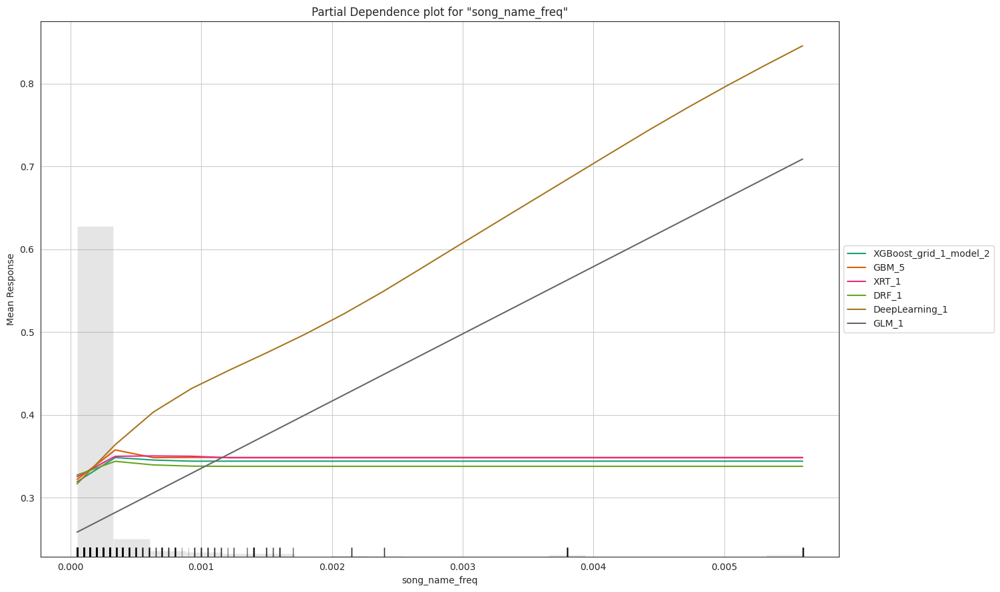

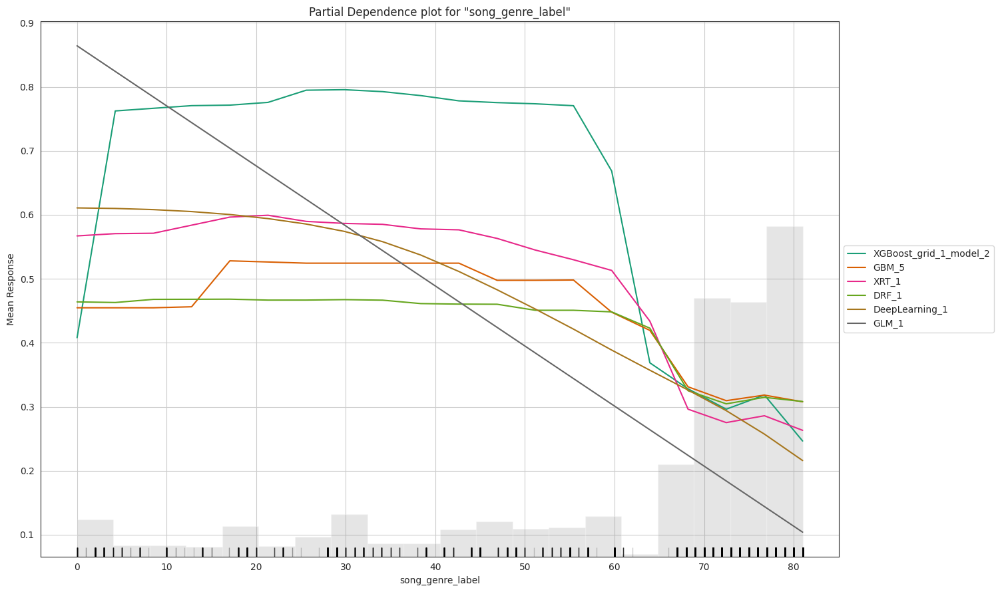

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

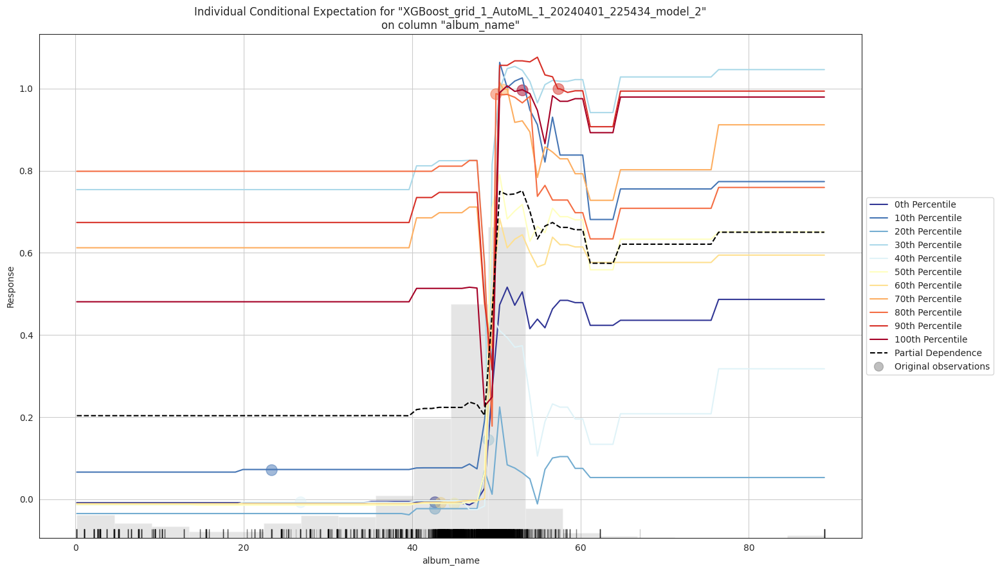

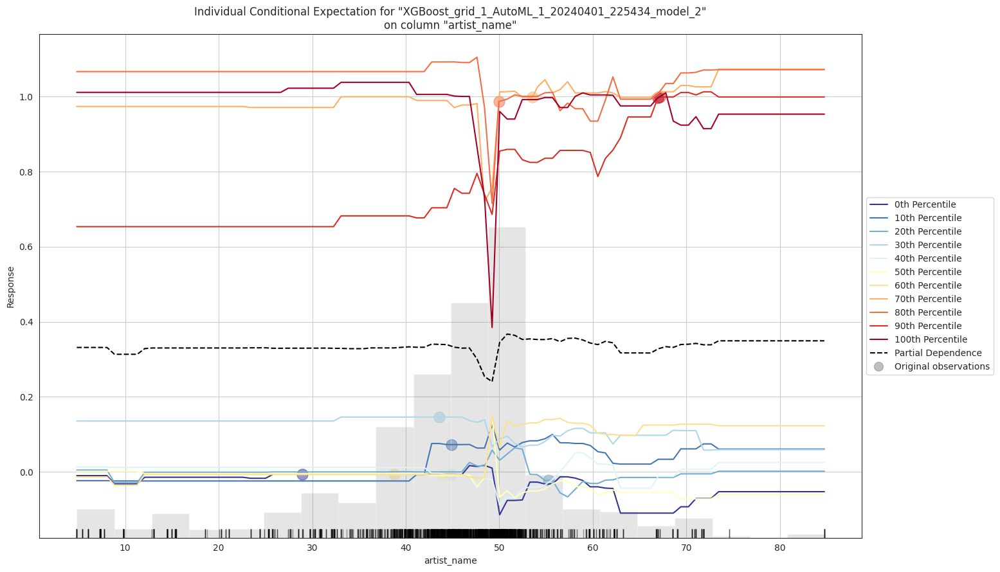

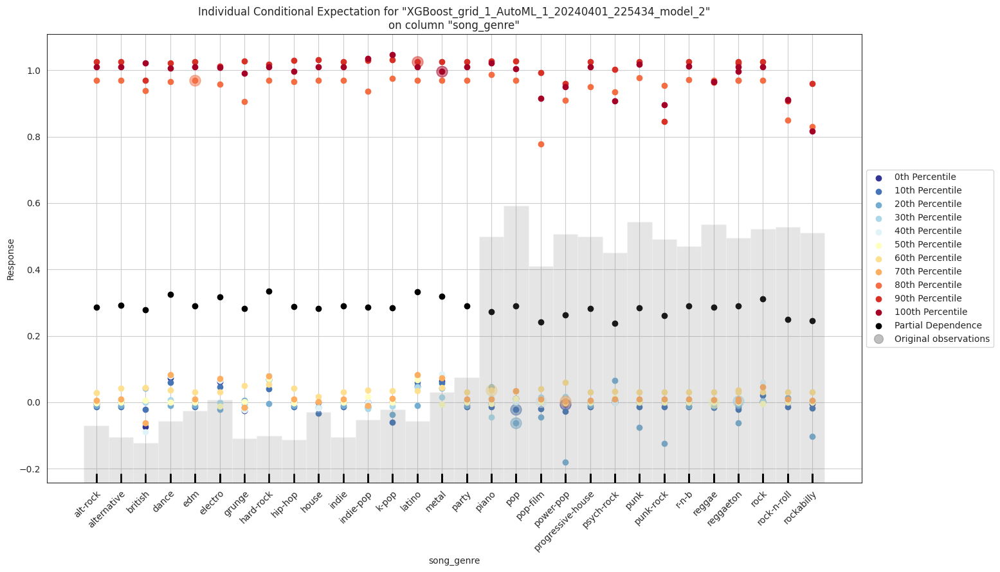

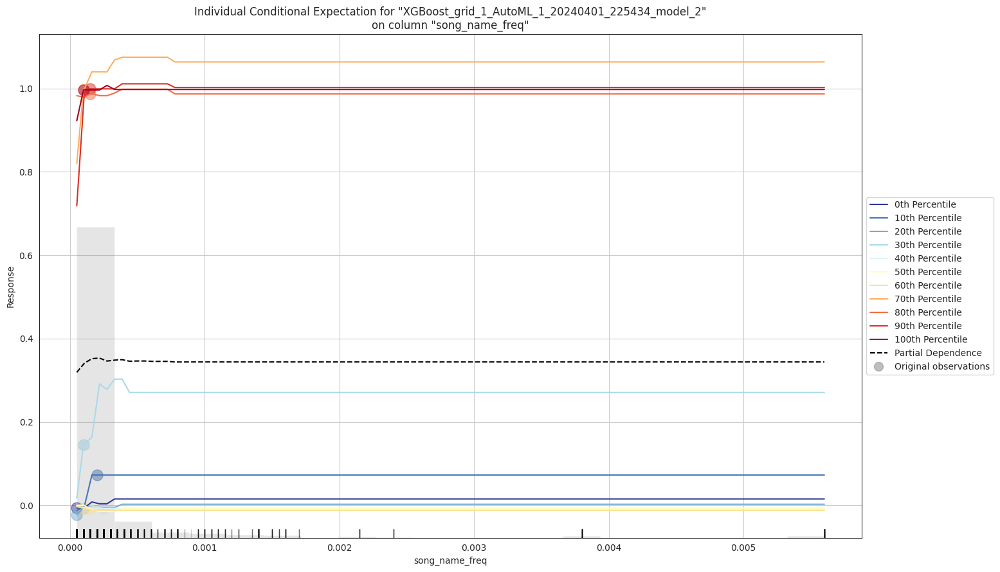

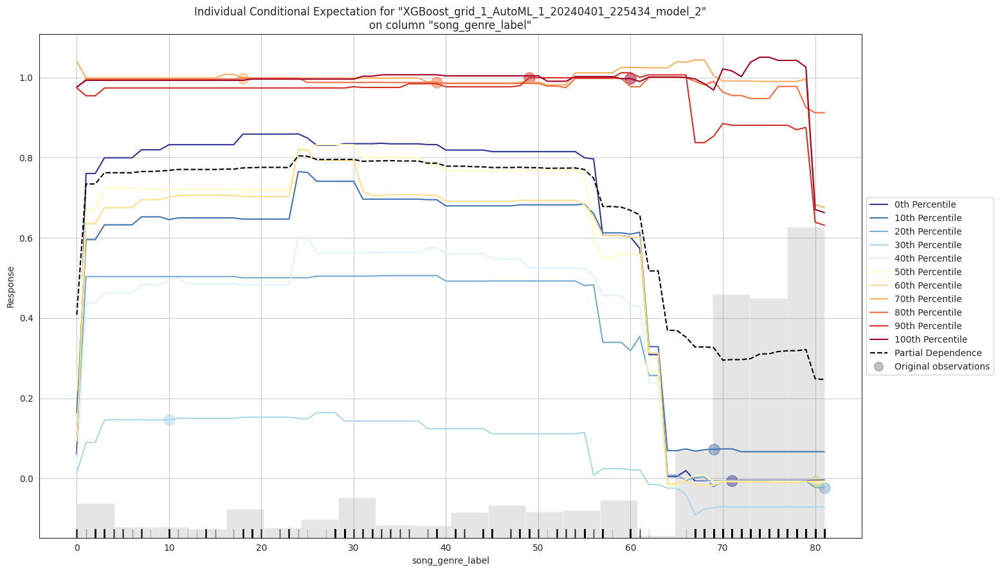



H2OExplanation([('leaderboard', H2OExplanation([('header', <h2o.explanation._explain.Header object at 0x79b24eb365f0>), ('description', <h2o.explanation._explain.Description object at 0x79b24e7f2ad0>), ('data', H2OFrame({'_ex': <Expr(makeLeaderboard ['XGBoost_grid_1_AutoML_1_20240401_225434_model_2', 'XGBoost_grid_1_AutoML_1_20240401_225434_model_1', 'XGBoost_2_AutoML_1_20240401_225434', 'XGBoost_1_AutoML_1_20240401_225434', 'XGBoost_3_AutoML_1_20240401_225434', 'GBM_5_AutoML_1_20240401_225434', 'GBM_3_AutoML_1_20240401_225434', 'GBM_2_AutoML_1_20240401_225434', 'GBM_4_AutoML_1_20240401_225434', 'GBM_1_AutoML_1_20240401_225434', 'XRT_1_AutoML_1_20240401_225434', 'DRF_1_AutoML_1_20240401_225434', 'GBM_grid_1_AutoML_1_20240401_225434_model_1', 'DeepLearning_1_AutoML_1_20240401_225434', 'GLM_1_AutoML_1_20240401_225434'] 'spotify_test.hex' 'AUTO' 'ALL' 'AUTO')#py_10_sid_82c5>}))])), ('residual_analysis', H2OExplanation([('header', <h2o.explanation._explain.Header object at 0x79b24e7f2800

In [ ]:
from h2o import explanation
explanation = aml.explain(spotify_test)
print(explanation)

In [ ]:
predictions1 = aml.leader.predict(X_test)

xgboost prediction progress: |███████████████████████████████████████████████████| (done) 100%


In [ ]:
type(predictions1)

h2o.frame.H2OFrame

In [ ]:
predictions1

predict
1.11384
1.01755
-0.00643453
0.00653878
0.942736
0.0025961
0.00748482
0.0217519
0.0224611
0.000695141


In [ ]:
pre = predictions1.as_data_frame()
pre

,predict
0,1.113844
1,1.017546
2,-0.006435
3,0.006539
4,0.942736
...,...
3995,-0.010744
3996,1.037210
3997,-0.008010
3998,0.996994


In [ ]:
pc = pre.copy()

In [ ]:
pc

,predict
0,1.113844
1,1.017546
2,-0.006435
3,0.006539
4,0.942736
...,...
3995,-0.010744
3996,1.037210
3997,-0.008010
3998,0.996994


In [ ]:
pc['predict'] = pc['predict'] * 100

In [ ]:
pc

,predict
0,111.384392
1,101.754570
2,-0.643453
3,0.653878
4,94.273579
...,...
3995,-1.074441
3996,103.721011
3997,-0.800952
3998,99.699390


In [ ]:
convert_func = lambda x: 1 if x > 66.5 else 0

# Apply the lambda function to the 'col' column
pc['predict'] = pc['predict'].apply(convert_func)

# Display the updated DataFrame
print(pc)

      predict
0           1
1           1
2           0
3           0
4           1
...       ...
3995        0
3996        1
3997        0
3998        1
3999        0

[4000 rows x 1 columns]


In [ ]:
pc

,predict
0,1
1,1
2,0
3,0
4,1
...,...
3995,0
3996,1
3997,0
3998,1


In [ ]:
pc.value_counts()

predict
0          2669
1          1331
dtype: int64

In [ ]:
type(predictions1)
len(predictions1)

4000

In [ ]:
y_test=spotify_test.as_data_frame()
Y_test=y_test['popularity']
type(Y_test)
len(Y_test)

4000

In [ ]:
y_test

,song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_label,song_name_freq,popularity
0,Cigarette Daydreams,208760,0.636,0.676,2,-3.442,1,0.0263,0.080700,0.000000,0.0831,0.2730,113.980,4,60.722162,53.639787,blues,7,0.00020,1
1,Criminal,232549,0.814,0.813,2,-3.023,0,0.0561,0.030000,0.000093,0.2550,0.8390,79.997,4,50.886004,50.886004,reggaeton,78,0.00025,1
2,Things,165720,0.416,0.606,6,-8.296,0,0.0286,0.066700,0.003570,0.1200,0.5830,147.178,4,28.918641,42.647856,power-pop,71,0.00005,0
3,Easy,239373,0.853,0.777,1,-4.025,0,0.0689,0.097200,0.000501,0.3320,0.5550,94.023,4,12.866135,7.807915,reggaeton,78,0.00035,0
4,MIDDLE OF THE NIGHT,184447,0.410,0.611,4,-8.271,0,0.0467,0.022800,0.000000,0.1160,0.0899,185.727,3,52.142994,51.306437,pop,69,0.00015,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,Bachelor Boy,122200,0.413,0.499,2,-10.709,1,0.0332,0.639000,0.000000,0.0840,0.8520,200.541,3,43.938997,45.152575,rockabilly,81,0.00010,0
3996,Churchill Downs (feat. Drake),309327,0.710,0.522,11,-9.102,1,0.3600,0.615000,0.000000,0.1100,0.3700,96.448,4,50.451584,50.951810,k-pop,55,0.00005,1
3997,Rei Sem Nome (Meruem),384347,0.532,0.639,1,-8.823,0,0.0418,0.151000,0.000000,0.1220,0.3570,137.971,4,45.646127,46.418221,r-n-b,76,0.00005,0
3998,Ausl√§nder,231603,0.681,0.912,0,-4.159,1,0.0912,0.000757,0.001360,0.3590,0.4790,125.031,4,66.928292,53.103683,metal,60,0.00010,1


In [ ]:
from sklearn.metrics import confusion_matrix
cm=confusion_matrix(Y_test,pc)
print(cm)

[[2614   42]
 [  55 1289]]


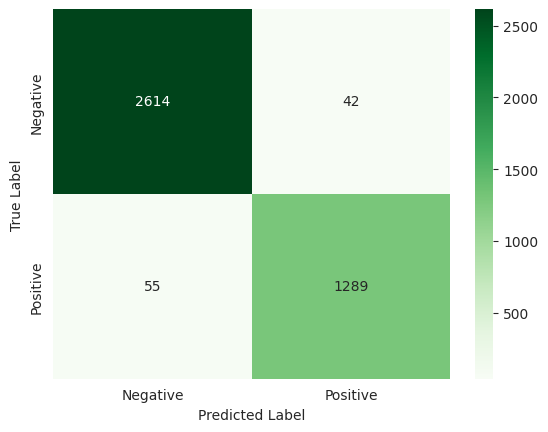

In [ ]:
cm1gr = confusion_matrix(Y_test, pc)
sns.heatmap(cm1gr, annot=True, cmap="Greens", fmt="d", xticklabels=['Negative', 'Positive'], yticklabels=['Negative', 'Positive'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

In [ ]:
from sklearn.metrics import accuracy_score, classification_report
report = classification_report(Y_test,pc)
print(report)
acc= accuracy_score(Y_test,pc)
print("Accuracy is: ",acc)

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      2656
           1       0.97      0.96      0.96      1344

    accuracy                           0.98      4000
   macro avg       0.97      0.97      0.97      4000
weighted avg       0.98      0.98      0.98      4000

Accuracy is:  0.97575


Answer To The Following Questions


Is the relationship significant?

Are any model assumptions violated?

Is there any multicollinearity in the model?

In the multivariate models are predictor variables independent of all the other predictor variables?

In in multivariate models rank the most significant predictor variables and exclude insignificant ones from the model.

Does the model make sense?

Does regularization help?

Which independent variables are significant?

Which hyperparameters are important?

### **Question 1 : Is the relationship significant?**

In [ ]:
print(aml.leader.varimp())

[('album_name', 4986.50146484375, 1.0, 0.79465293070229), ('artist_name', 318.2562561035156, 0.06382355612393027, 0.05071757592172329), ('song_name_freq', 161.01174926757812, 0.032289522103373804, 0.02565896337042237), ('song_genre_label', 160.22982788085938, 0.032132714491417504, 0.025534355742024867), ('song_genre.psych-rock', 100.04450988769531, 0.020063066378910643, 0.015943174496875927), ('speechiness', 59.51993179321289, 0.011936210630407972, 0.009485144758933525), ('song_genre.pop-film', 52.40283966064453, 0.010508938988607427, 0.008350959165868452), ('liveness', 50.014713287353516, 0.010030020775080773, 0.007970385403922791), ('valence', 41.283531188964844, 0.008279057266908562, 0.006578977120600981), ('song_duration_ms', 36.98175811767578, 0.007416373659650492, 0.0058934430638245315), ('song_danceability', 36.69734573364258, 0.007359337201115707, 0.0058481188748929856), ('loudness', 36.2043342590332, 0.007260467988284778, 0.005769552165160659), ('acousticness', 35.801658630371

In [ ]:
print(type(aml.leader.varimp()))
di={}
for i in aml.leader.varimp():
  print(i)
  dii={}
  dii['relative_importance']=i[1]
  dii['scaled_importance']=i[2]
  di[i[0]]=dii

<class 'list'>
('album_name', 4986.50146484375, 1.0, 0.79465293070229)
('artist_name', 318.2562561035156, 0.06382355612393027, 0.05071757592172329)
('song_name_freq', 161.01174926757812, 0.032289522103373804, 0.02565896337042237)
('song_genre_label', 160.22982788085938, 0.032132714491417504, 0.025534355742024867)
('song_genre.psych-rock', 100.04450988769531, 0.020063066378910643, 0.015943174496875927)
('speechiness', 59.51993179321289, 0.011936210630407972, 0.009485144758933525)
('song_genre.pop-film', 52.40283966064453, 0.010508938988607427, 0.008350959165868452)
('liveness', 50.014713287353516, 0.010030020775080773, 0.007970385403922791)
('valence', 41.283531188964844, 0.008279057266908562, 0.006578977120600981)
('song_duration_ms', 36.98175811767578, 0.007416373659650492, 0.0058934430638245315)
('song_danceability', 36.69734573364258, 0.007359337201115707, 0.0058481188748929856)
('loudness', 36.2043342590332, 0.007260467988284778, 0.005769552165160659)
('acousticness', 35.8016586303

In [ ]:
rs = pd.DataFrame.from_dict(di, orient='index')

print("TOP 5 relevant features in ascending order:")

print(rs.head())

TOP 5 relevant features in ascending order:
                       relative_importance  scaled_importance
album_name                     4986.501465           1.000000
artist_name                     318.256256           0.063824
song_name_freq                  161.011749           0.032290
song_genre_label                160.229828           0.032133
song_genre.psych-rock           100.044510           0.020063


The varimp() function returns a table with the following columns:

variable: The name of the predictor variable.
relative_importance : "relative importance" of a variable typically refers to a numeric value or score that indicates the degree to which that variable contributes to the prediction or outcome compared to other predictor variables in the model. Relative importance analysis can help decision-makers prioritize their efforts and allocate resources effectively by focusing on the most critical factors that influence a particular outcome. Various statistical methods, such as regression analysis, factor analysis, and decision trees, can be used to estimate the relative importance of different variables.
scaled_importance: The normalized importance score is calculated by dividing the relative importance score of each variable by the sum of the relative importance scores of all variables in the model. The result is a proportion or percentage that indicates the relative contribution of each variable to the model's prediction.

Text(0.5, 1.0, 'Variable Correlation')

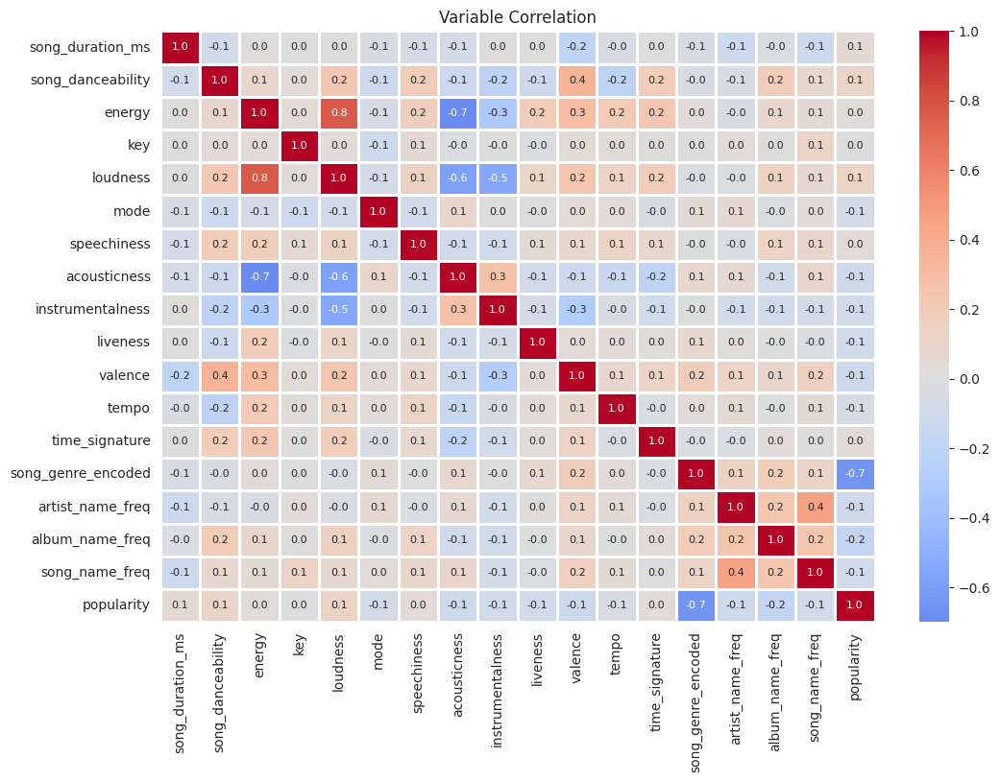

In [ ]:
from IPython.core.pylabtools import figsize
f,ax=plt.subplots(figsize=(12,8))

sns.heatmap(spotify.corr(),center=0, linewidths=0.8,cmap='coolwarm',annot=True, annot_kws={"size": 8},fmt=".1f")
plt.title('Variable Correlation')

### **Question2 Are any model assumptions violated?**

My database is based on Logistic Regression and hence there are a total of 6 assumptions

Assumption 1:The Response Variable is Binary


Assumption 2:The Observations are Independent


Assumption 3:There is No Multicollinearity Among Explanatory Variables


Assumption 4:There are No Extreme Outliers


Assumption 5: There is a Linear Relationship Between Explanatory Variables and the Logit of the Response Variable


Assumption 6:The Sample Size is Sufficiently Large



Assumption 1

There are only 2 response variable

0 - Song not Popular

1 - Song is Popular

**So we can conclude that response is binary**


Assumption 2

Yes, from the sns pairplot, we can see that there is no collinearity between features and that they are fairly independent of each other as most data points

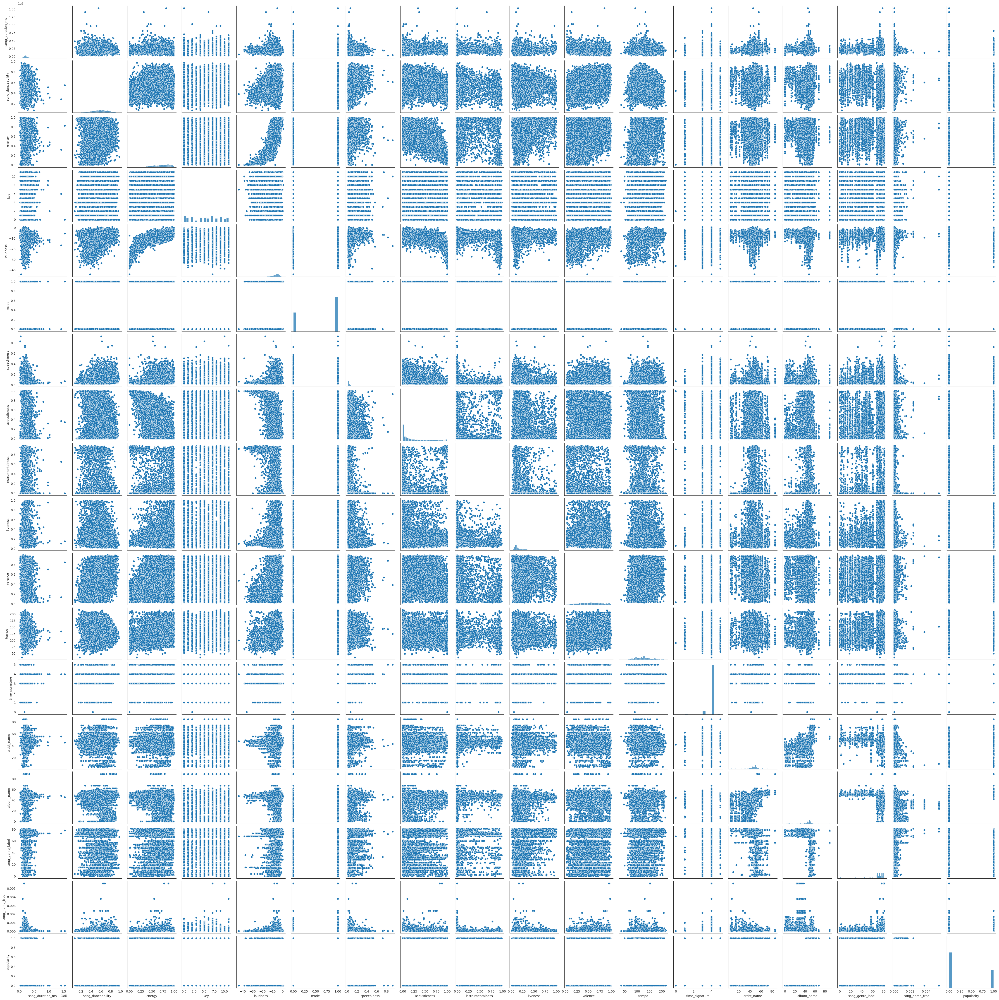

In [ ]:
sns.pairplot(spotify_train.as_data_frame())

Assumption 3

There is No Multicollinearity Among Explanatory Variables

Assumption 4 -

In [ ]:
spotify_train

song_name,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_name,album_name,song_genre,song_genre_label,song_name_freq,popularity
The Foundations of Decay,360760,0.363,0.67,1,-6.652,0,0.0552,0.000582,0.548,0.317,0.198,150.15,4,56.6928,35.0021,punk,74,0.000300015,0
Shine,306040,0.543,0.423,6,-8.797,1,0.0282,0.295,0.0862,0.152,0.355,150.132,4,49.5408,49.5408,grunge,39,5.00025e-05,1
Transito Lento,194080,0.704,0.533,9,-6.94,0,0.0315,0.587,1.64e-05,0.254,0.695,94.056,4,38.0015,38.0015,rock,79,5.00025e-05,0
Percayalah - Bonus Track,208823,0.449,0.785,2,-5.664,1,0.0391,0.0993,0,0.238,0.417,169.94,4,46.2414,46.3129,punk-rock,75,0.000100005,0
"Ratchasa Maamaney (From ""Ponniyin Selvan Part-1"")",289942,0.546,0.786,4,-9.486,1,0.212,0.349,1.35e-06,0.109,0.434,99.798,3,48.7602,48.7602,pop-film,70,5.00025e-05,0
Hey Mor,196600,0.901,0.589,1,-6.713,0,0.289,0.00302,0.000237,0.0992,0.399,98.002,4,52.3202,50.5263,latin,56,0.000300015,1
Dancing In The Dark,244680,0.629,0.486,8,-8.198,1,0.0305,0.497,0,0.117,0.382,122.011,4,32.1997,35.8374,rock,79,5.00025e-05,0
Hey Jude - Remastered 2009,431333,0.402,0.552,10,-10.158,1,0.0258,0.028,1.36e-05,0.0929,0.668,145.164,4,62.3098,49.6337,psych-rock,73,5.00025e-05,0
Remember (feat. Stevie Appleton),199967,0.655,0.89,5,-6.434,0,0.0611,0.101,0.0149,0.488,0.328,127.979,4,49.3914,49.3914,groove,38,0.000100005,1
Euphor,243466,0.296,0.284,10,-14.01,0,0.033,0.968,0.189,0.0961,0.0917,114.786,4,50.3699,50.3699,folk,32,0.000100005,0


In [ ]:
spotify_train_pd = spotify_train.as_data_frame()
spotify_test_pd = spotify_test.as_data_frame()

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
logisticRegr = LogisticRegression()
#spotify_train_pd = spotify_train_pd.dropna(axis=0, how='any', subset=None, inplace=False)
X1 = spotify_train_pd[['song_duration_ms', 'acousticness', 'song_danceability', 'energy', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'time_signature', 'valence']]
y1 = spotify_train_pd[['popularity']]
X1_train_data, X1_test_data, y1_train_data, y1_test_data = train_test_split(X1, y1, test_size=0.2)
logisticRegr.fit(X1_train_data, y1_train_data)

X1_train_data, X1_test_data, y1_train_data, y1_test_data = train_test_split(X1, y1, test_size=0.2)
logisticRegr.fit(X1_train_data, y1_train_data)

LogisticRegression()

In [ ]:
threshold = 0.5
y1_new=logisticRegr.predict(X1_test_data)
accuracy=logisticRegr.score(X1_test_data, y1_test_data)
print(f"Accuracy : {accuracy}")

Accuracy : 0.6771875


In [ ]:
Quantile1 = spotify_train_pd.quantile(0.05)
Quantile3 = spotify_train_pd.quantile(0.95)

final_spotify = spotify_train_pd[~((spotify_train_pd< (Quantile1)) |(spotify_train_pd > (Quantile3))).any(axis=1)]

In [ ]:
X2 = final_spotify[['song_duration_ms', 'acousticness', 'song_danceability', 'energy', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'time_signature', 'valence']]

y2 = final_spotify[['popularity']]

X2_train_data, X2_test_data, y2_train_data, y2_test_data = train_test_split(X2, y2, test_size=0.2,)
logisticRegr.fit(X2_train_data, y2_train_data)
threshold = 0.5
logisticRegr.predict(X2_test_data)
quantile_accuracy=logisticRegr.score(X2_test_data, y2_test_data)
print(f"Quantile Accuracy : {quantile_accuracy}")

Quantile Accuracy : 0.6548175865294668


In [ ]:
print(f"Difference in accuracy : {accuracy-quantile_accuracy}")

Difference in accuracy : 0.022369913470533298


**Since there is little difference in both Accuracy we can conclude that there is very few outliers**



**Assumption 5**

Variable Importance Heatmap :
Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

There is a Linear Relationship Between Explanatory Variables and the Logit of the Response Variable


**Assumption 6**

The Sample Size is Sufficiently Large because the dataset contains 18835 row and 18 columns

### **Question 3 : Is there any multicollinearity in the model?**

Multicollinearity refers to a situation in which two or more independent variables in a statistical model are highly correlated with each other, leading to problems with statistical inference. Multicollinearity can arise when the independent variables are highly correlated with each other, or when one or more independent variables can be linearly predicted from the others.

Multicollinearity can cause several problems in statistical modeling, including:

Reduced precision in parameter estimates
Increased standard errors of the parameter estimates
Misleading statistical significance tests
Difficulty in identifying the true effect of each independent variable on the dependent variable
Reduced power to detect the true effects of the independent variables
To detect multicollinearity, one can examine the correlation matrix of the independent variables and look for correlations that are close to 1 or -1. Additionally, techniques such as variance inflation factor (VIF) and condition number can be used to identify multicollinearity in regression models. To address multicollinearity, one can consider removing one or more of the highly correlated independent variables or use techniques such as principal component analysis (PCA) or ridge regression.



**Currently high correlation exists between Accousticness, Energy and Loudness**

Text(0.5, 1.0, 'Variable Correlation')

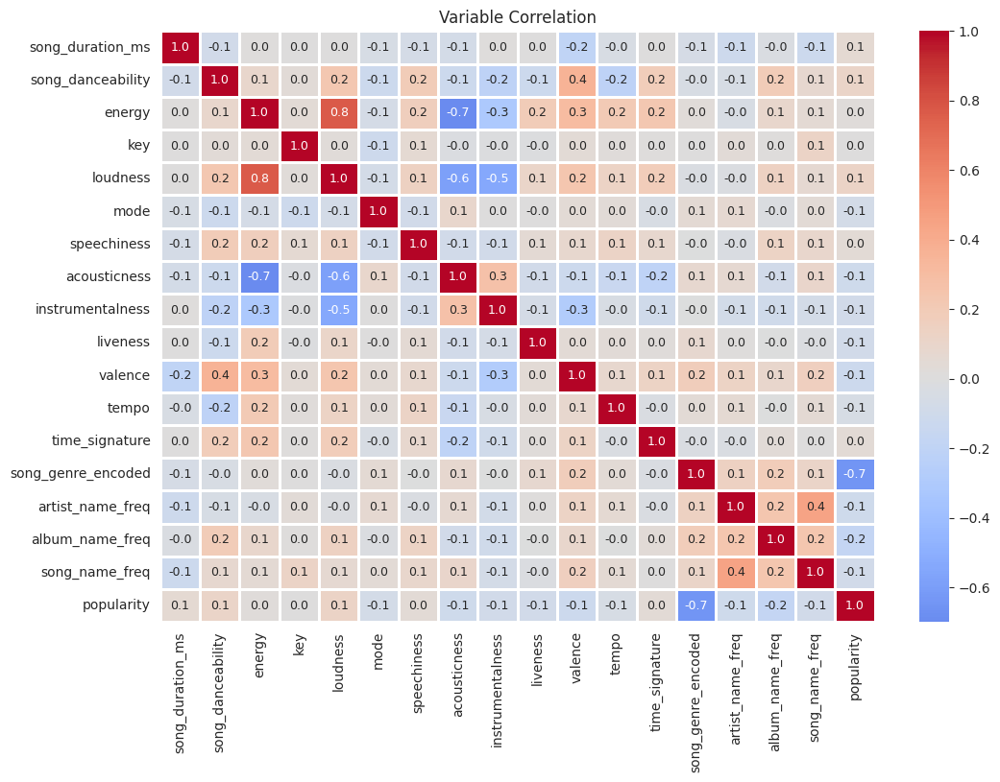

In [ ]:
from IPython.core.pylabtools import figsize
f,ax=plt.subplots(figsize=(12,8))

sns.heatmap(spotify.corr(),center=0, linewidths=0.8,cmap='coolwarm',annot=True, annot_kws={"size": 9},fmt=".1f")
plt.title('Variable Correlation')


In [ ]:
spotify_train_pd = spotify_train_pd[~spotify_train_pd.isin([np.nan, np.inf, -np.inf]).any(1)]
spotify_test_pd = spotify_test_pd[~spotify_test_pd.isin([np.nan, np.inf, -np.inf]).any(1)]


**isin([np.nan, np.inf, -np.inf]):** This part of the code uses the pandas isin method to check each element in the DataFrame against a list of values ([np.nan, np.inf, -np.inf]). The method returns a boolean DataFrame indicating True where the elements are equal to any of the values in the list (i.e., where the elements are either NaN, positive infinity, or negative infinity) and False otherwise.


**.any(1):** This method is applied to the boolean DataFrame returned by isin. The .any() method checks for at least one True value along the specified axis. The argument 1 means the operation is performed along the axis=1 (i.e., row-wise). If any value in a row is True (meaning that row contains at least one NaN, positive infinity, or negative infinity value), .any(1) will return True for that row.

By placing the condition inside the DataFrame's square brackets, we are selecting only the rows where the condition is True. In this context, the condition is that the rows do not contain any NaN, positive infinity, or negative infinity values. As a result, the operation filters out rows with any of these values, leaving behind a cleaned DataFrame where every row has valid data for analysis or modeling.

In [ ]:
print(spotify_train_pd.isnull().sum())
print(spotify_test_pd.isnull().sum())

song_name            0
song_duration_ms     0
song_danceability    0
energy               0
key                  0
loudness             0
mode                 0
speechiness          0
acousticness         0
instrumentalness     0
liveness             0
valence              0
tempo                0
time_signature       0
artist_name          0
album_name           0
song_genre           0
song_genre_label     0
song_name_freq       0
popularity           0
dtype: int64
song_name            0
song_duration_ms     0
song_danceability    0
energy               0
key                  0
loudness             0
mode                 0
speechiness          0
acousticness         0
instrumentalness     0
liveness             0
valence              0
tempo                0
time_signature       0
artist_name          0
album_name           0
song_genre           0
song_genre_label     0
song_name_freq       0
popularity           0
dtype: int64


In [ ]:
X_columns = spotify_train_pd [['song_duration_ms', 'acousticness', 'song_danceability', 'energy', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'time_signature', 'valence']]
numColumns = spotify_train_pd.select_dtypes("number").columns
print(numColumns)

Index(['song_duration_ms', 'song_danceability', 'energy', 'key', 'loudness',
       'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature', 'artist_name', 'album_name',
       'song_genre_label', 'song_name_freq', 'popularity'],
      dtype='object')


The operation confirms that all the variables selected for X_columns are indeed numerical since they also appear in the numColumns output. This consistency is crucial for many statistical and machine learning models that require numerical input.
The presence of artist_name, album_name, song_genre_label, and song_name_freq in the list of numerical columns suggests that some form of numerical transformation or encoding has been applied to these originally categorical features to make them suitable for modeling.
The popularity column, which might represent the target variable for a predictive model (e.g., predicting the popularity of songs based on their features), is also numerical.

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_data = pd.DataFrame()
vif_data["feature"] = X_columns.columns
vif_data["VIF"] = [variance_inflation_factor(X_columns.values, i) for i in range(len(X_columns.columns))]
vif_data

,feature,VIF
0,song_duration_ms,11.171178
1,acousticness,3.390641
2,song_danceability,19.750578
3,energy,33.715116
4,instrumentalness,1.692819
5,key,3.341146
6,liveness,2.637280
7,loudness,10.732198
8,mode,2.912193
9,speechiness,2.328791


VIF stands for "Variance Inflation Factor", which is a statistical measure used to detect multicollinearity in a regression analysis. Multicollinearity is a phenomenon that occurs when two or more predictor variables in a regression model are highly correlated with each other, which can lead to unreliable and unstable estimates of the regression coefficients.

VIF is calculated for each predictor variable in a regression model and measures how much the variance of that variable is inflated due to the presence of other highly correlated predictor variables in the model. Specifically, VIF is the ratio of the variance of the estimated regression coefficient for a given predictor variable, divided by the variance of the coefficient if that variable were uncorrelated with the other predictor variables.

VIF values range from 1 (indicating no multicollinearity) to infinity (indicating perfect multicollinearity). Generally, a VIF value greater than 5 or 10 is considered high and indicates the presence of significant multicollinearity, which may require remedial action such as removing one of the highly correlated variables from the model.

In [ ]:
import statsmodels.api as sm

# Assuming 'df' is your DataFrame containing the dataset
X = spotify_train_pd[['acousticness', 'song_duration_ms','song_danceability', 'energy', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'time_signature', 'valence']]  # Independent variables
Y = spotify_train_pd[['popularity']]  # Dependent variable

# Adding a constant to the model for the intercept
X = sm.add_constant(X)

# Create the model
model = sm.OLS(Y, X).fit()

# Print out the statistics
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:             popularity   R-squared:                       0.080
Model:                            OLS   Adj. R-squared:                  0.079
Method:                 Least Squares   F-statistic:                     106.3
Date:                Mon, 01 Apr 2024   Prob (F-statistic):          1.33e-275
Time:                        23:10:07   Log-Likelihood:                -10074.
No. Observations:               15996   AIC:                         2.018e+04
Df Residuals:                   15982   BIC:                         2.028e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.6098      0.05

**R-squared (0.080):** Represents the proportion of the variance in the dependent variable that is predictable from the independent variables. A value of 0.080 indicates that 8% of the variance in popularity can be explained by the model, which is relatively low, suggesting that other factors not included in the model might be influencing popularity.


**Adj. R-squared (0.079):** This adjusts the R-squared value based on the number of predictors in the model. It's a more accurate measure when comparing models with a different number of independent variables.


**F-statistic (106.3):** A measure used to assess the significance of the overall regression model. The associated Prob (F-statistic) (1.33e-275) suggests the model is statistically significant.


**No. Observations (15996):** The number of data points or samples used in the regression analysis.


**Df Residuals (15982) and Df Model (13):** Degrees of freedom for residuals and the model. Df Model is the number of independent variables.

**P>|t|:** The p-value associated with each coefficient tests the null hypothesis that the coefficient is equal to zero (no effect). A low p-value (< 0.05) indicates that you can reject the null hypothesis. In this model, variables like key have a high p-value, suggesting they might not significantly affect popularity.


**Omnibus/Prob(Omnibus):** Tests the hypothesis that the residuals are normally distributed. A lower value (close to 0) suggests the residuals are not normally distributed, which can be an issue for the model's assumptions.


**Skew:** Measures the asymmetry of the data around the mean. A skewness close to 0 indicates symmetry.


**Kurtosis:** Measures the "tailedness" of the distribution. A lower kurtosis might suggest a flatter distribution.

**Durbin-Watson:** Tests for the presence of autocorrelation in the residuals. A value close to 2 suggests no autocorrelation.

**Jarque-Bera (JB)/Prob(JB):** Another test for normality in residuals. A significant test indicates the residuals do not follow a normal distribution.

**Cond. No.:** Indicates the condition number, which measures the sensitivity of the model's output to its input. A high value (e.g., 3.97e+06) can indicate multicollinearity.


### **Question 4 :In the multivariate models are predictor variables independent of all the other predictor variables?**

Variables are said to be independent when there is no relation between them. To check this relation, correlation matrix can be used, or it can be observed from graphs too whether there is any pattern followed or not. When correlation matrix is computed for the model, it can be observed that Accousticness,Energy and Loudness are correlated to each other. Other than those other predictors are independent from each other.

Text(0.5, 1.0, 'Variable Correlation')

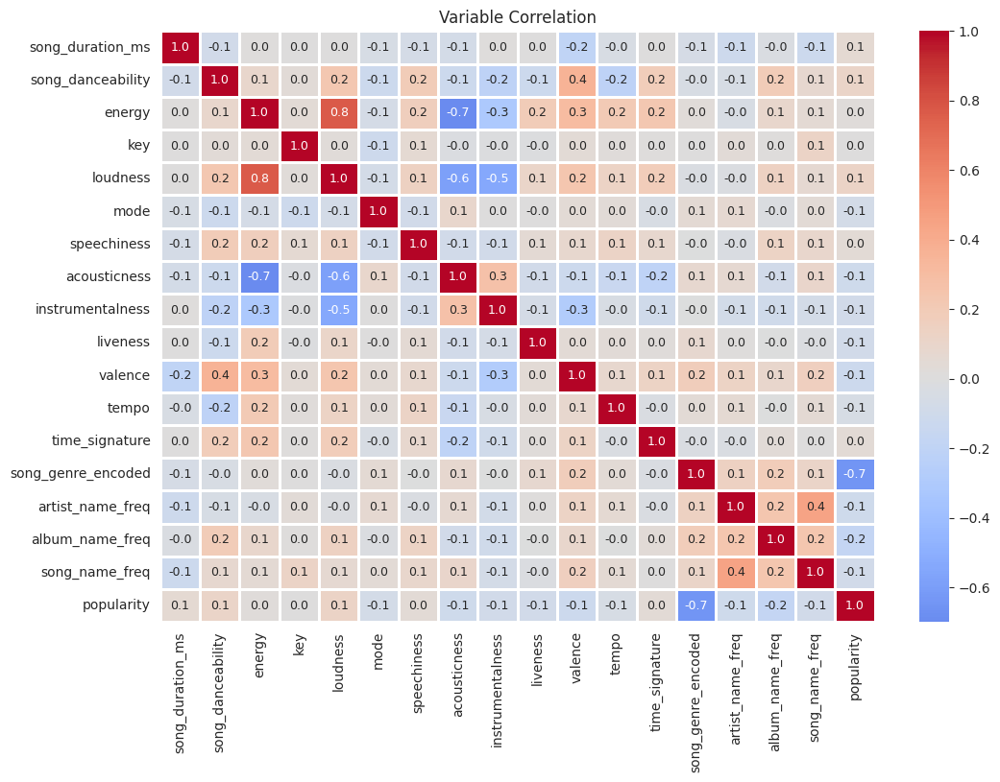

In [ ]:
from IPython.core.pylabtools import figsize
f,ax=plt.subplots(figsize=(12,8))

sns.heatmap(spotify.corr(),center=0, linewidths=0.8,cmap='coolwarm',annot=True, annot_kws={"size": 9},fmt=".1f")
plt.title('Variable Correlation')


### **Question 5 : In multivariate models rank the most significant predictor variables and exclude insignificant ones from the model**

In [ ]:
rs = pd.DataFrame.from_dict(di, orient='index')

print("TOP 5 relevant features in ascending order:")

print(rs.head())

TOP 5 relevant features in ascending order:
                       relative_importance  scaled_importance
album_name                     4986.501465           1.000000
artist_name                     318.256256           0.063824
song_name_freq                  161.011749           0.032290
song_genre_label                160.229828           0.032133
song_genre.psych-rock           100.044510           0.020063


Greater relative importance value significes greater importance

### **Question 6 : Does the model make sense?**

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_data = pd.DataFrame()
vif_data["feature"] = X_columns.columns
vif_data["VIF"] = [variance_inflation_factor(X_columns.values, i) for i in range(len(X_columns.columns))]
vif_data

,feature,VIF
0,song_duration_ms,11.171178
1,acousticness,3.390641
2,song_danceability,19.750578
3,energy,33.715116
4,instrumentalness,1.692819
5,key,3.341146
6,liveness,2.637280
7,loudness,10.732198
8,mode,2.912193
9,speechiness,2.328791


In [ ]:
from sklearn.metrics import accuracy_score, classification_report
report = classification_report(Y_test,pc)
print(report)
acc= accuracy_score(Y_test,pc)
print("Accuracy is: ",acc)

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      2656
           1       0.97      0.96      0.96      1344

    accuracy                           0.98      4000
   macro avg       0.97      0.97      0.97      4000
weighted avg       0.98      0.98      0.98      4000

Accuracy is:  0.97575


For a model to make sense it should follow all the assumptions and have p value, VIF between their respective ranges. RMSE should be as low as possible considering the minimum and maximum values of the target variable we can reffer aml explanation for this value. Other than that, R2 too is 0.97 which is considered good in terms of accuracy. after refering all these values from aml leaderboard and accuracy score we can conclude that overall the model makes sense.

### **Question 7 : Does regularization help?**

In [ ]:
x=list(X_train.columns)
x

['song_name',
 'song_duration_ms',
 'song_danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'artist_name',
 'album_name',
 'song_genre',
 'song_genre_label',
 'song_name_freq']

In [ ]:
mf1_train=spotify_train.drop(['mode','time_signature','song_name','artist_name','album_name','song_genre_label'], axis=1)
mf1_test=spotify_train.drop(['mode','time_signature','song_name','artist_name','album_name','popularity','song_genre_label'], axis=1)

In [ ]:
X1=mf1_train.columns
print(X1)

['song_duration_ms', 'song_danceability', 'energy', 'key', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'song_genre', 'song_name_freq', 'popularity']


In [ ]:
X1

['song_duration_ms',
 'song_danceability',
 'energy',
 'key',
 'loudness',
 'speechiness',
 'acousticness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'song_genre',
 'song_name_freq',
 'popularity']

In [ ]:
y1_numeric ='popularity'

In [ ]:
from h2o.estimators.glm import H2OGeneralizedLinearEstimator
spotify_glm = H2OGeneralizedLinearEstimator(family = 'gaussian', lambda_ = 0, compute_p_values = True)
spotify_glm_regularization = H2OGeneralizedLinearEstimator(family = 'gaussian', lambda_ = .001, alpha = 0)

In [ ]:
spotify_glm_regularization.train(x = X1, y = y1_numeric, training_frame = mf1_train)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1712012038237_15


GLM Model: summary
    family    link      regularization            number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  ------------------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  Ridge ( lambda = 0.001 )  93                            93                             1                       py_313_sid_82c5

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 0.08914646623490509
RMSE: 0.2985740548589329
MAE: 0.19171526992611784
RMSLE: 0.20925705152241075
Mean Residual Deviance: 0.08914646623490509
R^2: 0.6023205002102132
Null degrees of freedom: 15995
Residual degrees of freedom: 15902
Null deviance: 3585.7691297824103
Residual deviance: 1425.9868738935418
AIC: 6914.758270530265

Scoring History: 
    timestamp            duration    iterations    negative_log_likelihood    objective           training_rmse       training_deviance    training_mae         training_r2
--  -------------------  ----------  ------------  -------------------------  ------------------  ------------------  -------------------  -------------------  ------------------
    2024-04-01 23:10:10  0.000 sec   0             3585.7691297824103         0.2241666122644668
    2024-04-01 23:10:10  0.096 sec   1                                                            0.2985740548589329  0.08914646623490509  0.19171526992611784  0.6023205002102132

Variable Importances: 
variable                      relative_importance    scaled_importance      percentage
----------------------------  ---------------------  ---------------------  ----------------------
song_genre.party              0.6194282174110413     1.0                    0.03852353717973468
song_genre.power-pop          0.601385235786438      0.9708715536079134     0.037401406392161225
song_genre.rock-n-roll        0.5893453359603882     0.9514344348464019     0.03665261982488522
song_genre.rockabilly         0.587745726108551      0.9488520373919835     0.03655313674053708
song_genre.r-n-b              0.5794566869735718     0.9354702783729578     0.036037624049437396
song_genre.progressive-house  0.5737494230270386     0.926256516735835      0.03568267736044448
song_genre.punk-rock          0.5697075724601746     0.9197313852464151     0.035431306214909156
song_genre.reggae             0.5424343347549438     0.875701686665324      0.03373512648460798
song_genre.punk               0.5279779434204102     0.8523634031835744     0.032836053253187614
song_genre.psych-rock         0.5227486491203308     0.8439212719517496     0.03251083249680221
---                           ---                    ---                    ---
liveness                      0.013110674917697906   0.021165769574552497   0.0008153803111429703
song_genre.new-age            0.010883147828280926   0.017569667513320703   0.0006768457396849868
song_genre.acoustic           0.010679906234145164   0.01724155589615023    0.0006642057196018171
valence                       0.008144823834300041   0.013148938981730767   0.0005065436397367679
acousticness                  0.006471820641309023   0.010448055899614339   0.0004024960699047393
energy                        0.006396452896296978   0.010326382809991378   0.0003978087921128759
speechiness                   0.005146679934114218   0.008308759254825769   0.00032008279607074515
tempo                         0.0036584606859833     0.005906189907321597   0.0002275273264852773
song_duration_ms              0.0035789820831269026  0.005777880281407903   0.00022258438584087323
key                           0.0010979726212099195  0.0017725582889959383  6.828521514938193e-05
[93 rows x 4 columns]


[tips]
Use `model.explain()` to inspect the model.
--
Use `h2o.display.toggle_user_tips()` to

Performance Metrics:

MSE (Mean Squared Error): 0.08914646623490509. This metric measures the average of the squares of the errors, which are the differences between predicted and actual values.


RMSE (Root Mean Squared Error): 0.2985740548589329. This is the square root of MSE and is in the same unit as the dependent variable.
MAE (Mean Absolute Error): 0.19171526992611784. This measures the average magnitude of the errors in a set of predictions, without considering their direction.


RMSLE (Root Mean Squared Logarithmic Error): 0.20925705152241075. This is similar to RMSE but for log-transformed predicted and actual values, penalizing underestimates more than overestimates.
Mean Residual Deviance: 0.08914646623490509. This is another measure of goodness of fit.


R^2: 0.6023205002102132. This indicates that approximately 60.23% of the variability of the dependent variable is explained by the model.


AIC (Akaike Information Criterion): 6914.758270530265. A lower AIC suggests a better model.

In [ ]:
spotify_glm.train(x = X1, y = y1_numeric, training_frame = mf1_train)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1712012038237_16


GLM Model: summary
    family    link      regularization    number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  ----------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  None              92                            92                             1                       py_313_sid_82c5

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 0.08851025731223867
RMSE: 0.29750673490231894
MAE: 0.17916882054296301
RMSLE: 0.2081600071179875
Mean Residual Deviance: 0.08851025731223867
R^2: 0.6051586076171978
Null degrees of freedom: 15995
Residual degrees of freedom: 15903
Null deviance: 3585.7691297824103
Residual deviance: 1415.81007596657
AIC: 6798.190791992952

Scoring History: 
    timestamp            duration    iterations    negative_log_likelihood    objective           training_rmse        training_deviance    training_mae         training_r2
--  -------------------  ----------  ------------  -------------------------  ------------------  -------------------  -------------------  -------------------  ------------------
    2024-04-01 23:10:10  0.000 sec   0             3585.7691297824103         0.2241666122644668
    2024-04-01 23:10:10  0.207 sec   1                                                            0.29750673490231894  0.08851025731223867  0.17916882054296301  0.6051586076171978

Variable Importances: 
variable                      relative_importance    scaled_importance      percentage
----------------------------  ---------------------  ---------------------  ----------------------
song_genre.bluegrass          0.67784583568573       1.0                    0.028092342158825258
song_genre.party              0.6703948378562927     0.989007828274257      0.027783546309637124
song_genre.mpb                0.6676157712936401     0.9849079778121809     0.02766837190765646
song_genre.breakbeat          0.6391009092330933     0.942841093928915      0.026486614612052185
song_genre.power-pop          0.6353662610054016     0.9373315104350317     0.026331837507389398
song_genre.rock-n-roll        0.6260122656822205     0.9235319193912682     0.025944174674136136
song_genre.rockabilly         0.6255500316619873     0.9228500032447073     0.02592501805242332
song_genre.r-n-b              0.6112388968467712     0.901737334165995      0.02533191372877808
song_genre.punk-rock          0.6007664799690247     0.8862877786381479     0.024897899528688032
song_genre.progressive-house  0.5978231430053711     0.8819455863450051     0.02477591717706965
---                           ---                    ---                    ---
instrumentalness              0.015087132342159748   0.022257468509631152   0.0006252644209618368
song_danceability             0.012317654676735401   0.018171764180382518   0.0005104874169847905
liveness                      0.011557483114302158   0.017050312188774085   0.0004789832039218304
energy                        0.004293049219995737   0.006333371091160802   0.0001779192277117017
acousticness                  0.004132745321840048   0.006096880889825389   0.00017127566405857782
speechiness                   0.003452911274507642   0.0050939477573312365  0.00014310092333812965
valence                       0.0033894525840878487  0.005000329581812615   0.0001404709695191756
tempo                         0.003127922536805272   0.004614504319615637   0.0001296322342400196
song_duration_ms              0.002795950509607792   0.0041247587023667725  0.00011587413278947944
key                           0.0009780572727322578  0.0014428904350246906  4.053417179840983e-05
[92 rows x 4 columns]


[tips]
Use `model.explain()` to inspect the model.
--
Use `h2o.display.toggle_user_tips()` to switch on/off this 

First Model (GLM_model_python_1708397472662_15):
Regularization Used: Ridge with lambda = 0.001.
Number of Predictors: Total of 93, all 93 are active.
Number of Iterations: The model ran for 1 iteration.
Performance Metrics: The model has an MSE of 0.0891, RMSE of 0.2986, MAE of 0.1917, RMSLE of 0.2093, and an R^2 of 0.6023.
Degrees of Freedom: 15995 null degrees of freedom, 15902 residual degrees of freedom.
Deviance: Null deviance is 3585.77, residual deviance is 1425.99.
AIC (Akaike Information Criterion): 6914.76, which provides a measure of the model quality.
Variable Importances: Lists the importance of various song genres and other variables, with song_genre.party being the most important.
Second Model (GLM_model_python_1708397472662_16):
Regularization Used: None specified.
Number of Predictors: Total of 92, all 92 are active.
Number of Iterations: The model ran for 1 iteration.
Performance Metrics: The model has an MSE of 0.0885, RMSE of 0.2975, MAE of 0.1792, RMSLE of 0.2082, and an R^2 of 0.6052.
Degrees of Freedom: 15995 null degrees of freedom, 15903 residual degrees of freedom.
Deviance: Null deviance is 3585.77, residual deviance is 1415.81.
AIC (Akaike Information Criterion): 6798.19, indicating this model may fit better than the first due to the lower AIC.
Variable Importances: Lists the importance of various song genres and other variables, with song_genre.bluegrass being the most important.
In both models, the R^2 values indicate that approximately 60% of the variability in the response variable can be explained by the model. The AIC values are used for model comparison, with lower values typically indicating a better model fit when comparing models with the same dataset.

The variable importances suggest which features are most predictive of the response variable. In both models, various song genres are listed as significant predictors, but their order and relative importance differ between the two models.

Regularization is a technique used in machine learning to prevent overfitting and improve the generalization ability of models. Overfitting occurs when a model fits the training data too closely and does not generalize well to new data. by comparing the results of non regualarized and regularized i can see there is negligible differences in the score so it can be concluded that regularization is no help for us



### **Question 8 : Which independent variables are significant?**

In [ ]:
import statsmodels.api as sm
dependent_var =y2_train_data['popularity']
independent_vars = X2_train_data[['song_duration_ms', 'acousticness', 'song_danceability', 'energy', 'instrumentalness', 'key', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence']].reset_index(drop=True)


In [ ]:
dependent_var

12570    1
6662     1
10721    0
13761    1
8226     1
        ..
10319    1
14960    0
14344    0
3936     0
5174     1
Name: popularity, Length: 4276, dtype: int64

In [ ]:
dvrs = dependent_var.tolist()

In [ ]:
independent_vars

,song_duration_ms,acousticness,song_danceability,energy,instrumentalness,key,liveness,loudness,speechiness,tempo,valence
0,200480,0.174000,0.783,0.840,0.00000,1,0.4120,-3.416,0.0510,95.001,0.839
1,190718,0.008390,0.664,0.828,0.00000,0,0.2940,-6.053,0.0404,103.985,0.820
2,135047,0.813000,0.651,0.549,0.26200,9,0.2970,-7.528,0.0432,139.179,0.888
3,273272,0.078100,0.612,0.780,0.00000,1,0.0593,-5.123,0.0814,92.059,0.554
4,177826,0.004280,0.550,0.917,0.00000,0,0.1970,-3.159,0.0638,126.115,0.601
...,...,...,...,...,...,...,...,...,...,...,...
4271,245040,0.067900,0.604,0.787,0.15000,0,0.1270,-3.674,0.1030,126.062,0.301
4272,212600,0.000735,0.559,0.832,0.00203,2,0.0906,-6.685,0.0337,142.674,0.785
4273,249382,0.024200,0.596,0.827,0.00000,5,0.0958,-4.402,0.0372,115.034,0.329
4274,292026,0.005550,0.539,0.747,0.01390,11,0.2470,-7.569,0.0306,130.011,0.167


In [ ]:
model = sm.OLS(dvrs, independent_vars).fit()
p_values = model.summary2().tables[1]['P>|t|']
print(p_values.round(4))

song_duration_ms     0.0441
acousticness         0.3214
song_danceability    0.0000
energy               0.6864
instrumentalness     0.2416
key                  0.0150
liveness             0.0075
loudness             0.0000
speechiness          0.0000
tempo                0.1298
valence              0.0000
Name: P>|t|, dtype: float64


A p-value below a certain significance level (e.g., 0.05) indicates that the independent variable is statistically significant and has a significant effect on the dependent variable.

In summary, to determine which independent variables are significant, you need to perform appropriate statistical tests on the data and evaluate the results based on a predetermined level of significance.

For this model except for ‘Accousticness’,’key’,'speechiness','energy' and ‘liveliness’ all other variables have p-value less than 0.05. So, it can be said that all variables are significant.

### **Question9 Which hyperparameters are important?**

In [ ]:
hmt = spotify.drop(['song_name','artist_name','song_genre','album_name'], axis=1)

In [ ]:
h = hmt['popularity']

m = hmt.drop(['popularity'], axis = 1)

In [ ]:
import numpy as np

from sklearn.model_selection import train_test_split

from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import RandomizedSearchCV

In [ ]:
m_train, m_test, h_train, h_test = train_test_split (m, h, random_state = 101, test_size = 0.2)


In [ ]:
from sklearn.model_selection import RandomizedSearchCV

from sklearn.ensemble import RandomForestRegressor

mode = RandomForestRegressor()

param_vals = {'max_depth': [200, 500, 800, 1100], 'n_estimators': [100,200, 300, 400], 'min_samples_split' : [2,3,5]

}

random_rf = RandomizedSearchCV(estimator=mode, param_distributions=param_vals,

n_iter=10, scoring='accuracy', cv=3,

refit=True, n_jobs=-1)

#Training and prediction



random_rf.fit(m_train, h_train)

preds = random_rf.best_estimator_.predict(m_test)

RandomizedSearchCV is an approach to hyperparameter tuning that allows you to define a grid of hyperparameters and randomly sample from the grid, performing K-Fold cross-validation with each combination of values.

In [ ]:
best_param = random_rf.best_params_

In [ ]:
best_param

{'n_estimators': 200, 'min_samples_split': 5, 'max_depth': 800}

The random_rf.best_params_ attribute is used to print the best parameters found during the tuning process. These parameters include 'n_estimators': 100, 'min_samples_split': 2, and 'max_depth': 1100.

In [ ]:
pre1 = pd.DataFrame(preds)

Predictions preds are converted into a pandas DataFrame for further processing or analysis.

In [ ]:
pc1 = pre1.copy()

In [ ]:
pc1[0] = pc1[0] * 100
pc1

,0
0,0.000000
1,0.000000
2,0.000000
3,13.654167
4,50.633333
...,...
3995,0.000000
3996,25.822619
3997,100.000000
3998,0.000000


After multiplying the first column by 100, the DataFrame pc1 shows the scaled values. The output displays a subset of rows with their respective scaled values in the first column.

In [ ]:
convert_func1 = lambda x: 1 if x > 66.5 else 0

# Apply the lambda function to the 'col' column
pc1[0] = pc1[0].apply(convert_func1)

# Display the updated DataFrame
print(pc1)

      0
0     0
1     0
2     0
3     0
4     0
...  ..
3995  0
3996  0
3997  1
3998  0
3999  0

[4000 rows x 1 columns]


In [ ]:
pc1count = pc1.value_counts()
pc1count

0    2770
1    1230
dtype: int64

In [ ]:
from sklearn.metrics import confusion_matrix
cm1=confusion_matrix(h_test,pc1)
print(cm)

[[2614   42]
 [  55 1289]]


This indicates that there are 2614 true negatives (correctly predicted negative class), 42 false positives (negative class incorrectly predicted as positive), 55 false negatives (positive class incorrectly predicted as negative), and 1289 true positives (correctly predicted positive class).

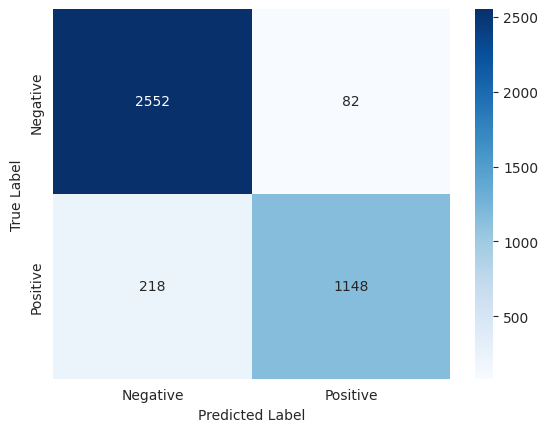

In [ ]:
cm1g = confusion_matrix(h_test, pc1)
sns.heatmap(cm1g, annot=True, cmap="Blues", fmt="d", xticklabels=['Negative', 'Positive'], yticklabels=['Negative', 'Positive'])
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

The confusion matrix is a crucial tool in classification tasks as it provides a detailed breakdown of the model's performance, including how many predictions were correct and how many were incorrect for each class. The model seems to perform quite well, with a high number of true positives and true negatives and a relatively low number of false positives and false negatives.

In [ ]:
from sklearn.metrics import accuracy_score, classification_report
report2 = classification_report(h_test,pc1)
print(report2)
accu= accuracy_score(h_test,pc1)
print("Accuracy is: ",accu)

              precision    recall  f1-score   support

           0       0.92      0.97      0.94      2634
           1       0.93      0.84      0.88      1366

    accuracy                           0.93      4000
   macro avg       0.93      0.90      0.91      4000
weighted avg       0.93      0.93      0.92      4000

Accuracy is:  0.925


**Precision:**

The ratio of correctly predicted positive observations to the total predicted positive observations. For class 0, it's 0.92; for class 1, it's 0.93.


**Recall: **The ratio of correctly predicted positive observations to the all observations in actual class. For class 0, it's 0.97; for class 1, it's 0.84.


**F1-score:** The weighted average of Precision and Recall. It takes both false positives and false negatives into account. For class 0, it's 0.94; for class 1, it's 0.89.


**Support:** The number of actual occurrences of the class in the specified dataset. For class 0, it's 2634; for class 1, it's 1366.
The report also includes averages of these metrics (macro average, weighted average).


Accuracy Score:

The accuracy of the model is printed as approximately 0.92575 (or 92.575%), which indicates a high level of overall accuracy.

Hyperparameter tuning is used to find the best combination of hyperparameters for a machine learning model.Finding the optimal values of hyperparameters is critical for achieving good performance with a machine learning model.for my dataset model tuning is performed using RandomForestRegressor In the case of a random forest model, some of the most important hyperparameters to consider include:

n_estimators: This is the number of decision trees in the forest. Increasing this hyperparameter can often lead to better performance, but it also increases the computational cost of training and prediction.

max_depth: This hyperparameter controls the maximum depth of each decision tree in the forest. Increasing this hyperparameter can lead to more complex models that are better able to capture intricate relationships in the data, but it can also increase the risk of overfitting.

min_samples_split: This hyperparameter controls the minimum number of samples required to split an internal node in each decision tree. Increasing this hyperparameter can help prevent overfitting by enforcing a minimum number of samples required to form a split.

max_features: This hyperparameter controls the maximum number of features that can be used to split each internal node in each decision tree. Increasing this hyperparameter can lead to more diverse and robust decision trees, but it can also increase the risk of overfitting.

These hyperparameters are not exhaustive, and there may be others that are important depending on your specific problem and dataset. It is often a good idea to perform hyperparameter tuning using techniques like grid search or randomized search to find the best combination of hyperparameters for your model.

The best hyperparameters for this model are:- {'n_estimators': 300, 'min_samples_split': 5, 'max_depth': 800} And We got an improved Accuracy of 92%

### **Coding Professionalism?**

**Yes**

# **3. Model Interpretability**

In [ ]:
# Importing all libraries necessary for the assignment
!pip install shap
!pip install lime
!pip install requests
!pip install tabulate
!pip install "colorama>=0.3.8"
!pip install future
!pip install h2o
!pip install pydot
import pandas as pd
import numpy as np
import shap
import lime
import sklearn
from lime import lime_tabular
from sklearn.model_selection import train_test_split
import random
from sklearn.ensemble import RandomForestRegressor
from sklearn.inspection import PartialDependenceDisplay
from sklearn.inspection import partial_dependence
from matplotlib.pyplot import figure
from sklearn.tree import export_graphviz
import pydot
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import h2o
from h2o.automl import H2OAutoML
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.grid.grid_search import H2OGridSearch
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np
from matplotlib.pyplot import figure
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import seaborn as sns

plt.rcParams["figure.figsize"] = (40, 24)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=0234304d26cdb14be9f5eac05ad952a93460973251e7c49ccabf42c4ffe953a0
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.6/265.6 MB 4.6 MB/s eta 0:00:00


In [ ]:
min_mem_size = 6
run_time = 222

In [ ]:
pct_memory = 0.5
virtual_memory = psutil.virtual_memory()
min_mem_size = int(round(int(pct_memory * virtual_memory.available) / 1073741824, 0))
print(min_mem_size)

4


In [ ]:
port_no = random.randint(5555, 55555)

#  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
try:
    h2o.init(
        strict_version_check=False, min_mem_size_GB=min_mem_size, port=port_no
    )  # start h2o
except:
    logging.critical("h2o.init")
    h2o.download_all_logs(dirname=logs_path, filename=logfile)
    h2o.cluster().shutdown()
    sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:18635..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpcsis7e3m
  JVM stdout: /tmp/tmpcsis7e3m/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpcsis7e3m/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:18635
Connecting to H2O server at http://127.0.0.1:18635 ... successful.


H2O_cluster_uptime:,07 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,20 days
H2O_cluster_name:,H2O_from_python_unknownUser_resa8s
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,4 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [ ]:
df1=pd.read_csv("https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/song_data1.csv")
df2=pd.read_csv("https://raw.githubusercontent.com/badani-yash/Spotify_Popularity_Prediction_Dataset/main/song_info2.csv")

In [ ]:
# Label Encoding for 'song_genre'
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df2['song_genre_encoded'] = le.fit_transform(df2['song_genre'])

In [ ]:
# Frequency Encoding for 'artist_name', 'album_name', and 'song_name'
for column in ['artist_name', 'album_name', 'song_name']:
    freq = df2[column].value_counts(normalize=True)  # Get frequency of each category
    df2[column + '_freq'] = df2[column].map(freq)

In [ ]:
df1.head()

,song_name,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,Comedy,73,230666,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4
1,Ghost - Acoustic,55,149610,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4
2,To Begin Again,57,210826,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4
3,Can't Help Falling In Love,71,201933,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3
4,Hold On,82,198853,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4


In [ ]:
df2.head()

,artist_name,album_name,song_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
0,Gen Hoshino,Comedy,Comedy,acoustic,0,0.00010,0.00010,0.00010
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,acoustic,0,0.00005,0.00005,0.00005
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,acoustic,0,0.00005,0.00005,0.00005
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,acoustic,0,0.00005,0.00005,0.00020
4,Chord Overstreet,Hold On,Hold On,acoustic,0,0.00005,0.00005,0.00020


In [ ]:
frames=[df1,df2]
spotify= pd.concat([df1,df2], axis=1)
spotify

,song_name,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,...,tempo,time_signature,artist_name,album_name,song_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq
0,Comedy,73,230666,0.676,0.4610,1,-6.746,0,0.1430,0.03220,...,87.917,4,Gen Hoshino,Comedy,Comedy,acoustic,0,0.00010,0.00010,0.00010
1,Ghost - Acoustic,55,149610,0.420,0.1660,1,-17.235,1,0.0763,0.92400,...,77.489,4,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,acoustic,0,0.00005,0.00005,0.00005
2,To Begin Again,57,210826,0.438,0.3590,0,-9.734,1,0.0557,0.21000,...,76.332,4,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,acoustic,0,0.00005,0.00005,0.00005
3,Can't Help Falling In Love,71,201933,0.266,0.0596,0,-18.515,1,0.0363,0.90500,...,181.740,3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,acoustic,0,0.00005,0.00005,0.00020
4,Hold On,82,198853,0.618,0.4430,2,-9.681,1,0.0526,0.46900,...,119.949,4,Chord Overstreet,Hold On,Hold On,acoustic,0,0.00005,0.00005,0.00020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19994,(Now and Then There's) A Fool Such as I,52,159360,0.574,0.7140,0,-6.344,1,0.0403,0.90100,...,63.623,4,Elvis Presley,Elvis 30 #1 Hits (Expanded Edition),(Now and Then There's) A Fool Such as I,rockabilly,81,0.00835,0.00085,0.00005
19995,"Corrina, Corrina",47,162160,0.481,0.4130,9,-8.688,1,0.0326,0.79800,...,127.591,4,Ray Peterson,Missing You,"Corrina, Corrina",rockabilly,81,0.00015,0.00010,0.00005
19996,Oh! Carol,46,135773,0.584,0.7430,8,-7.039,0,0.0463,0.76600,...,132.747,4,Neil Sedaka,Collections,Oh! Carol,rockabilly,81,0.00035,0.00005,0.00015
19997,ÊôÇË®à‰ªïÊéõ„Åë„ÅÆÊó•„ÄÖ - Remastered 2022,22,227093,0.637,0.9540,9,-7.604,0,0.0448,0.34400,...,128.124,4,Eikichi Yazawa,ÊÉÖ‰∫ã (50th Anniversary Remastered),ÊôÇË®à‰ªïÊéõ„Åë„ÅÆÊó•„ÄÖ - Remastered 2022,rockabilly,81,0.00335,0.00015,0.00005


In [ ]:
spotify["popularity"]= [ 1 if i>=66.5 else 0 for i in spotify.song_popularity ]
spotify["popularity"].value_counts()

0    13226
1     6773
Name: popularity, dtype: int64

In [ ]:
spotify.head()

,song_name,song_popularity,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,...,time_signature,artist_name,album_name,song_name,song_genre,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq,popularity
0,Comedy,73,230666,0.676,0.4610,1,-6.746,0,0.1430,0.0322,...,4,Gen Hoshino,Comedy,Comedy,acoustic,0,0.00010,0.00010,0.00010,1
1,Ghost - Acoustic,55,149610,0.420,0.1660,1,-17.235,1,0.0763,0.9240,...,4,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,acoustic,0,0.00005,0.00005,0.00005,0
2,To Begin Again,57,210826,0.438,0.3590,0,-9.734,1,0.0557,0.2100,...,4,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,acoustic,0,0.00005,0.00005,0.00005,0
3,Can't Help Falling In Love,71,201933,0.266,0.0596,0,-18.515,1,0.0363,0.9050,...,3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,acoustic,0,0.00005,0.00005,0.00020,1
4,Hold On,82,198853,0.618,0.4430,2,-9.681,1,0.0526,0.4690,...,4,Chord Overstreet,Hold On,Hold On,acoustic,0,0.00005,0.00005,0.00020,1


In [ ]:
spotify.drop('song_popularity', axis=1 , inplace=True)

In [ ]:
num_cols = spotify._get_numeric_data().columns
num_cols, len(num_cols)

(Index(['song_duration_ms', 'song_danceability', 'energy', 'key', 'loudness',
        'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness',
        'valence', 'tempo', 'time_signature', 'song_genre_encoded',
        'artist_name_freq', 'album_name_freq', 'song_name_freq', 'popularity'],
       dtype='object'),
 18)

In [ ]:
cat_cols = spotify.select_dtypes(include=['object']).columns.tolist()
cat_cols, len(cat_cols)

(['song_name', 'artist_name', 'album_name', 'song_name', 'song_genre'], 5)

In [ ]:
spotify.drop('song_name', axis=1 , inplace=True)
spotify.drop('artist_name', axis=1, inplace=True)
spotify.drop('album_name', axis=1 , inplace=True)
spotify.drop('song_genre', axis=1, inplace=True)

In [ ]:
spotify.head()

,song_duration_ms,song_danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,song_genre_encoded,artist_name_freq,album_name_freq,song_name_freq,popularity
0,230666,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,0,0.00010,0.00010,0.00010,1
1,149610,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,0,0.00005,0.00005,0.00005,0
2,210826,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,0,0.00005,0.00005,0.00005,0
3,201933,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,0,0.00005,0.00005,0.00020,1
4,198853,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,0,0.00005,0.00005,0.00020,1


In [ ]:
X = spotify.drop(["popularity"], axis=1)  # Training Feature
Y = spotify["popularity"]  # Target

In [ ]:
(
    x_train,
    x_test,
    y_train,
    y_test,
) = train_test_split(  # Splitting Data into Training and Test
    X, Y, test_size=0.2, random_state=42
)
x_train_100 = shap.utils.sample(
    x_train, 100
)  # Taking 100 samples out for SHAP analysis as it is a computationally expensive process
x_test_100 = shap.utils.sample(
    x_test, 100
)  # Taking 100 samples out for SHAP analysis as it is a computationally expensive process

### **Question 1 : Fitting a linear Model and interpreting the regression coefficients**

In [ ]:
linear_model = sklearn.linear_model.LinearRegression()  # Initializing a Linear Model
linear_model.fit(x_train, y_train)  # Training a linear model

LinearRegression()

In [ ]:
# Scaling the data using Min-Max scaling for the purpose of evaluating Co-efficients, as non scaled data may mislead while we evaluate the co-efficients
df = spotify.drop("popularity", axis=1)
df_norm = (df - df.min()) / (df.max() - df.min())
df_norm = pd.concat((df_norm, spotify.popularity), 1)

<ipython-input-23-3b3849f0eae2>:4: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.
  df_norm = pd.concat((df_norm, spotify.popularity), 1)


In [ ]:
import statsmodels.formula.api as smf  # OLS model Library

results = smf.ols(
    "popularity ~ song_duration_ms +	acousticness +	song_danceability +	energy + instrumentalness +	key	+ liveness +	loudness +	mode +	speechiness +	tempo +	time_signature +	valence	",
    data=df_norm,
).fit()
print(results.summary())  # OLS Linear Model Summary

                            OLS Regression Results                            
Dep. Variable:             popularity   R-squared:                       0.077
Model:                            OLS   Adj. R-squared:                  0.076
Method:                 Least Squares   F-statistic:                     128.2
Date:                Mon, 01 Apr 2024   Prob (F-statistic):               0.00
Time:                        23:32:51   Log-Likelihood:                -12615.
No. Observations:               19999   AIC:                         2.526e+04
Df Residuals:                   19985   BIC:                         2.537e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept            -0.0613      0.06

**Model Summary**

**R-squared: **
0.077. This indicates that approximately 7.7% of the variance in the song popularity is explained by the model. It suggests a weak relationship between the features and the target variable.

 **Adjusted R-squared:** 0.076. Adjusting for the number of predictors, the adjusted R-squared value is very close to the R-squared value, indicating that most predictors are relevant, but the overall explanatory power of the model is still low.

**F-statistic**: 128.2. The F-statistic and its associated p-value (Prob (F-statistic)) essentially reject the null hypothesis that none of the predictors are statistically significant. However, this does not imply that all predictors are equally significant.

**AIC and BIC**: These are measures of the model's goodness of fit, with lower values indicating a better fit. They can be used for model comparison.

 **Coefficients**

**Intercept**: The coefficient for the intercept is not statistically significant (p > 0.05), suggesting that when all other variables are held at zero, the baseline popularity does not significantly differ from zero.

**song_duration_ms**: A positive and significant coefficient indicates that longer songs tend to be more popular.
acousticness: Has a significant negative effect on popularity, suggesting that more acoustic songs tend to be less popular.

**song_danceability, loudness, and speechiness** : Positive and significant coefficients suggest that songs that are more danceable, louder, and have more speech are likely to be more popular.

**energy, instrumentalness, liveness, valence:** These have significant negative effects on popularity. It suggests that songs with higher energy, more instrumentals, more live recordings, and higher valence (happiness) might be less popular, which could be counterintuitive for some of these predictors and warrants further investigation.

**key, mode, tempo, time_signature:** Except for key (which is not significant), these features have smaller effects on popularity, with mode having a negative effect, and tempo and time_signature showing mixed effects.

**Statistical Significance**

Most variables are statistically significant (p < 0.05), indicating a non-random association with song popularity. However, the key variable is not significant, suggesting it does not have a distinguishable impact on popularity in the presence of other variables.

**Model Diagnostics**

**Durbin-Watson:** The value is 0.634, indicating potential positive autocorrelation in the residuals, which violates the OLS assumption of independent errors.

**Omnibus, Prob(Omnibus), Jarque-Bera (JB), and Prob(JB):** These tests indicate the residuals might not be normally distributed, suggesting model misspecification or the presence of outliers.

**Skew:** A positive value indicates right-skewed residuals.
Kurtosis: Lower than 3, suggesting the distribution has lighter tails than the normal distribution, pointing towards a platykurtic distribution.

**Cond. No.:** Suggests potential multicollinearity, but not excessively high.

## **Question 2. Fit a tree-based model and interpret the nodes**

In [ ]:
tree_model = RandomForestRegressor(max_depth=4, random_state=42, n_estimators=200,min_samples_split=4,min_samples_leaf=2)
tree_model.fit(x_train, y_train)

RandomForestRegressor(max_depth=4, min_samples_leaf=2, min_samples_split=4,
                      n_estimators=200, random_state=42)

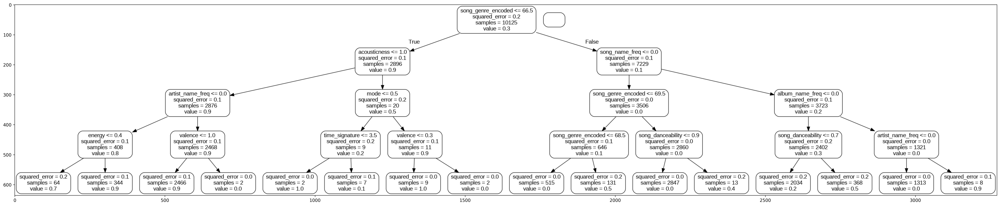

In [ ]:
figure(figsize=(40, 24), dpi=300)
tree = tree_model.estimators_[0]
export_graphviz(
    tree,
    out_file="tree.dot",
    feature_names=list(x_train.columns),
    rounded=True,
    precision=1,
)
(graph,) = pydot.graph_from_dot_file("tree.dot")
graph.write_png("tree.png")
img = mpimg.imread("tree.png")
imgplot = plt.imshow(img)
plt.show()


Root Node: The first split is made on song_genre_encoded <= 66.5, which suggests that this feature is quite important for predicting the target variable. The squared_error associated with this node indicates the variance of the target variable around its mean; the aim is to reduce this with each split.

Branches and Subsequent Nodes: Each decision node represents a condition based on which the tree splits the data further. The true/false branches lead to nodes with further splits or to leaf nodes, depending on whether additional information gain is possible. The feature and the condition chosen at each node suggest which variables and values best segment the data for predicting the target.

Leaf Nodes: These are the final nodes where predictions are made. The value here represents the mean target value of the samples that end up in that leaf. For regression trees, this would be the predicted value for instances that satisfy the path conditions leading to the leaf. The samples indicate the number of instances in the training data that end up in that leaf.

Feature Importances: The fact that features like song_genre_encoded, acousticness, and song_name_freq appear in the tree indicates that these features are influential in predicting the target variable. Their position in the tree (especially if they are closer to the root) suggests a higher importance.

Splits on Continuous and Categorical Variables: Continuous features (like acousticness) might have splits at different threshold values, whereas binary or encoded categorical variables (like song_genre_encoded and song_name_freq) might show a split at a particular encoded value.

Interpretation of the Model: The tree structure allows you to interpret the model's decisions path-by-path. For example, songs with a song_genre_encoded value less than or equal to 66.5 go one way, and those greater go another, with further distinctions made based on other features.

### **Interpreting Nodes of a Tree-Based Model**
A Random Forest Regressor is a machine learning model that utilizes multiple decision trees to predict the target variable by taking the average of their individual predictions. Each decision tree in the model has conditions on its internal nodes and a value assigned to its leaf nodes, which is the predicted value. In addition, the internal nodes also have a value associated with them, which represents the mean of the response variables in the region defined by that node's condition.

In [ ]:
tree_importances = list(tree_model.feature_importances_)
# List of tuples with variable and importance
feature_importances = [
    (feature, round(importance, 2))
    for feature, importance in zip(x_train.columns, tree_importances)
]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

In [ ]:
[print("Variable: {:20} Importance: {}".format(*pair)) for pair in feature_importances];

Variable: song_genre_encoded   Importance: 0.91
Variable: album_name_freq      Importance: 0.03
Variable: song_name_freq       Importance: 0.03
Variable: song_danceability    Importance: 0.02
Variable: song_duration_ms     Importance: 0.0
Variable: energy               Importance: 0.0
Variable: key                  Importance: 0.0
Variable: loudness             Importance: 0.0
Variable: mode                 Importance: 0.0
Variable: speechiness          Importance: 0.0
Variable: acousticness         Importance: 0.0
Variable: instrumentalness     Importance: 0.0
Variable: liveness             Importance: 0.0
Variable: valence              Importance: 0.0
Variable: tempo                Importance: 0.0
Variable: time_signature       Importance: 0.0
Variable: artist_name_freq     Importance: 0.0


## **Question 3 : Getting best model using H2O AutoML**

In [ ]:
spotify_hf = h2o.H2OFrame(spotify)  # Converting Pandas dataframe in H2O dataframe

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [ ]:
pct_rows = 0.80  # Setting up the data split between training and test dataset.
df_train, df_test = spotify_hf.split_frame([pct_rows])


The code snippet you've provided is using a method, presumably from a library that handles H2O data frames (given by the variable name spotify_hf), to split a dataset into training and testing subsets. Here's the breakdown and inference of what's happening:

pct_rows = 0.80: This line sets the percentage of rows that should be included in the training dataset. Here, 80% of the data will be used for training.

df_train, df_test = spotify_hf.split_frame([pct_rows]): This line splits the spotify_hf dataset into two parts based on the specified percentage. 80% of the data is randomly selected to form the training dataset (df_train), and the remaining 20% forms the testing dataset (df_test). The split_frame method is a part of the H2O library, which is designed for working with big data and performing machine learning tasks. The method takes a list of percentages as an argument, indicating how to divide the dataset. Since only one percentage is provided here, it splits the data into two parts: training and testing. If more percentages were provided, it would divide the data into more subsets accordingly.

In [ ]:
def autoML(df_train, df_test):
    X = df_train.columns
    y = "popularity"

    X.remove(y)  # Removing the result frm our predictors data

    aml = H2OAutoML(max_runtime_secs=222, seed=1)  # Setting of AutoML
    aml.train(
        x=X, y=y, training_frame=df_train
    )  # Trainig the dataset on different models

    return df_train, df_test, aml


# Function to get best model from the AutoML leaderboard
def getBestModel(aml):
    model_index = 0
    glm_index = 0
    glm_model = ""
    aml_leaderboard_df = aml.leaderboard.as_data_frame()
    models_dict = {}

    for m in aml_leaderboard_df["model_id"]:
        models_dict[m] = model_index
        if "StackedEnsemble" not in m:
            break
        model_index = model_index + 1

    for m in aml_leaderboard_df["model_id"]:
        if "GLM" in m:
            models_dict[m] = glm_index
            break
        glm_index = glm_index + 1

    print(model_index)
    best_model = h2o.get_model(aml.leaderboard[model_index, "model_id"])
    return best_model


In [ ]:
autoML = autoML(df_train, df_test)  # Training AutoML

AutoML progress: |
23:33:19.829: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

███████████████
23:34:12.562: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

█
23:34:15.966: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

███████████████
23:35:09.898: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

█
23:35:11.754:

In [ ]:
autoML[2].leaderboard  # Leaderbord of AutoML output

model_id,rmse,mse,mae,rmsle,mean_residual_deviance
StackedEnsemble_AllModels_2_AutoML_1_20240401_233319,0.239592,0.0574041,0.134719,0.167859,0.0574041
StackedEnsemble_AllModels_1_AutoML_1_20240401_233319,0.239744,0.057477,0.135127,0.168046,0.057477
StackedEnsemble_BestOfFamily_3_AutoML_1_20240401_233319,0.240297,0.0577429,0.134876,0.168376,0.0577429
StackedEnsemble_BestOfFamily_2_AutoML_1_20240401_233319,0.240386,0.0577855,0.135148,0.168486,0.0577855
StackedEnsemble_BestOfFamily_1_AutoML_1_20240401_233319,0.247178,0.0610969,0.149885,0.175039,0.0610969
DRF_1_AutoML_1_20240401_233319,0.250058,0.0625288,0.138093,0.174079,0.0625288
GBM_4_AutoML_1_20240401_233319,0.251778,0.0633922,0.149377,0.176198,0.0633922
GBM_3_AutoML_1_20240401_233319,0.257795,0.0664584,0.150801,0.180192,0.0664584
GBM_1_AutoML_1_20240401_233319,0.260971,0.0681058,0.15905,0.183633,0.0681058
GBM_2_AutoML_1_20240401_233319,0.260977,0.0681088,0.152777,0.182482,0.0681088


In [ ]:
autoML_model = getBestModel(autoML[2])  # Getting Best Model
print(autoML_model)

/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


5
Model Details
H2ORandomForestEstimator : Distributed Random Forest
Model Key: DRF_1_AutoML_1_20240401_233319


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    22                 22                          314752                 20           20           20            951           1298          1132.59

ModelMetricsRegression: drf
** Reported on train data. **

MSE: 0.06605741903270947
RMSE: 0.2570163789191449
MAE: 0.1331932243777208
RMSLE: 0.1797420084900801
Mean Residual Deviance: 0.06605741903270947

ModelMetricsRegression: drf
** Reported on cross-validation data. **

MSE: 0.0625288282603032
RMSE: 0.2500576498735906
MAE: 0.1380925921689916
RMSLE: 0.17407926468870813
Mean Residual Deviance: 0.0625288282

In [ ]:
autoML_model.predict

<bound method ModelBase.predict of H2ORandomForestEstimator({'parms': {'model_id': {'__meta': {'schema_version': 3, 'schema_name': 'ModelParameterSchemaV3', 'schema_type': 'Iced'}, 'name': 'model_id', 'label': 'model_id', 'help': 'Destination id for this model; auto-generated if not specified.', 'required': False, 'type': 'Key<Model>', 'default_value': None, 'actual_value': {'__meta': {'schema_version': 3, 'schema_name': 'ModelKeyV3', 'schema_type': 'Key<Model>'}, 'name': 'DRF_1_AutoML_1_20240401_233319', 'type': 'Key<Model>', 'URL': '/3/Models/DRF_1_AutoML_1_20240401_233319'}, 'input_value': None, 'level': 'critical', 'values': [], 'is_member_of_frames': [], 'is_mutually_exclusive_with': [], 'gridable': False}, 'training_frame': {'__meta': {'schema_version': 3, 'schema_name': 'ModelParameterSchemaV3', 'schema_type': 'Iced'}, 'name': 'training_frame', 'label': 'training_frame', 'help': 'Id of the training data frame.', 'required': False, 'type': 'Key<Frame>', 'default_value': None, 'actual_value': {'__meta': {'schema_version': 3, 'schema_name': 'FrameKeyV3', 'schema_type': 'Key<Frame>'}, 'name': 'AutoML_1_20240401_233319_training_py_2_sid_8c29', 'type': 'Key<Frame>', 'URL': '/3/Frames/AutoML_1_20240401_233319_training_py_2_sid_8c29'}, 'input_value': {'__meta': {'schema_version': 3, 'schema_name': 'FrameKeyV3', 'schema_type': 'Key<Frame>'}, 'name': 'AutoML_1_20240401_233319_training_py_2_sid_8c29', 'type': 'Key<Frame>', 'URL': '/3/Frames/AutoML_1_20240401_233319_training_py_2_sid_8c29'}, 'level': 'critical', 'values': [], 'is_member_of_frames': [], 'is_mutually_exclusive_with': [], 'gridable': False}, 'validation_frame': {'__meta': {'schema_version': 3, 'schema_name': 'ModelParameterSchemaV3', 'schema_type': 'Iced'}, 'name': 'validation_frame', 'label': 'validation_frame', 'help': 'Id of the validation data frame.', 'required': False, 'type': 'Key<Frame>', 'default_value': None, 'actual_value': None, 'input_value': None, 'level': 'critical', 'values': [], 'is_member_of_frames': [], 'is_mutually_exclusive_with': [], 'gridable': True}, 'nfolds': {'__meta': {'schema_version': 3, 'schema_name': 'ModelParameterSchemaV3', 'schema_type': 'Iced'}, 'name': 'nfolds', 'label': 'nfolds', 'help': 'Number of folds for K-fold cross-validation (0 to disable or >= 2).', 'required': False, 'type': 'int', 'default_value': 0, 'actual_value': 5, 'input_value': 5, 'level': 'critical', 'values': [], 'is_member_of_frames': [], 'is_mutually_exclusive_with': [], 'gridable': False}, 'keep_cross_validation_models': {'__meta': {'schema_version': 3, 'schema_name': 'ModelParameterSchemaV3', 'schema_type': 'Iced'}, 'name': 'keep_cross_validation_models', 'label': 'keep_cross_validation_models', 'help': 'Whether to keep the cross-validation models.', 'required': False, 'type': 'boolean', 'default_value': True, 'actual_value': False, 'input_value': False, 'level': 'expert', 'values': [], 'is_member_of_frames': [], 'is_mutually_exclusive_with': [], 'gridable': False}, 'keep_cross_validation_predictions': {'__meta': {'schema_version': 3, 'schema_name': 'ModelParameterSchemaV3', 'schema_type': 'Iced'}, 'name': 'keep_cross_validation_predictions', 'label': 'keep_cross_validation_predictions', 'help': 'Whether to keep the predictions of the cross-validation models.', 'required': False, 'type': 'boolean', 'default_value': False, 'actual_value': True, 'input_value': True, 'level': 'expert', 'values': [], 'is_member_of_frames': [], 'is_mutually_exclusive_with': [], 'gridable': False}, 'keep_cross_validation_fold_assignment': {'__meta': {'schema_version': 3, 'schema_name': 'ModelParameterSchemaV3', 'schema_type': 'Iced'}, 'name': 'keep_cross_validation_fold_assignment', 'label': 'keep_cross_validation_fold_assignment', 'help': 'Whether to keep the cross-validation fold assignment.', 'required': False, 'type': 'boolean', 'default_value': False, 'actual_value': False, 'input_value': False, 'level': 'expert', 'values': [], 'is_member_of_frames': [], 'is_mutually_exclusive_

## **Question 4 : Run SHAP analysis on the models from steps 1, 2, and 3,   interpret the SHAP values and compare them with the other model interpretability methods.**

### **SHAP Analysis for Linear and Tree-Based Models**

Here the x-axis is the feature and the y-axis is the output as we vary the feature. The grey histogram is the distribution of variables in the dataset and the cross made by E[Feature], E[f(x)] is the expected values.

Let us take a feature of Danceability

For the linear model the cross is made at approx E[f(x)] 0.304

For Tree-based model the cross is made at approx E[f(x)] 0.295

So as the Danceability increases the expected value also increases

Talking about the red line on the plot - When we give a sample as an input (sample_ind = 18) as an input to check the output. By plotting this we can see the difference between the model output from the expected value.

PermutationExplainer explainer: 16000it [1:28:44,  3.00it/s]


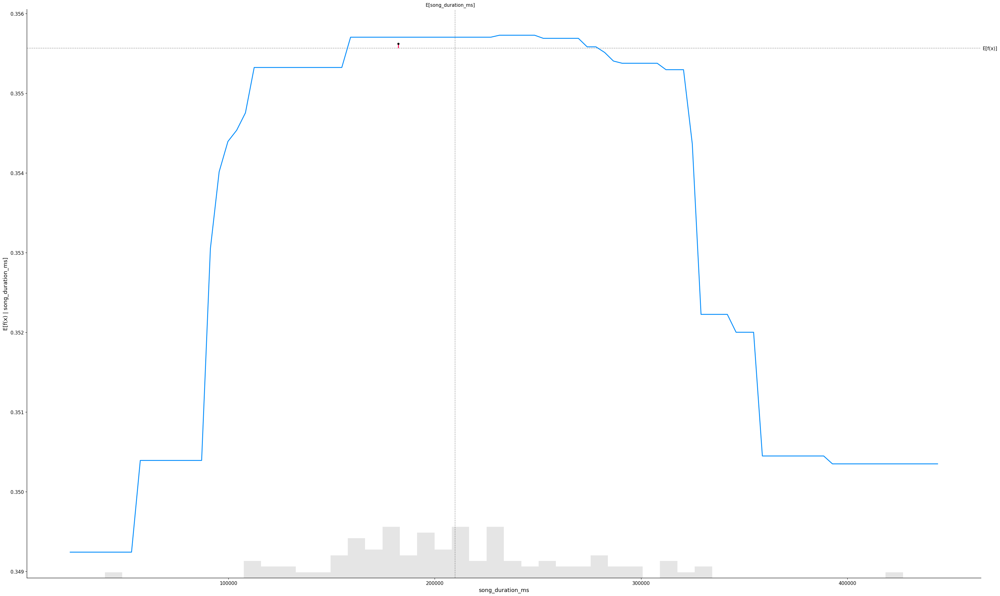

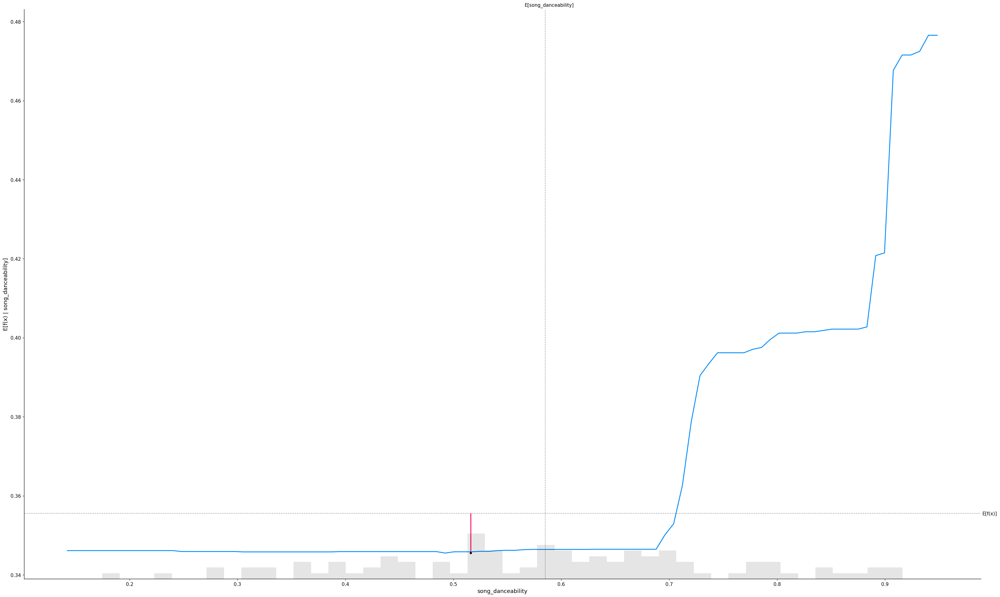

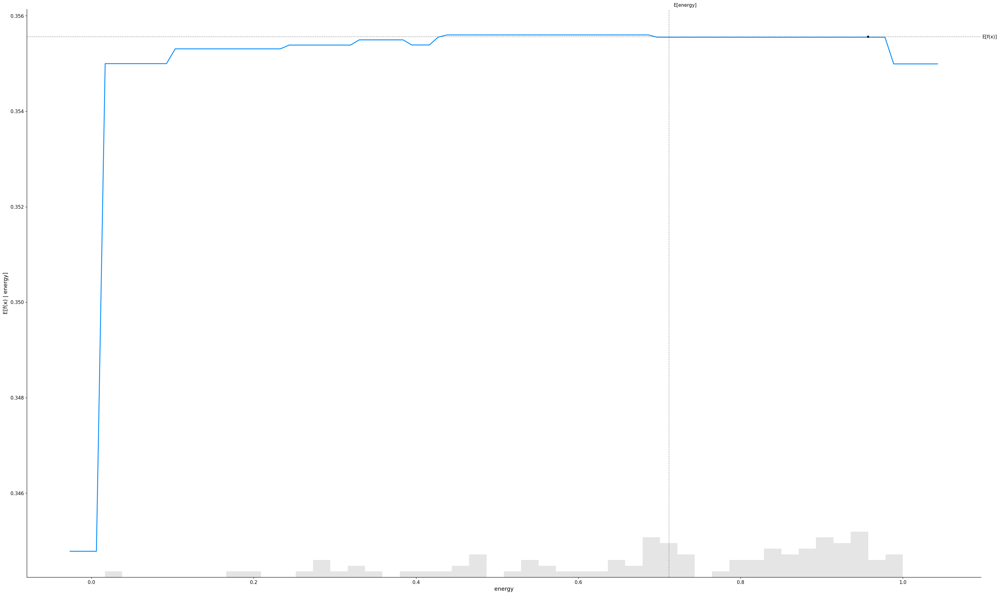

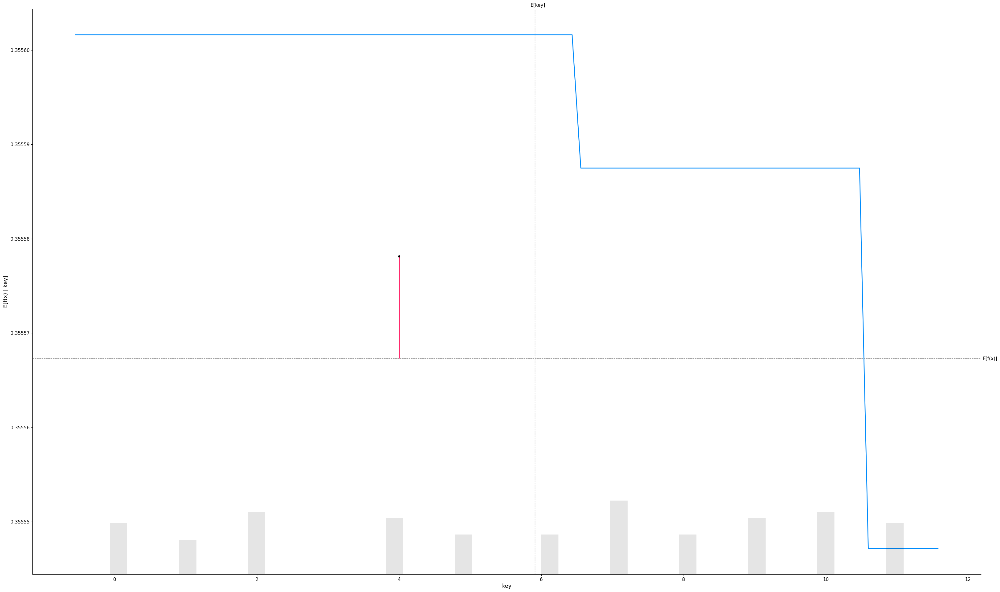

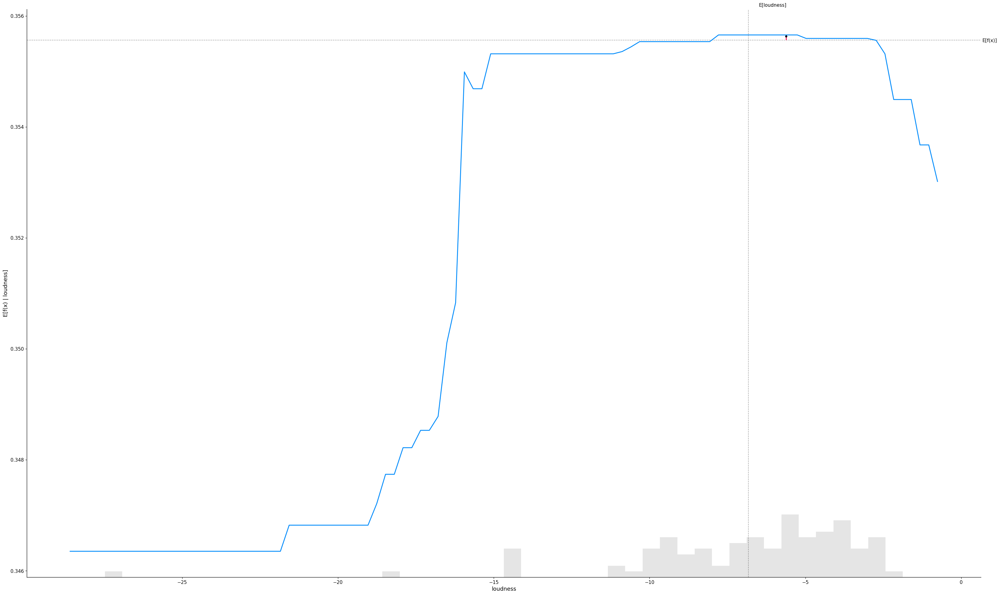

...

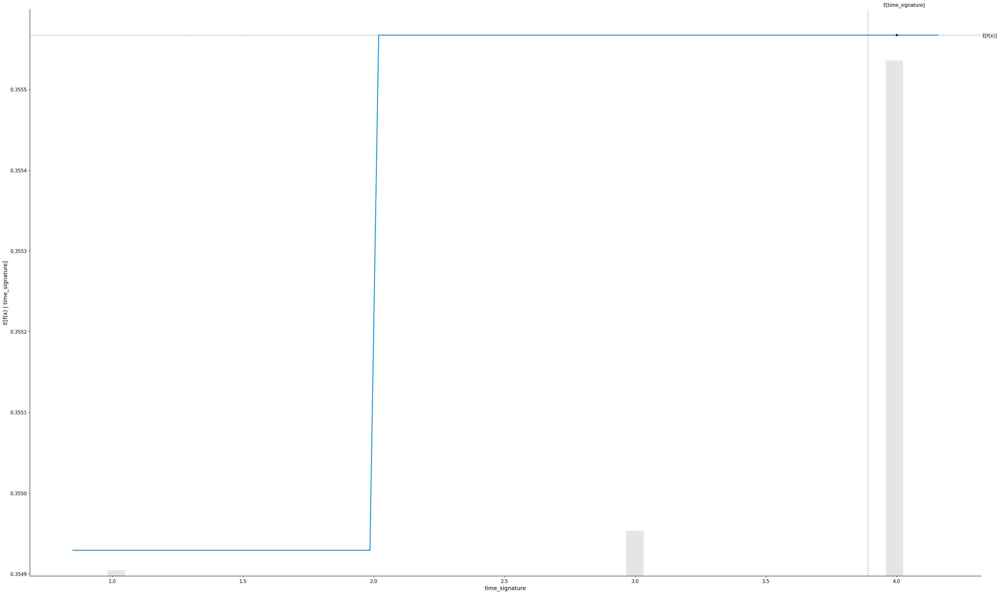

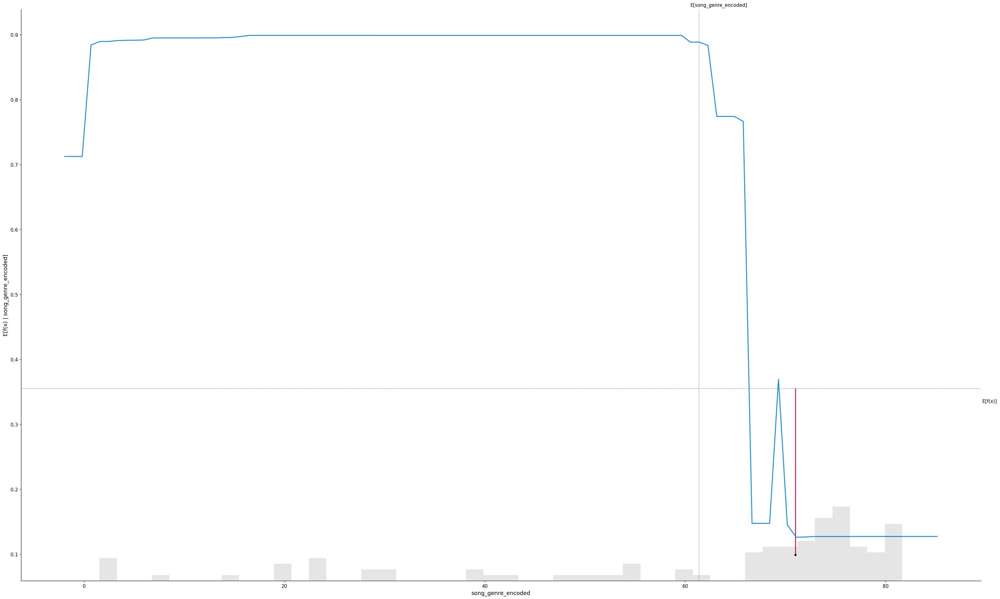

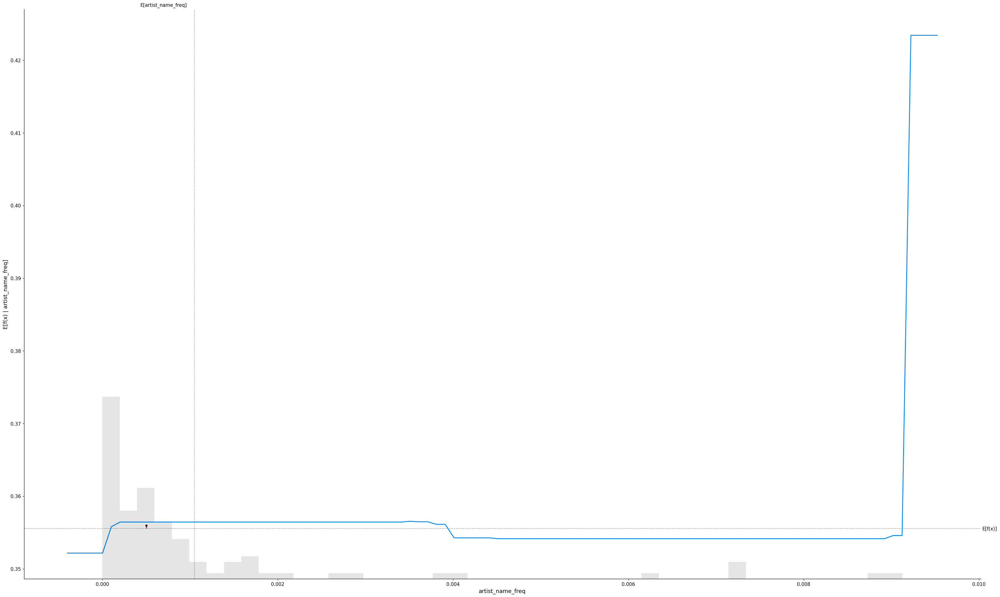

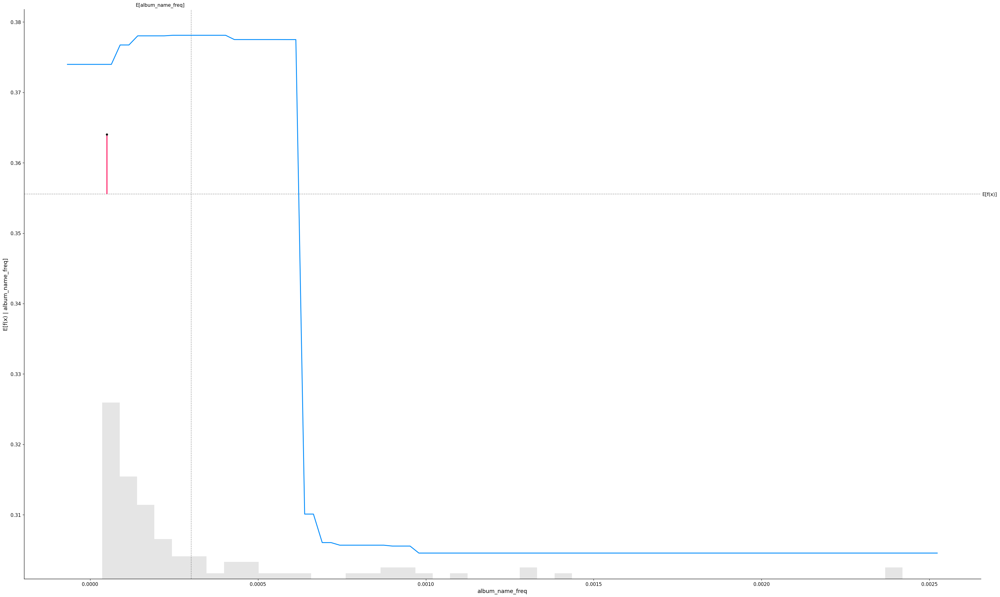

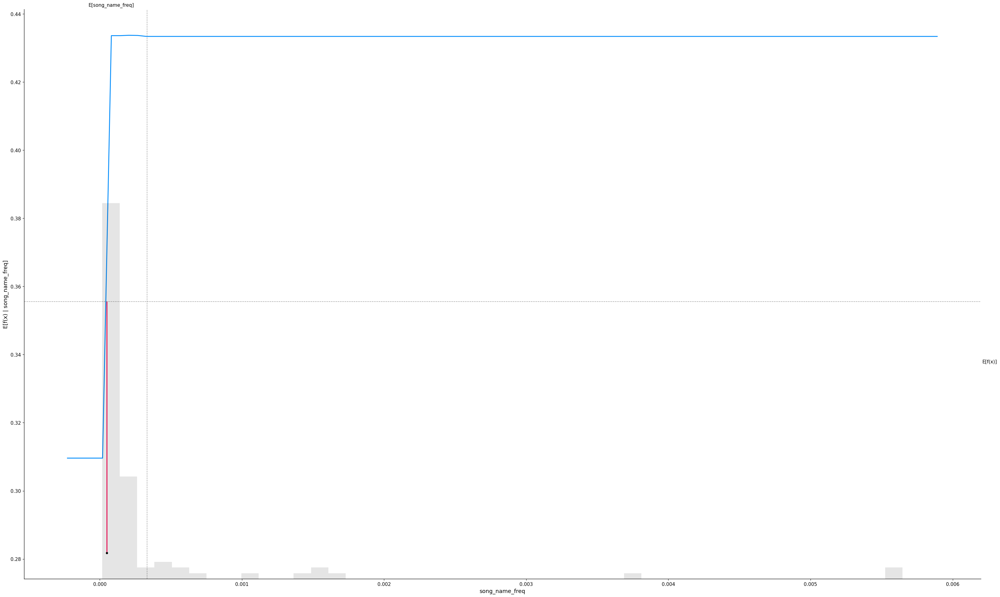

In [ ]:
tree_explainer = shap.Explainer(tree_model.predict, x_train_100)
tree_shap_values = tree_explainer(x_train)
for i in x_train.columns:
    # make a standard partial dependence plot
    sample_ind = 18
    shap.partial_dependence_plot(
        i,
        tree_model.predict,
        x_train_100,
        model_expected_value=True,
        feature_expected_value=True,
        ice=False,
        shap_values=tree_shap_values[sample_ind : sample_ind + 1, :],
    )

### **SHAP Analysis for Linear and Tree-Based Models**

 Here the x-axis is the feature and the y-axis is the output as we vary the feature. The grey histogram is the distribution of variables in the dataset and the cross made by E[Feature], E[f(x)] is the expected values.

Let us take a feature of Danceability

For the linear model the cross is made at approx E[f(x)] 0.37

For Tree-based model the cross is made at approx E[f(x)] 0.355

So as the Danceability increases the expected value also increases

Talking about the red line on the plot - When we give a sample as an input (sample_ind = 18) as an input to check the output. By plotting this we can see the difference between the model output from the expected value.

PermutationExplainer explainer: 16000it [13:33, 19.41it/s]                           


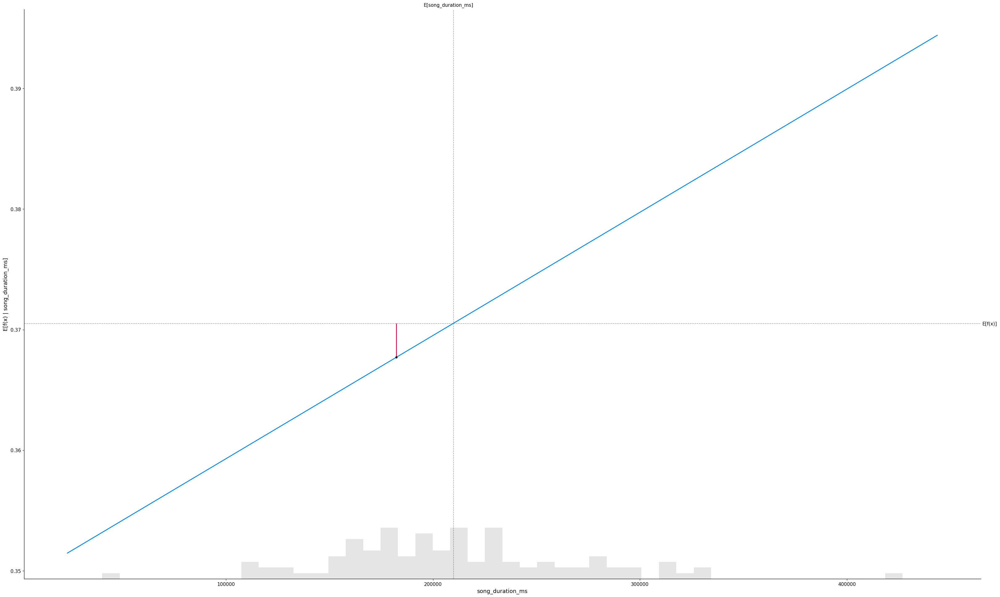

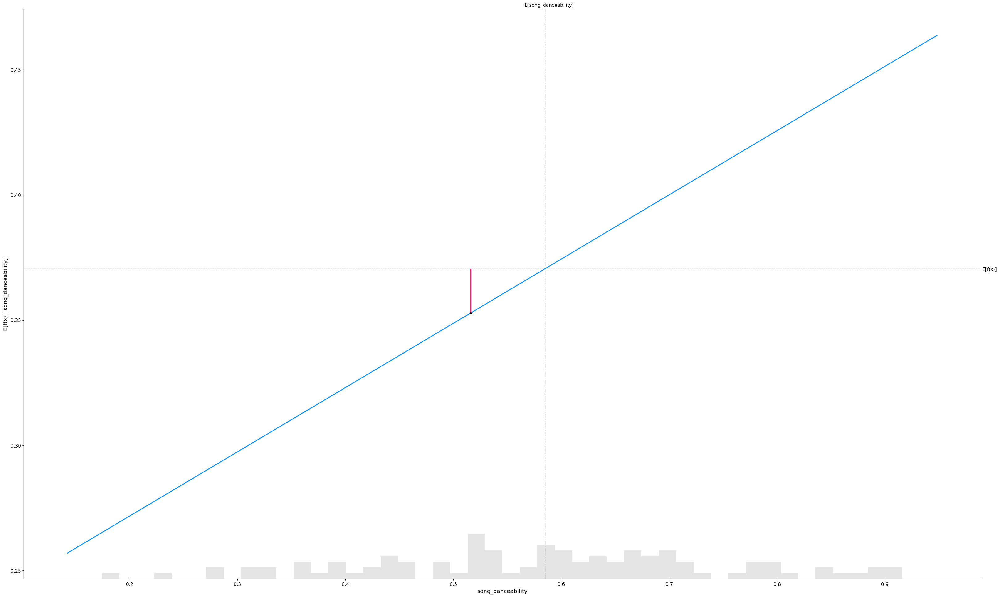

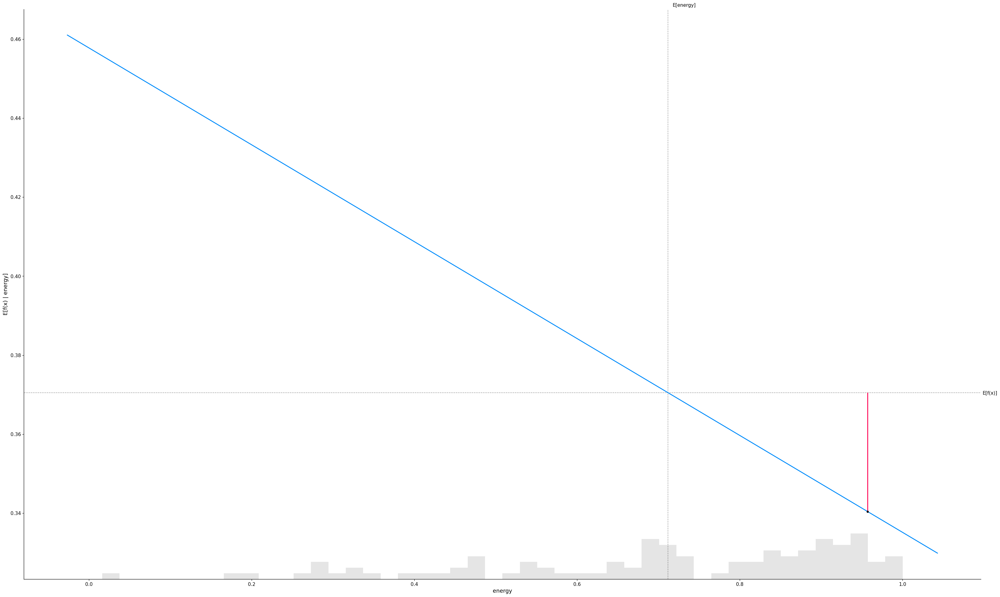

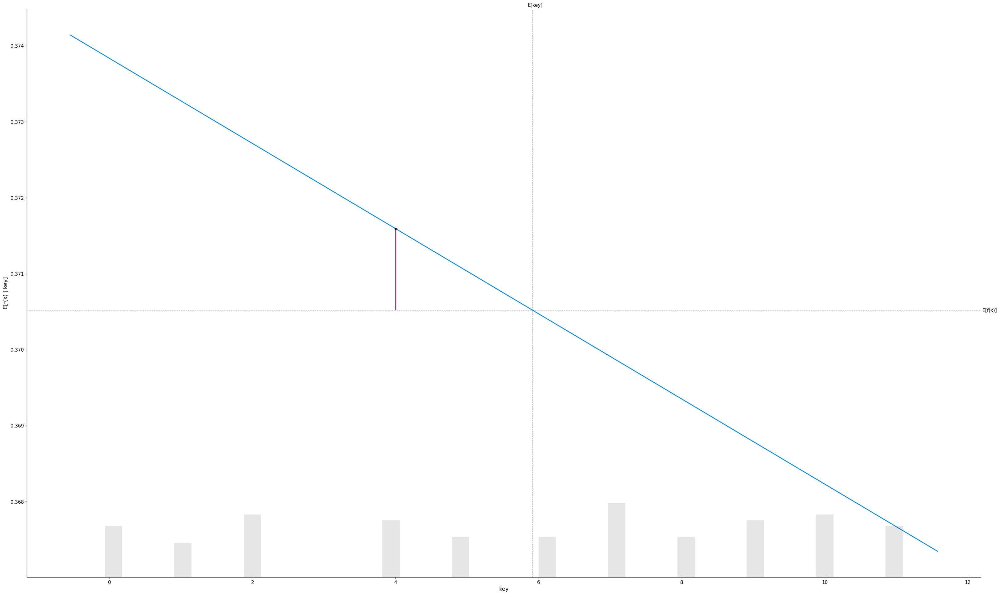

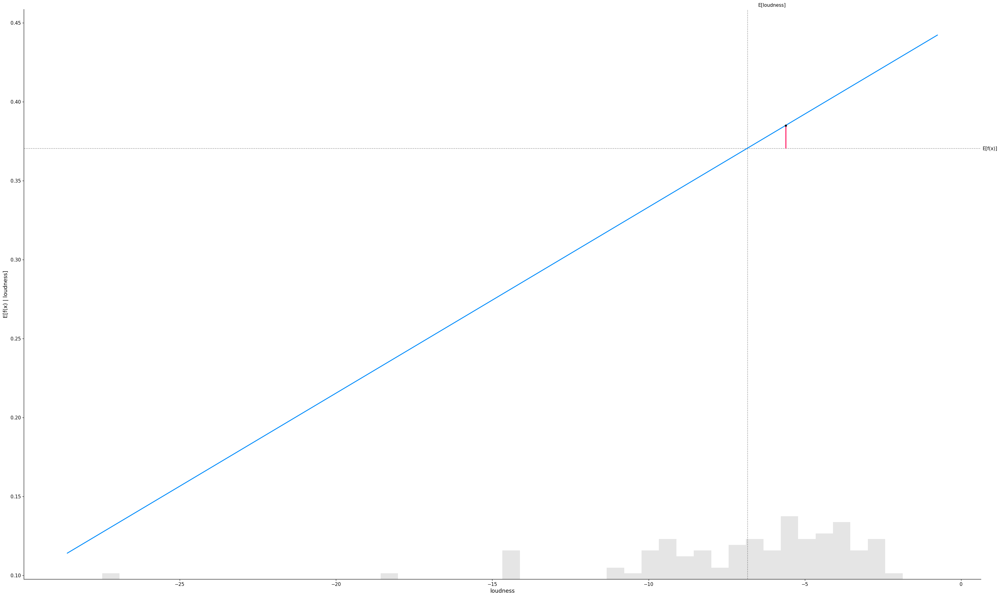

...

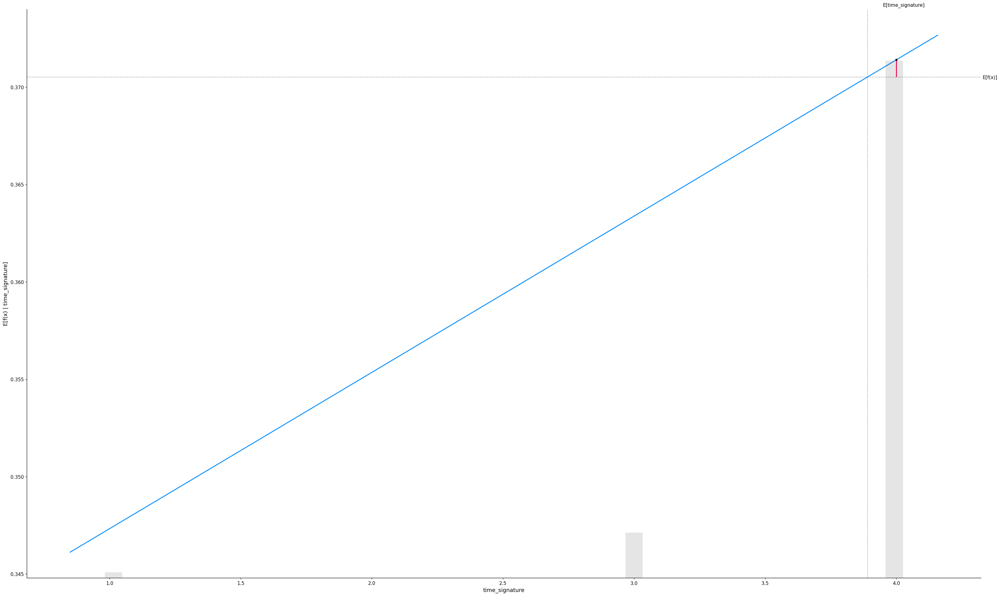

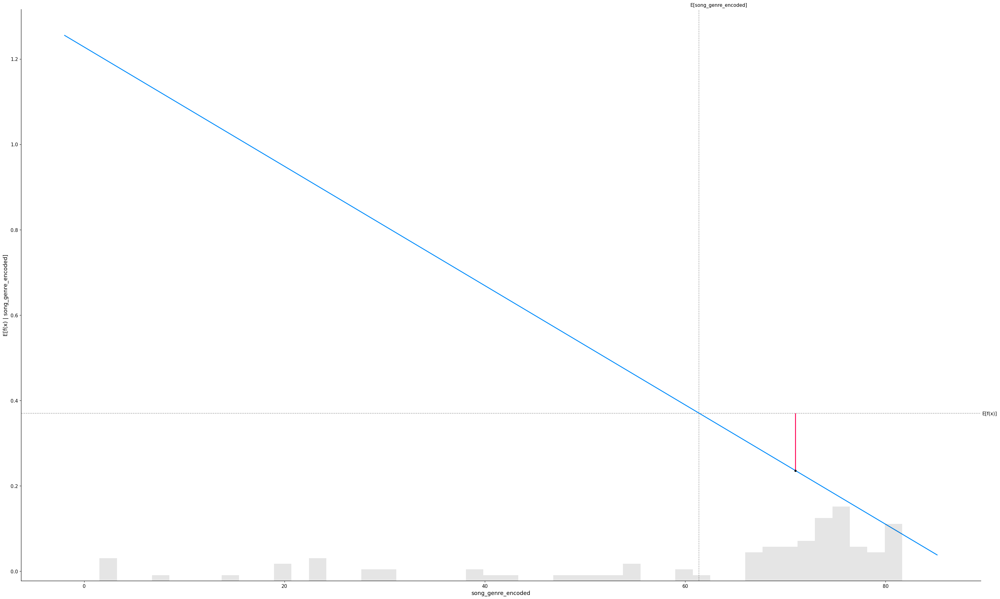

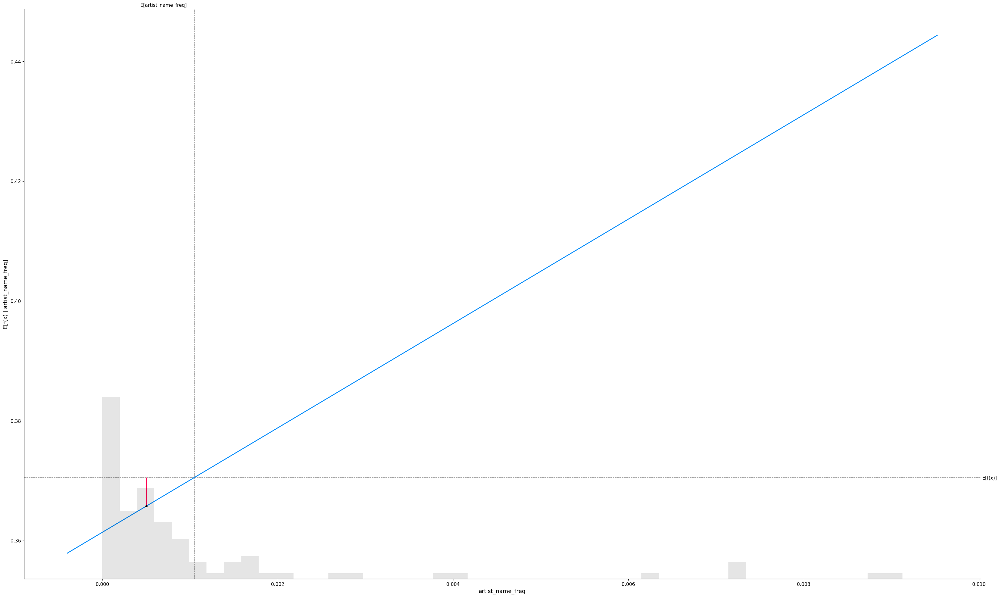

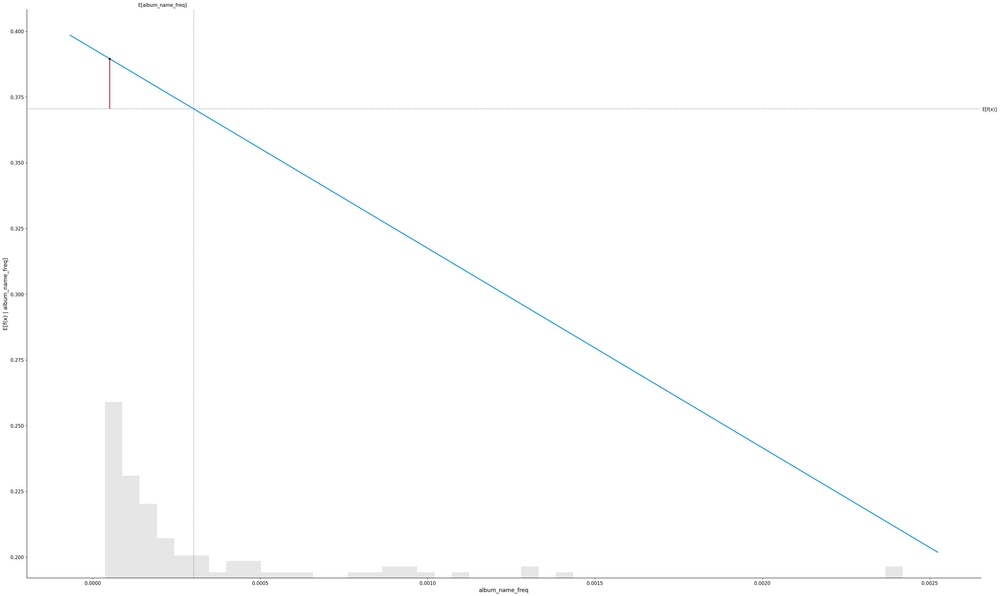

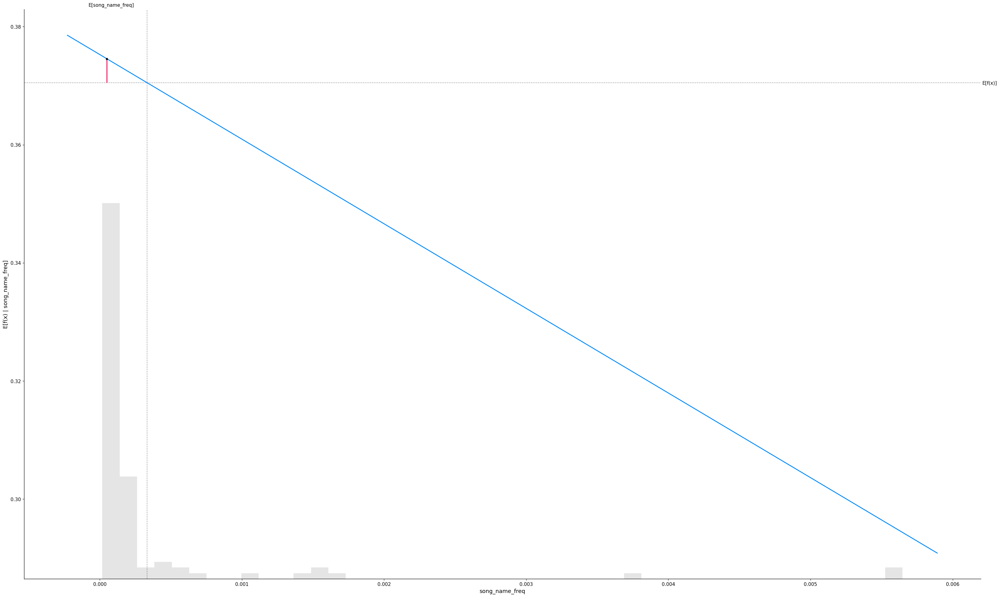

In [ ]:
linear_explainer = shap.Explainer(linear_model.predict, x_train_100)
linear_shap_values = linear_explainer(x_train)
for i in x_train.columns:
    # make a standard partial dependence plot
    sample_ind = 18
    shap.partial_dependence_plot(
        i,
        linear_model.predict,
        x_train_100,
        model_expected_value=True,
        feature_expected_value=True,
        ice=False,
        shap_values=linear_shap_values[sample_ind : sample_ind + 1, :],
    )

### **Interpreting SHAP Feature Importance Plot for Linear and Tree-based model**
The concept behind SHAP feature importance is straightforward: it measures the importance of each feature in a model by looking at the magnitude of their corresponding Shapley values. To obtain a global measure of feature importance, the absolute Shapley values are averaged across all data points. The resulting values are then sorted in descending order and plotted to display the relative importance of each feature.

The SHAP feature importance plots for a linear model and a tree-based model demonstrate that there are differences in the feature importance rankings between the two types of models. This suggests that the relative importance of different features may vary depending on the modeling approach used, and that SHAP analysis can provide valuable insights into the factors driving model predictions.

For the linear model, Energy is the most important feature but for our tree-based model Instrumentalness is the most important feature when we consider the average of SHAP values to calculate feature importance.

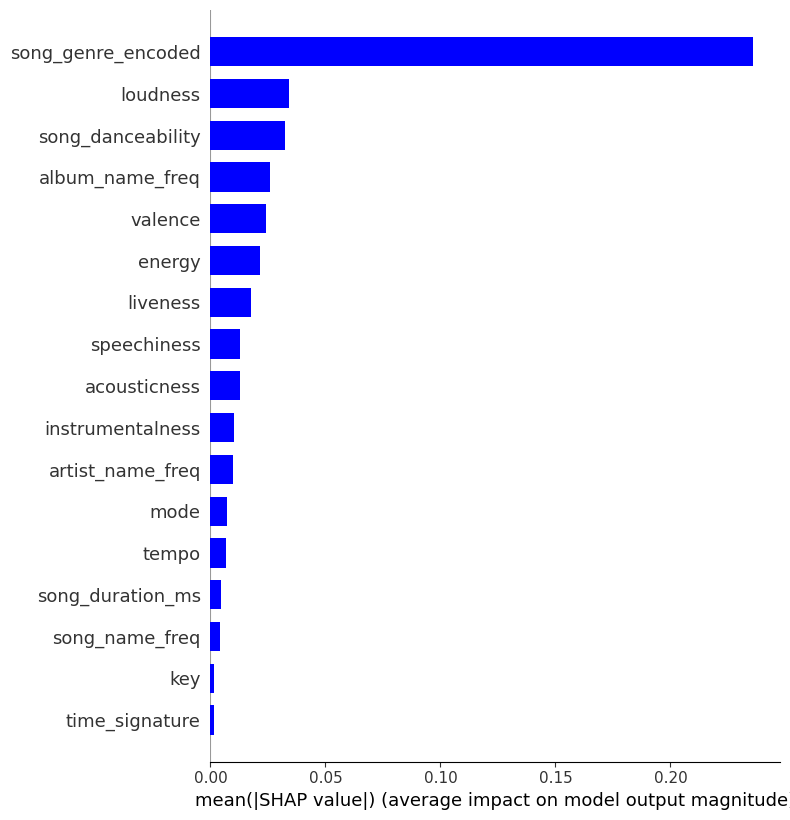

In [ ]:
shap.summary_plot(linear_shap_values, x_train, plot_type="bar", color="blue")

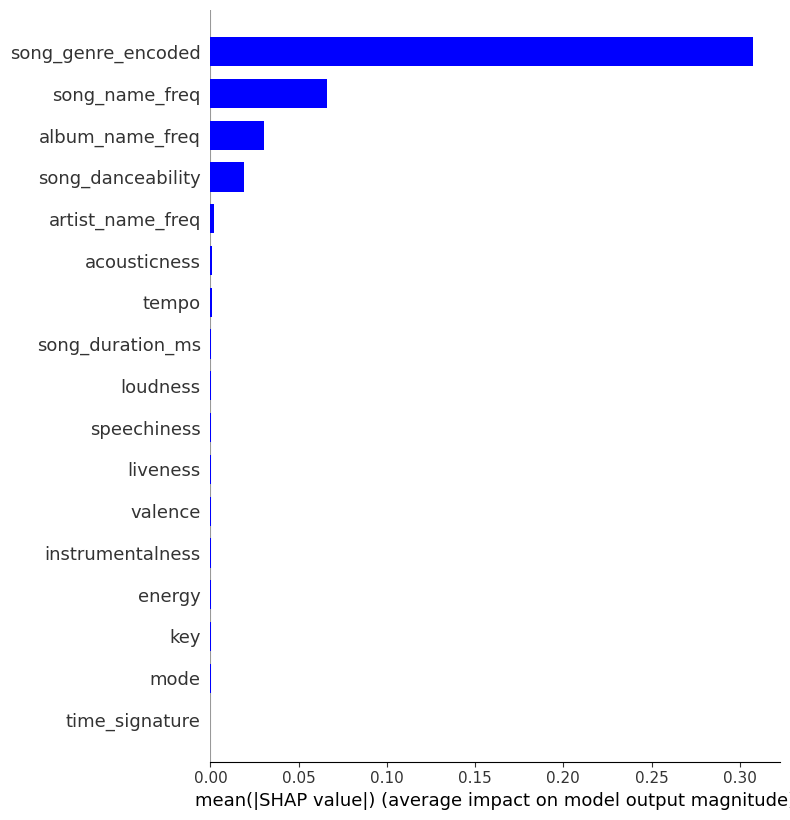

In [ ]:
shap.summary_plot(tree_shap_values, x_train, plot_type="bar", color="blue")

### **Interpreting Waterfall SHAP visualization**

Take the same sample (sample ind = 18) into consideration. Take note that the value of Danceability in the waterfall model matches the partial dependence plot for SHAP. It states that the model output was f(x) = 0.304 whereas the predicted result for this sample was f(x) = 0.535. Although the difference is only 0.2, we were really close to figuring it out. The waterfall model describes how we arrived at the desired result and what contributions certain components made. According to the graph below, Danceability had the strongest and most significant influence on this sample's Value of Popularity, which rose by 0.07 points. Following audio valeane had an effect and raised the value of popularity for this sample by 0.05.

With the same data, we may similarly understand the tree-based model. Although the predicted value was 0.296, the output we received was 0.406. The only difference between the tree-based model and the linear model is the size of the influence that each attribute has. Here, Danceability, Audio valeance, and loudness play a significant role in determining the output of the tree-based model, whereas in the linear model, Danceability, Audio valeance, energy, and acousticness had the greatest influence

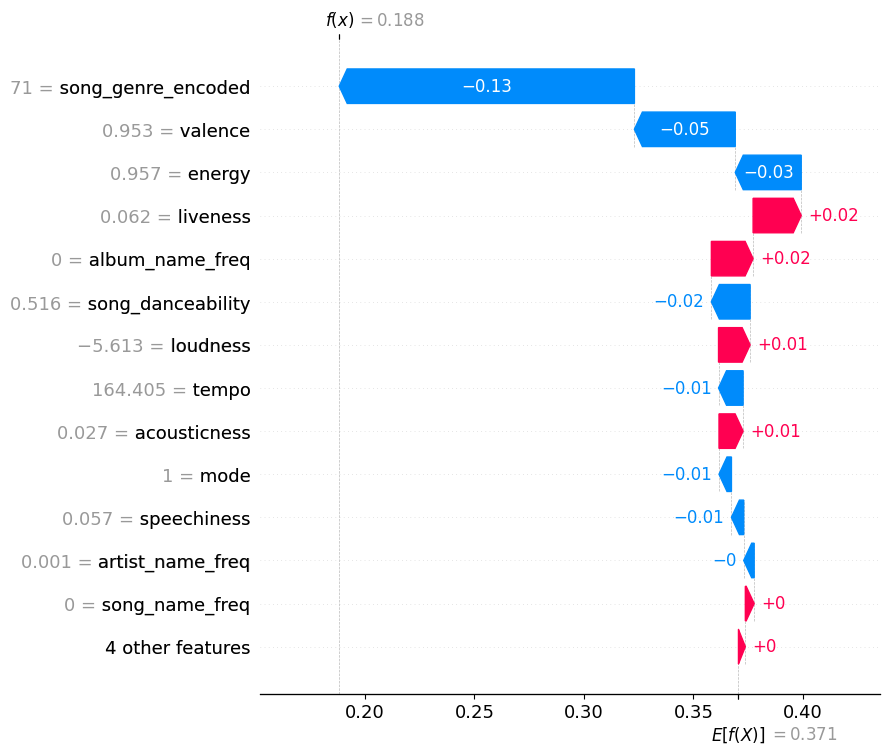

In [ ]:
shap.plots.waterfall(linear_shap_values[sample_ind], max_display=14)


The image you've shared appears to be a SHAP summary plot for an individual prediction from a machine learning model. Here’s the inference based on a typical SHAP summary plot:

**Base Value (E[f(X)])**: The base value, shown on the right as 0.371, represents the average model output over the training dataset passed to the SHAP explainer. This can be interpreted as the starting point for predictions before individual feature effects are considered.

**Output Value (f(X))**: The output value of 0.188 on the left side is the actual prediction for the individual instance being explained by this SHAP plot.

**Feature Contributions**: Each feature contributes either positively or negatively towards moving the prediction from the base value to the output value. The plot shows these contributions for each feature for the specific instance:

**Red Bars (Negative Impact)**: Features that push the prediction lower than the base value. For instance, song_genre_encoded with a value of 71 has a significant negative impact on the prediction, decreasing it by 0.13 from the base value.

**Blue Bars (Positive Impact)**: Features that push the prediction higher than the base value. For example, speechiness with a value of 0.057 increases the prediction slightly.

**Feature Values**: The value of each feature for this particular instance is given on the left. For example, song_genre_encoded = 71 means that for this particular song, the genre encoded as 71 is significantly decreasing its predicted popularity.

**Overall Interpretation**:  For this specific prediction, the model seems to suggest that the song's genre significantly decreases its popularity. Other attributes such as valence and energy also decrease the popularity score, whereas danceability slightly increases it.

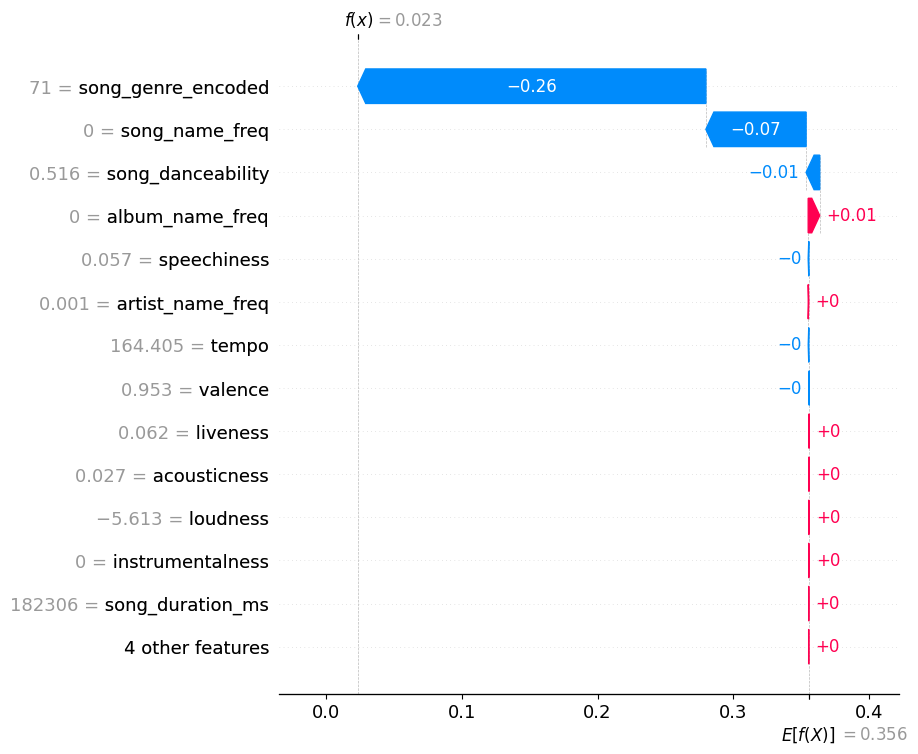

In [ ]:
shap.plots.waterfall(tree_shap_values[sample_ind], max_display=14)


The image you've provided appears to be a SHAP value water-fall plot for a single prediction from a machine learning model. Based on the elements typically found in such a plot, here’s an inference:

**Base Value (E[f(X)])**: The base value, indicated on the right as 0.356, is the average prediction for your model over the training dataset. This is the starting point for the SHAP value explanation for a particular instance.

**Output Value (f(X))**: The output value shown on the left as 0.023 is the actual prediction for the instance being explained by the SHAP values.

**Feature Contributions**: Each bar represents a feature's contribution to moving the prediction from the base value to the output value. The length of the bar indicates the magnitude of the feature's impact, and the direction (left for decreasing, right for increasing) indicates whether the impact is positive or negative with respect to the base value.

**Negative Impact (Blue Bars)**: Features that decrease the prediction. The song_genre_encoded has the largest negative impact, decreasing the predicted value by approximately 0.26.

**Positive Impact (Red Bars)**: Features that increase the prediction. In this case, some features slightly increase the predicted value, but none have a substantial positive impact as large as the impacts from song_genre_encoded.

**Feature Values**: The actual value of each feature for this instance is shown on the left. For instance, song_genre_encoded = 71 is significantly decreasing the predicted value.

**Overall Interpretation**: For this specific instance, the model predicted a value of 0.023, which is considerably lower than the average model prediction of 0.356. The song_genre_encoded with a value of 71 is the primary driver reducing the prediction. Other features seem to have very minimal to no impact (as their contribution bars are quite short).



### **Interpret the summary plot for the Linear and Tree-based model**
Here the features are listed in descending order of their importance. This is one of the easiest ways to analyze an ML model and how the features are affecting the target and to what extent.

This visual representation shows the impact of different aspects of a song, with red dots representing higher values and blue dots representing lower values. The position of each dot on the x-axis indicates the intensity of its impact, with dots further from the y-axis having a greater impact. Positive impacts are shown on the right side of the y-axis, while negative impacts are on the left.ce.

The graph suggests that higher danceability and loudness values are correlated with greater popularity, while shorter song duration and lower time signature values are also associated with higher popularity. The intensity of each impact can be interpreted by the distance of the dot from the y-axis.

This visualization is very useful when it comes to interpreting how our model is working.

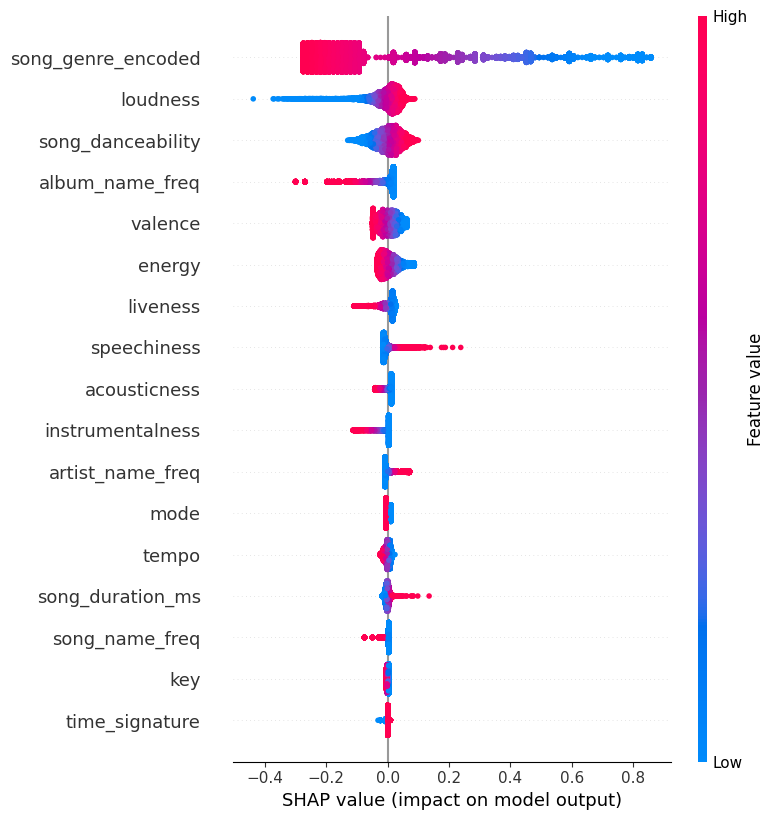

In [ ]:
shap.summary_plot(linear_shap_values, x_train)

### **Interpreting SHAP dependence plot for Linear and Tree-based model**
The SHAP dependency plot displays the little impact one or two characteristics have on a machine learning model's anticipated result. It indicates if there is a linear, monotonic, or complicated connection between the target and a feature. Let's analyze the SHAP dependency graphic to comprehend the linear and tree-based models. Each song in our dataset is represented by a dot in this set of graphs.

As can be seen, there is a linear relationship between the linear model feature and its SHAP value. The link between a feature and the song's popularity will be directly proportional, as in the case of loudness and danceability, and inverse if the feature has a negative influence on popularity.

The link between a feature's SHAP value and its tree-based model is no longer linear. Now that they are taking the interaction effects into account, we can observe that the SHAP dependence plot no longer perfectly matches the partial dependence plot. We lose all the high order interactions (ands and ors) in the model that our model may be doing if we look at the PDP. The SHAP defensive scheme, however, considers these interactions, in contrast to PDP.

Example of SHAP dependence plot of Accousticness

In the linear model the relationship is linear between Accousticness and its SHAP values. There is not much information to extract from these plots the only information which could be extracted is if the relationship is directly or inversely proportional. In the tree-based model we could extract the information on how popularity of song is affected while being tuned the feature. It also reinforces the inference we got from the above PDP and ICE plot

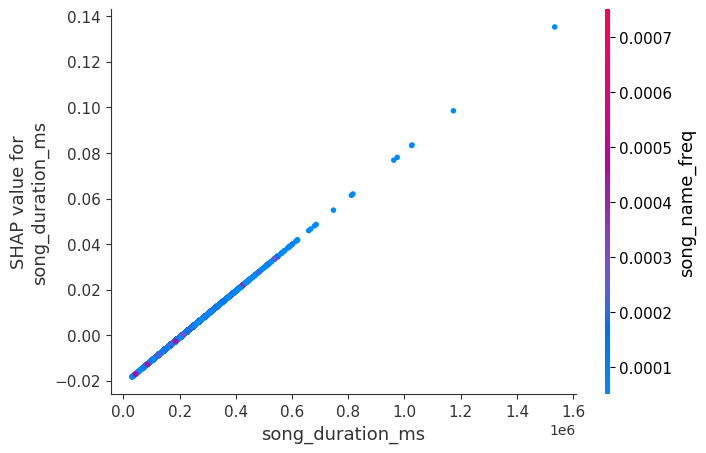

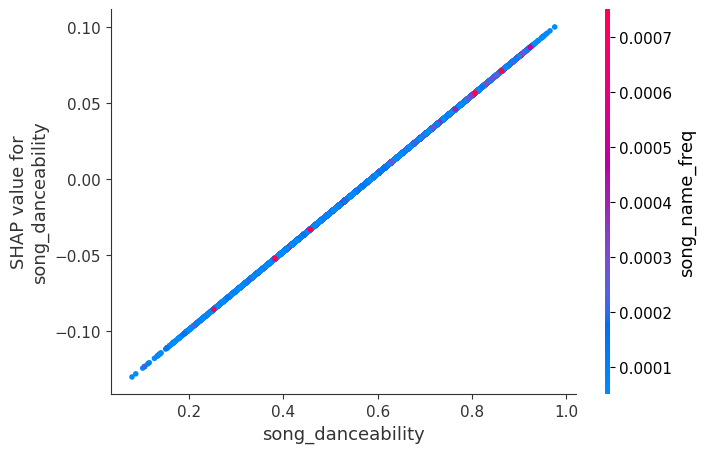

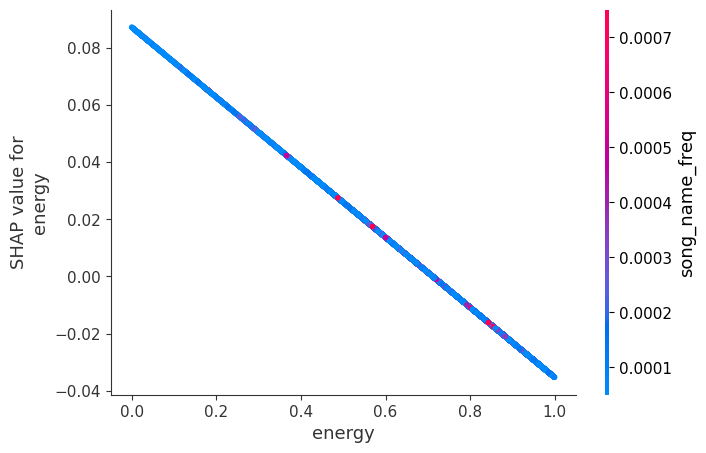

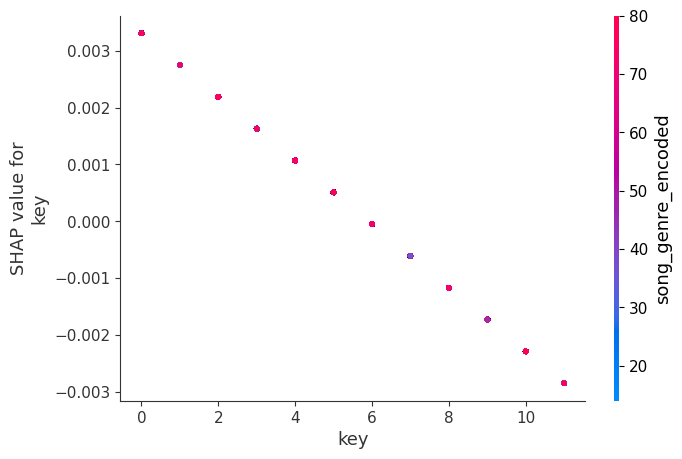

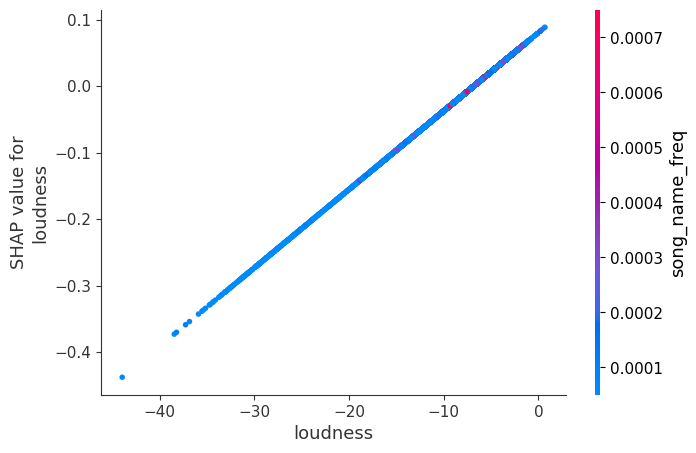

...

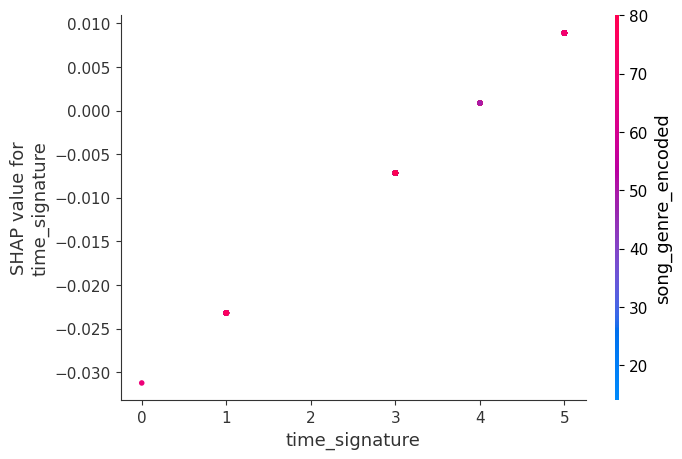

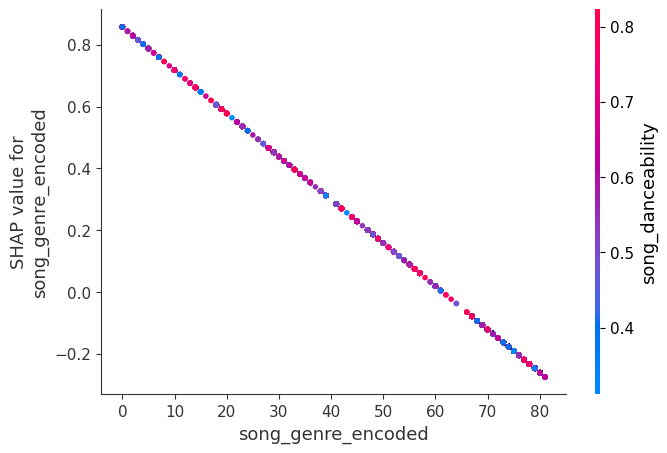

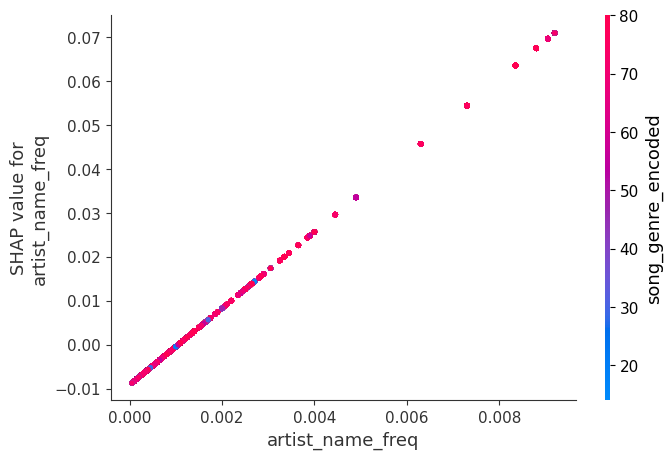

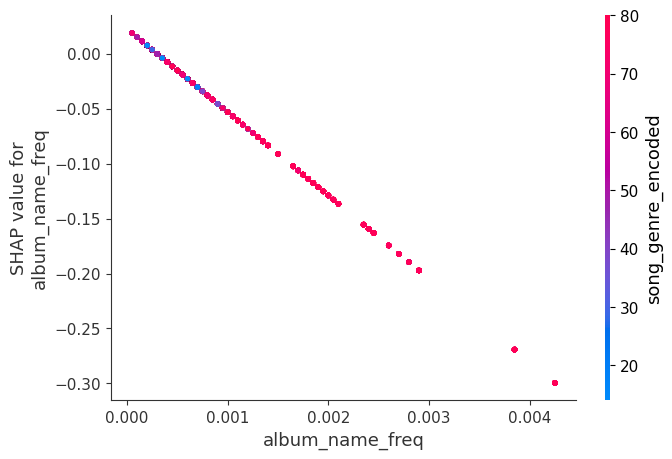

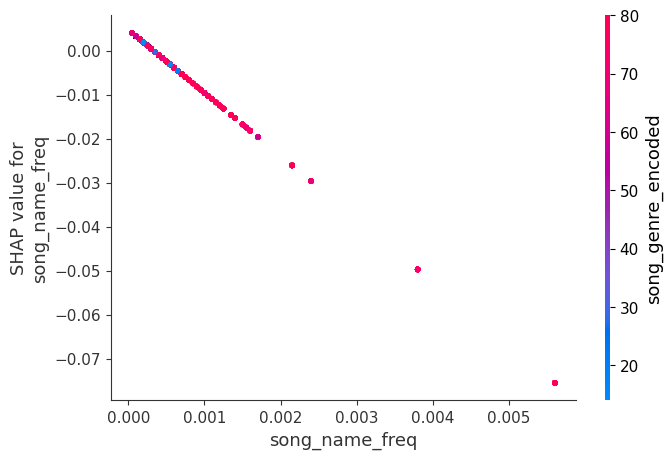

In [ ]:
for i in x_train.columns:
    shap.dependence_plot(i, linear_shap_values.values, x_train)

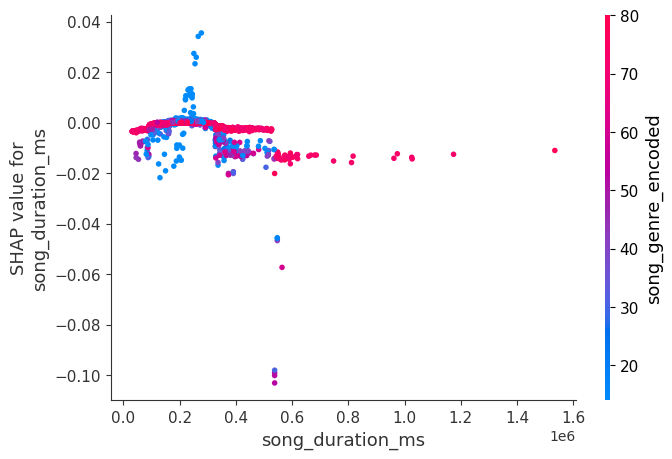

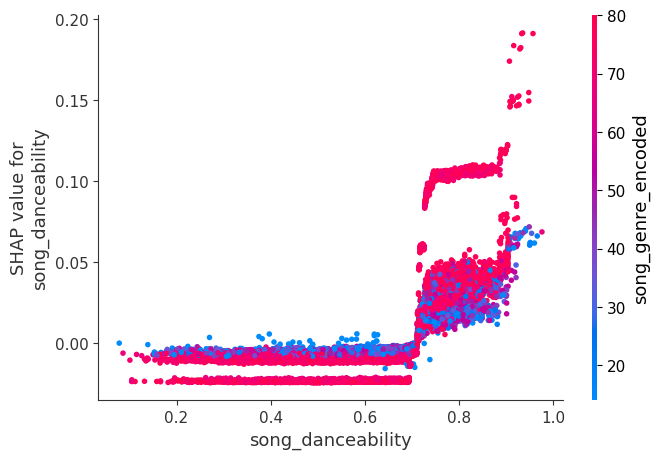

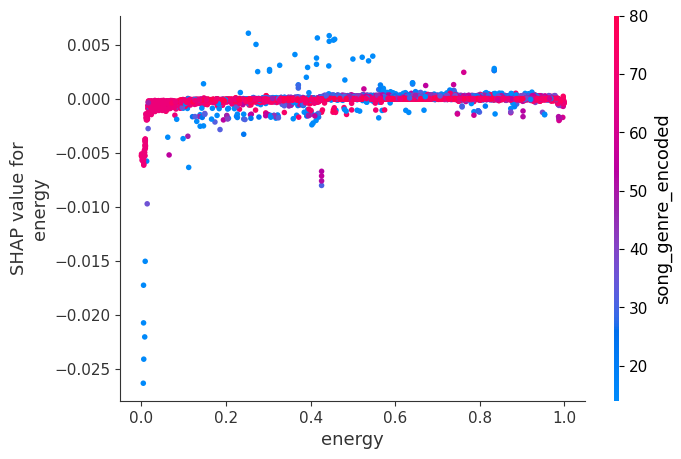

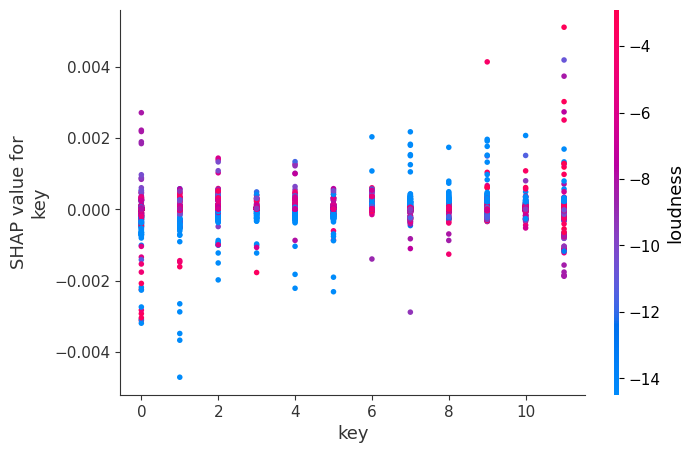

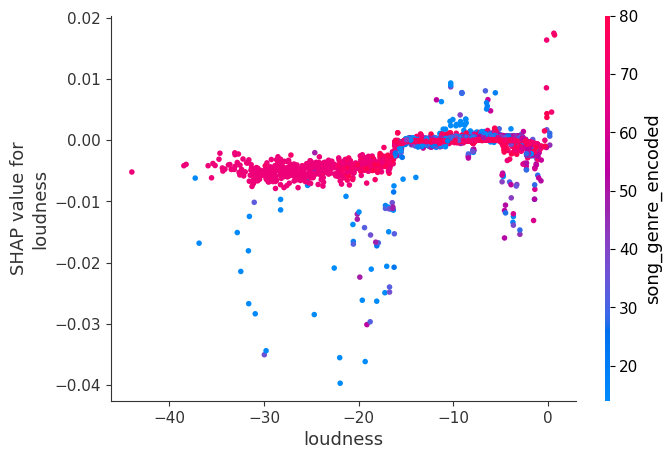

...

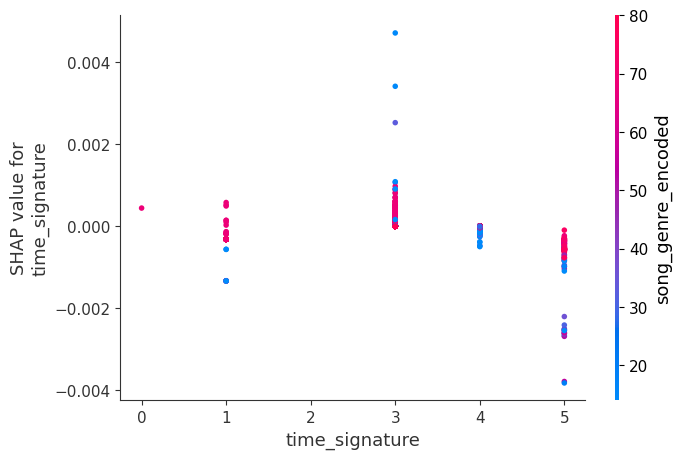

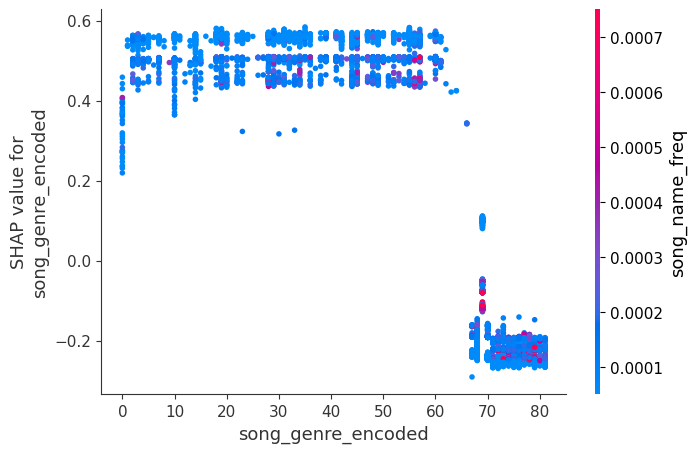

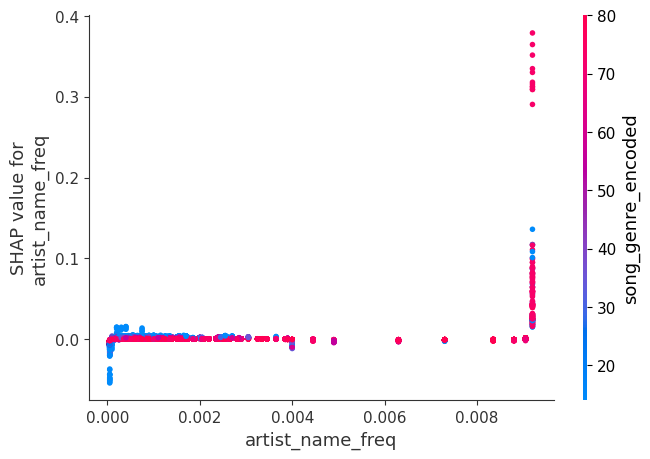

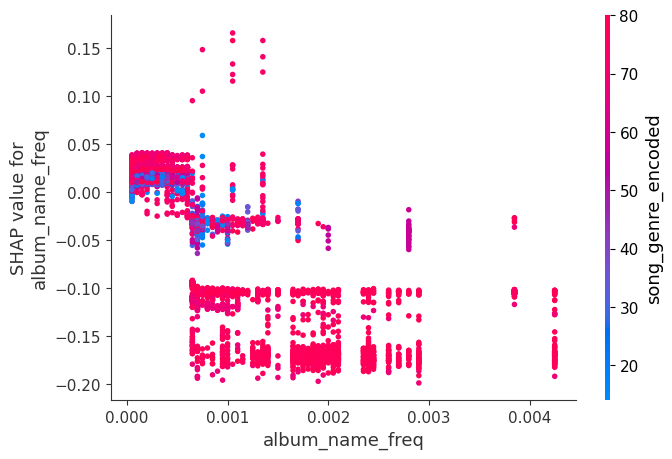

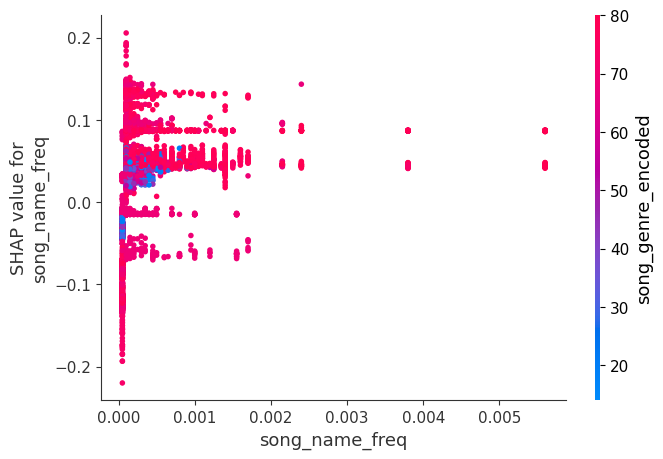

In [ ]:
for i in x_train.columns:
    shap.dependence_plot(i, tree_shap_values.values, x_train)

In [ ]:
X_output_linear = x_test.copy()
X_output_linear.loc[:, "predict"] = np.round(
    linear_model.predict(X_output_linear), 2
)  # Attaching the output of linear model to test dataframe

X_output_tree = x_test.copy()
X_output_tree.loc[:, "predict"] = np.round(
    tree_model.predict(X_output_tree), 2
)  # Attaching the output of tree based model to test dataframe

In [ ]:
# Force Plot of Tree Based Model
explainerModel = shap.TreeExplainer(tree_model)
shap_values_Model = explainerModel.shap_values(X_output_tree)


def shap_plot_tree(j):
    p = shap.force_plot(
        explainerModel.expected_value, shap_values_Model[j], X_output_tree.iloc[[j]]
    )
    return p

In [ ]:
shap.initjs()  # Initializing JavaScript module
print(shap_plot_tree(18))  # SHAP force plot for sample 18

### **LIME (Local Interpretation Model-Agnostic Explanation) Analysis**
LIME builds a surrogate model, i.e. converts a more complicated model (say a deep tree-based model into a simple linear model) around the data points in which we are interested and then it will try to make an approximation out of this simple model on the whole model. LIME builds a local model in such a way that it can interpret the whole Black-Box

LIME works well on tabular, text, image datasets - hence it works on different datasets

Let us Interpret our Linear model and Tree-based model on sample data (sample_index = 18) using LIME and try to understand what is happening under the hood. Please refer below for Visualizations of both models

As we can see on the left-hand side LIME gives us information about the minimum and maximum values predicted by the model. The Color orange here represents positive and blue represents negative Here for this sample as seen below instumentalness harmed both linear and tree-based model Loudness, Danceability, had a positive effect on the song popularity in both models Instrumentalness had a negative effect in the linear model but positive in tree-based model These interpretations were carried out locally in the region where of out sample data(sample_index = 18).

In [ ]:
# Initializing LIME explainer for Linear Model
lime_linear_explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(x_train), feature_names=x_train.columns, mode="regression"
)

In [ ]:
idx = 18
np_x_test = np.array(x_test)
np_y_test = np.array(y_test)
print("Prediction : ", linear_model.predict(np_x_test[0].reshape(1, -1)))
print("Actual :     ", np_y_test[idx])

lime_linear_explanation = lime_linear_explainer.explain_instance(
    np_x_test[idx], linear_model.predict, num_features=np_x_test.shape[1]
)
lime_linear_explanation

Prediction :  [0.28473342]
Actual :      1


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [ ]:
lime_linear_explanation.show_in_notebook()  # Display Results in Notebook

### **Tree Based Model**

In [ ]:
# Initializing LIME explainer for Tree Based Model
lime_tree_explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(x_train), feature_names=x_train.columns, mode="regression"
)

In [ ]:
idx = 18
np_x_test = np.array(x_test)
np_y_test = np.array(y_test)
print("Prediction : ", tree_model.predict(np_x_test[0].reshape(1, -1)))
print("Actual :     ", np_y_test[idx])

lime_tree_explanation = lime_linear_explainer.explain_instance(
    np_x_test[idx], tree_model.predict, num_features=np_x_test.shape[1]
)
lime_tree_explanation

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


Prediction :  [0.02381269]
Actual :      1


In [ ]:
lime_tree_explanation.show_in_notebook()  # Display Results in Notebook

In [ ]:
from sklearn.inspection import PartialDependenceDisplay
from sklearn.inspection import partial_dependence

### **PDP(Partial Dependence Plot) for Linear model and Tree-based Model**
Linear Model - If we closely look at the PDP of the linear model we can see that if features Accousticness, Loudness, energy, instrumentalness, danceability and audio valeanceare tuned while freezing the rest if them the output of the model varies linearly and these variables have the most significant effect on the output
Tree-Based Model - On looking at the PDP of the tree-based model, it dosent affirms the interpretation we got from the PDP of the Linear Model and Best AutoML model.

Each plot on the image shows a different feature on the x-axis and the partial dependence on the y-axis. In other words, they depict how the expected model prediction changes when the feature's value varies, holding other features constant.

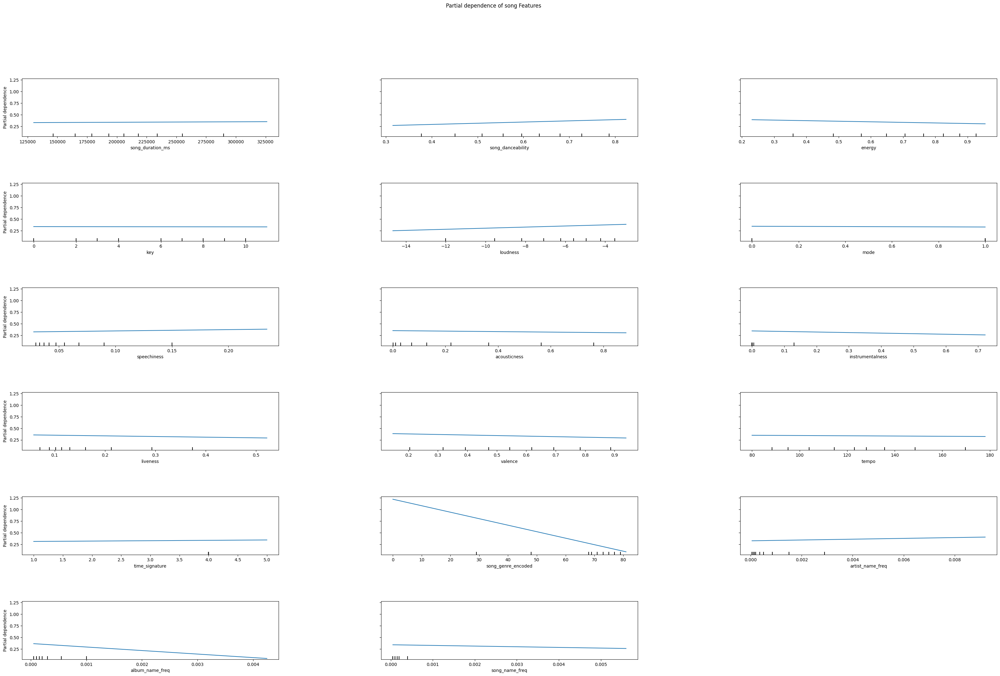

In [ ]:
# PDP Plot for Linear Model

PartialDependenceDisplay.from_estimator(linear_model, x_test, x_test.columns)
fig = plt.gcf()
fig.suptitle("Partial dependence of song Features")
fig.subplots_adjust(wspace=0.4, hspace=0.8)
plt.show()
plt.rcParams["figure.figsize"] = (32, 24)

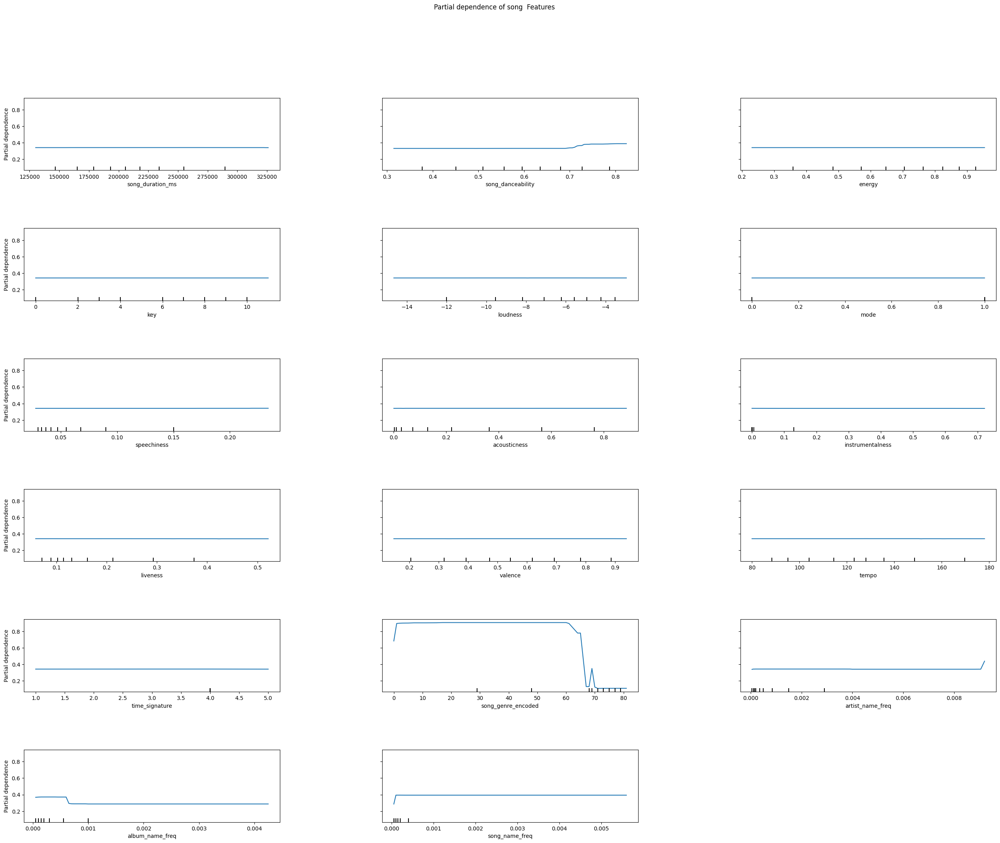

In [ ]:
PartialDependenceDisplay.from_estimator(tree_model, x_test, x_test.columns)


fig = plt.gcf()
fig.suptitle("Partial dependence of song  Features")
fig.subplots_adjust(wspace=0.4, hspace=0.8)
plt.show()
plt.rcParams["figure.figsize"] = (32, 24)

### **Comparision between SHAP, LIME, and Partial Dependence Plot Analysis**
Comparison of the partial dependence plot analysis (PDPA), SHAP, and LIME The black-box model is used by SHAP instead of LIME to determine each feature's marginal contribution to the prediction. Shapley values, a theoretically sound idea from game theory, are then used to determine the relevance of each feature. Because of its superior stability and lack of local linear model assumptions, SHAP outperforms LIME in this way.

By freezing the other variables, PDP reveals how much of an impact a particular variable has on the outcome.
Each variable's contribution to the prediction is shown by SHAP.
LIME is more like SHAP but a lighter version of it. It uses the point of interest's immediate area to provide
We have to analyze our needs and then consider the tradeoff to select the best suitable interpretable method for the ML model

### **SHAP Analysis in H20 Model**

In [ ]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score

# Initialize the XGBoost classifier
xgb_model = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='mlogloss')

# Train the model
xgb_model.fit(x_train, y_train)

# Predict on the test set
y_pred = xgb_model.predict(x_test)

# Calculate the accuracy
accuracy = accuracy_score(y_test, y_pred)
accuracy

0.93525

The spread of the points for each feature shows the variability of the impact on the model output. A wide spread indicates that a feature can have a wide range of effects depending on the value it takes for a given instance, while a narrow spread indicates that the impact is more consistent.

 97%|=================== | 3869/4000 [00:26<00:00]       

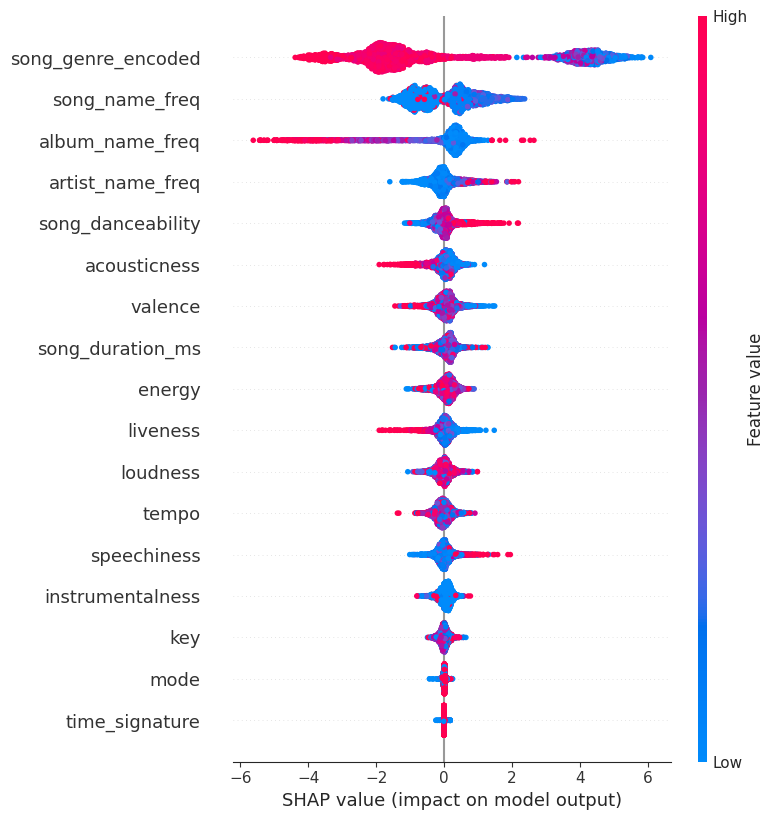

In [ ]:
import shap

# 1. Initialize the SHAP explainer with the XGBoost model
explainer = shap.Explainer(xgb_model, x_train)

# 2. Compute SHAP values for the test set
shap_values = explainer.shap_values(x_test)

# 3. Summarize the SHAP values in a plot
shap.summary_plot(shap_values, x_test, feature_names=x_test.columns)


 SHAP values explain the impact of having a certain value for a given feature in comparison to the prediction we'd make if that feature took some baseline value.

Each point on the summary plot corresponds to a SHAP value for a feature and an instance. The position on the x-axis indicates the impact of the feature on the model's output. For example, a SHAP value of -2 for a particular feature would indicate that this feature pushes the model's prediction 2 units lower for that specific instance.

The color represents the value of the feature from low to high (blue to red). For example, red points far to the right indicate high feature values that increase the prediction, while blue points far to the left indicate low feature values that decrease the prediction.


Based on the plot, we can infer the following:

**Song Genre Encoded**: Appears to have a wide distribution of SHAP values, suggesting that for some songs, genre has a strong positive or negative effect on the model output, depending on the genre.

**Frequency Features (song_name_freq, album_name_freq, artist_name_freq)** : The frequency of the song name, album name, and artist name in the dataset seems to also significantly impact the model. For instance, if an artist name is common (indicated by red), it could have a strong positive or negative influence on the model's prediction.

**Danceability, Acousticness, Valence:** These features show clusters of high SHAP values indicating a strong positive effect on the model's output when they have high values.

**Song Duration, Energy, Liveness, Loudness, Tempo:** These features exhibit both positive and negative effects on the model's output. For example, longer song duration may have a negative impact on the predicted outcome (more left-leaning red dots).

**Speechiness, Instrumentalness:** These features seem to have less impact compared to others, as their SHAP values are closer to zero.

**Key, Mode, Time Signature:** They appear to have the least impact on the model's output as their SHAP values are concentrated around zero.

In [ ]:
import h2o
from h2o.estimators import H2OXGBoostEstimator

# Initialize the H2O cluster
h2o.init()

# Convert the pandas DataFrame to H2OFrame
h2o_df = h2o.H2OFrame(spotify)

# Specify the features and target
features = h2o_df.columns[:-1]
target = 'popularity'

# Split the data into training and testing sets
train, test = h2o_df.split_frame(ratios=[0.8])

# Initialize and train the H2O XGBoost model
xgb_model = H2OXGBoostEstimator()
xgb_model.train(x=features, y=target, training_frame=train)


shap_values = explainer.shap_values(x_test)

Checking whether there is an H2O instance running at http://localhost:54321. connected.


H2O_cluster_uptime:,6 mins 55 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,20 days
H2O_cluster_name:,H2O_from_python_unknownUser_hk5eqj
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.168 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
xgboost Model Build progress: |

/usr/local/lib/python3.10/dist-packages/h2o/estimators/estimator_base.py:192: RuntimeWarning: We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.
  warnings.warn(mesg["message"], RuntimeWarning)


██████████████████████████████████████████████████| (done) 100%


100%|===================| 3988/4000 [00:23<00:00]       

# **What is the question?**


The task involves conducting a thorough data analysis of the Spotify popularity prediction dataset. This encompasses classifying data types, pinpointing absent values, assessing the spread of numerical variables, and choosing independent variables that effectively predict the target variable. It also includes ascertaining the significance of predictor variables, decoding regression coefficients, analyzing the decision nodes within a tree-based model, leveraging AutoML to discover the optimal model, and using SHAP analysis to interpret the predictive models.

# **What did you do?**

I undertook the following steps in analyzing the Spotify popularity prediction dataset:

*   Carried out the necessary data cleansing and selected features critical for the analysis.

*   Categorized the types of data and identified any instances of missing information.

*   Assessed the probable distribution patterns of the numerical variables.

*   Employed a minimum of three distinct techniques to pinpoint independent variables crucial for forecasting the dependent variable.

*   Identified which independent variables lacked data and calculated the extent of these data gaps.

*   Ensured the training and test datasets were congruent and ascertained the independence of the predictor variables.

*   Established the relative significance of each predictor variable and verified the logical consistency of their value ranges.

*   Analyzed the distribution of the predictor variables and gauged the effect of excluding outliers.

*   Randomly discarded 1%, 5%, and 10% of the dataset and used three different imputation methods to evaluate the effectiveness of each in reconstructing missing values.

*   Utilized an AutoML platform such as H2O.ai for the generation and interpretation of predictive modeling.

*   Deciphered the meaning behind the regression coefficients in the linear model.

*   Interpreted the decision points within the tree-based model structure.

*   Applied SHAP values for a deeper understanding of the models, facilitating a comparative analysis with other interpretability methods in the models.

# **How well did it work?**

The analytical process applied to the Spotify popularity prediction dataset was insightful and informative. By undertaking data cleaning and feature selection, key data types were identified, alongside any missing values, and vital independent variables were recognized. An exploration of the distribution of numerical variables, coupled with a methodical selection of independent variables, deepened the understanding of the dataset.

The steps taken to handle missing data, to assess the independence of predictor variables, to gauge the significance of these predictors, and to consider the consequences of outlier removal all contributed to more calculated decision-making. Utilizing an AutoML platform such as H2O.ai for generating and interpreting predictive models offered valuable perspectives.

Lastly, a thorough examination of regression coefficients, tree model nodes, and SHAP analysis not only provided a clearer grasp of the models themselves but also offered a basis for comparison with other interpretability techniques.

# **What did you learn?**

Through this analysis, I gained the following insights:

The importance of data cleaning and feature selection cannot be overstated; they are foundational for enhancing data quality and pinpointing valuable variables.

Assessing the distribution of numerical variables and judiciously choosing independent variables with diverse methods are critical steps.

I've learned the processes for managing missing data, verifying the independence of predictor variables, ascertaining their significance, and understanding the ramifications of outlier removal.

Employing AutoML tools such as H2O.ai proves instrumental in developing and elucidating predictive models.

I've become adept at deciphering regression coefficients, tree-based model nodes, and SHAP values, which enriches my understanding of the models and provides a benchmark for comparing different interpretability strategies.







# **CONCLUSION**

*   The exploration of the Spotify popularity prediction dataset yielded valuable findings and insights.
*   Tasks such as data cleansing and selecting relevant features were instrumental in discerning data types, identifying missing entries, and pinpointing significant independent variables.
*   Assessing how numerical variables are distributed and employing various methods to choose independent variables deepened the comprehension of the dataset.
*   The scrutiny of missing data, affirmation of predictor variables' independence, appraisal of their significance, and consideration of the effects of outlier removal all contributed to more informed decision-making.
*   The utilization of AutoML tools like H2O.ai for the generation and interpretation of predictive models was enlightening. Furthermore, analyzing regression coefficients, tree model nodes, and SHAP values enhanced the understanding of the models and facilitated their comparison with alternative methods of interpretability.
*   In summary, this project offered an exhaustive insight into data analysis practices and their implementation in predictive modeling.



References:

https://scikit-learn.org/stable/

https://towardsdatascience.com/

https://www.kaggle.com/

https://www.kaggle.com/code/artgor/eda-and-models

https://eli5.readthedocs.io/en/latest/

https://github.com/aiskunks/YouTube/blob/main/A_Crash_Course_in_Statistical_Learning/Model_Interpretability/SHAP%20and%20LIME%20analysis%20Walkthrough.ipynb

https://realpython.com/linear-regression-in-python/

https://towardsdatascience.com/explain-your-model-with-the-shap-values-bc36aac4de3d

https://github.com/aiskunks/YouTube/blob/main/A_Crash_Course_in_Statistical_Learning/AutoML/CC_Kaggle_AutoML_Regression_Melbourne_Housing.ipynb